In [23]:
import os
from pathlib import Path
import IPython.display as ipd

import numpy as np
import pandas as pd
import librosa 

import joblib
from joblib import dump

import sklearn 
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
import sklearn.preprocessing as skp
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report

import matplotlib.pyplot as plt
import tensorflow as tf 
from tensorflow import keras
plt.style.use('default')

***Some important functions***

*Feature Importance Function : since it is a hard task to compute feature importance on neural networks, an alternative approach to that task is done using gradient-based methods or activation maximization. These methods focus on understanding the importance of input features based on how they influence the gradients or activations within the network.*

In [3]:
def feature_importance_gradient(model, input_data):
    
    input_tensor = tf.convert_to_tensor(input_data, dtype=tf.float32)
    
    with tf.GradientTape() as tape:
        tape.watch(input_tensor)
        predictions = model(input_tensor)  # Forward pass
        top_class = tf.argmax(predictions[0])
        top_output = predictions[:, top_class]
        
    gradients = tape.gradient(top_output, input_tensor)
    feature_importance = np.mean(np.abs(gradients), axis=0)
    
    return feature_importance


**EDA: exploratory data analysis**

In [5]:
def audio_show(audio_file, genre):

    # Load the audio file
    data, sample_rate = librosa.load(audio_file)

    # Display audio player
    ipd.display(ipd.Audio(audio_file, rate=sample_rate)) 

    # Create a figure with custom size
    fig, axs = plt.subplots(1, 2, figsize=(12, 5), gridspec_kw={'width_ratios': [1, 1]})
    
    # Plot the waveform
    axs[0].plot(data, color="#2B4F72", alpha=0.4)
    axs[0].set_title(f'Waveplot for a {genre} piece')
    axs[0].set_xlabel('Time')
    axs[0].set_ylabel('Amplitude')

    # Create and plot log mel spectrogram with a rectangular aspect ratio
    spectrogram = librosa.feature.melspectrogram(y=data, sr=sample_rate, n_mels=128, fmax=8000) 
    spectrogram = librosa.power_to_db(spectrogram)
    img = librosa.display.specshow(spectrogram, y_axis='mel', fmax=8000, x_axis='time', ax=axs[1], auto_aspect=2);
    axs[1].set_title(f'Mel Spectrogram for a {genre} piece')
    # Creating colorbar for the spectrogram
    cbar = plt.colorbar(img, ax=axs[1], format='%+2.0f dB')
    cbar.set_label('Intensity')

    plt.tight_layout()
    plt.show()




Genre Name: classical
there are 100 audio files available for this genre
Sample Audio File: classical.00060.wav


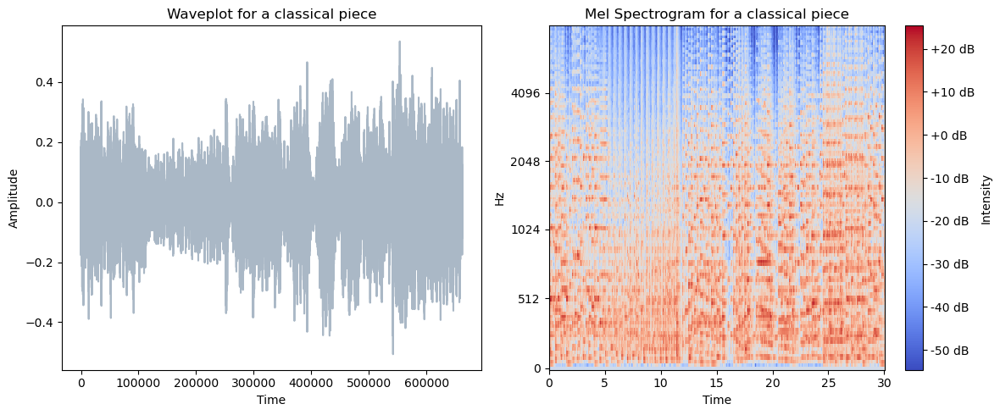


Genre Name: rock
there are 100 audio files available for this genre
Sample Audio File: rock.00073.wav


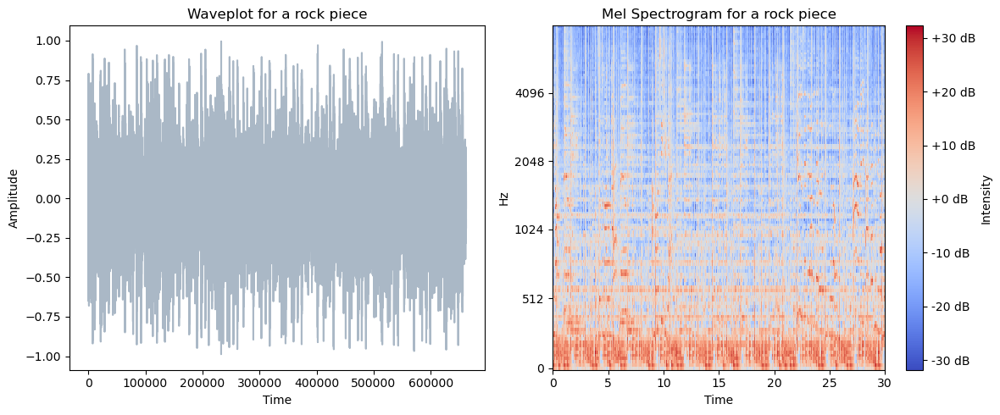


Genre Name: metal
there are 100 audio files available for this genre
Sample Audio File: metal.00083.wav


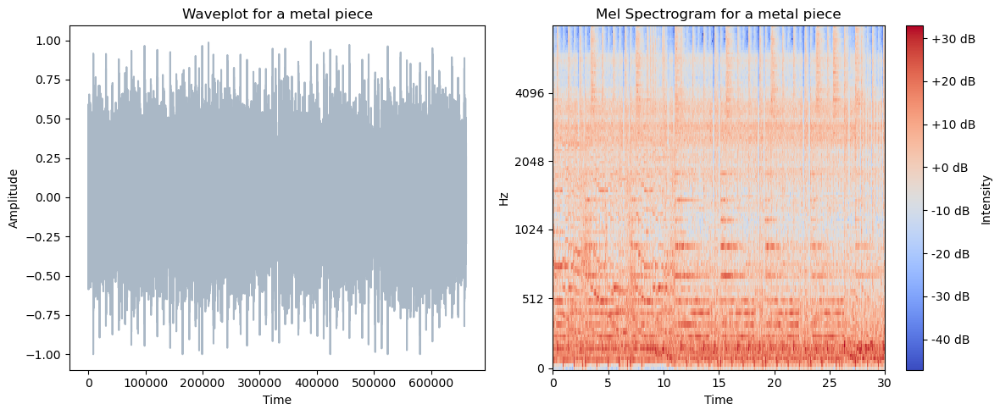


Genre Name: country
there are 100 audio files available for this genre
Sample Audio File: country.00096.wav


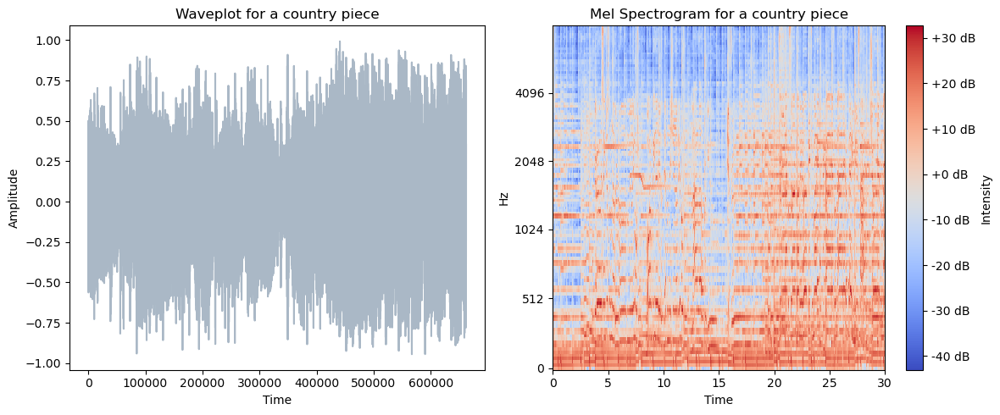


Genre Name: jazz
there are 100 audio files available for this genre
Sample Audio File: jazz.00044.wav


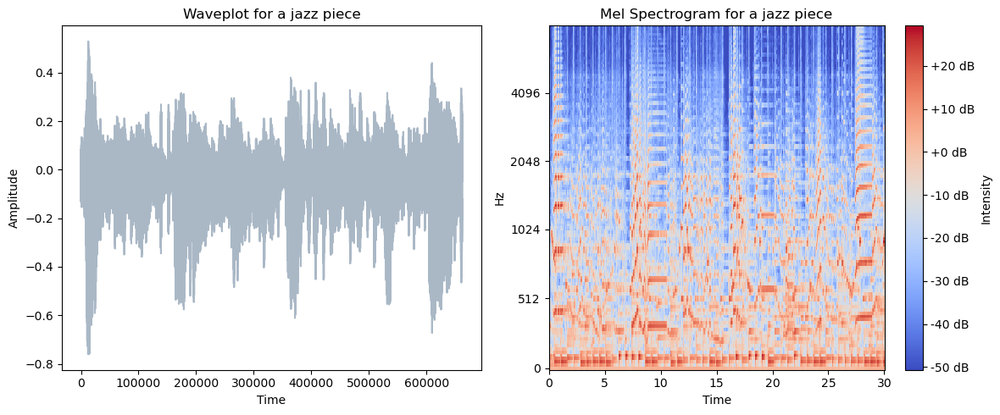


Genre Name: blues
there are 100 audio files available for this genre
Sample Audio File: blues.00082.wav


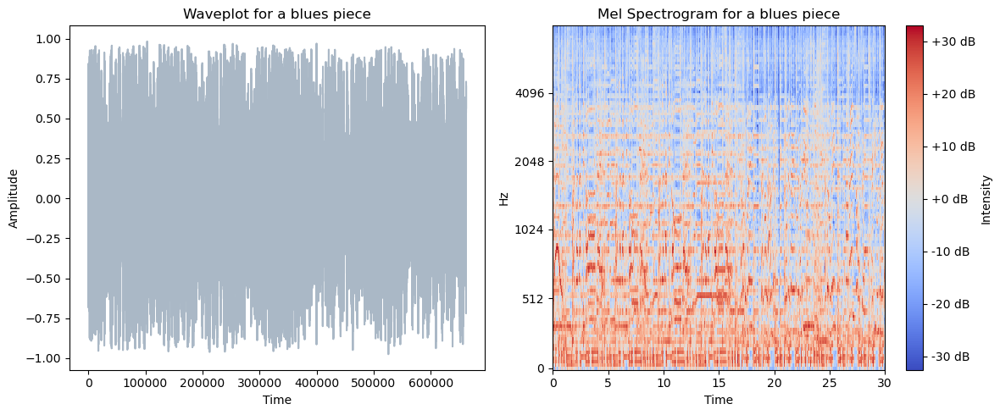


Genre Name: reggae
there are 100 audio files available for this genre
Sample Audio File: reggae.00096.wav


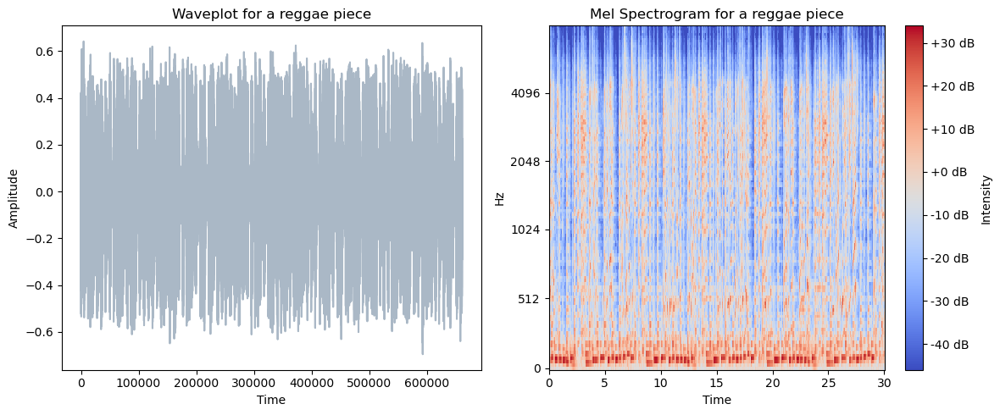


Genre Name: disco
there are 100 audio files available for this genre
Sample Audio File: disco.00015.wav


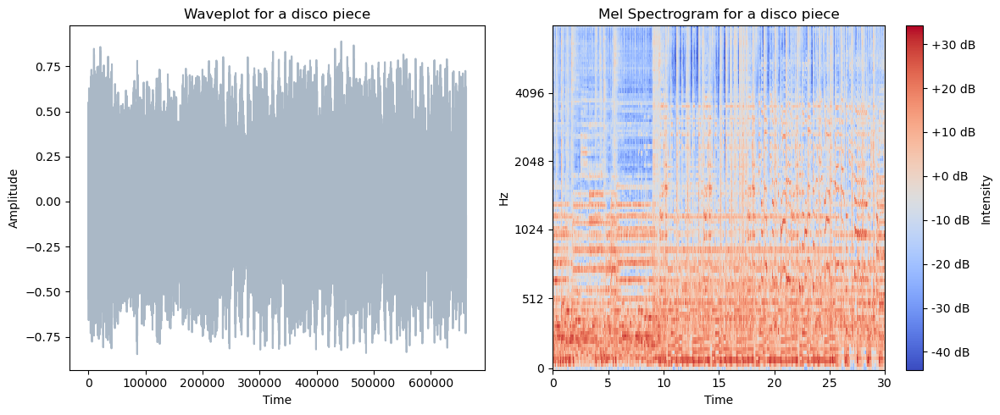


Genre Name: pop
there are 100 audio files available for this genre
Sample Audio File: pop.00035.wav


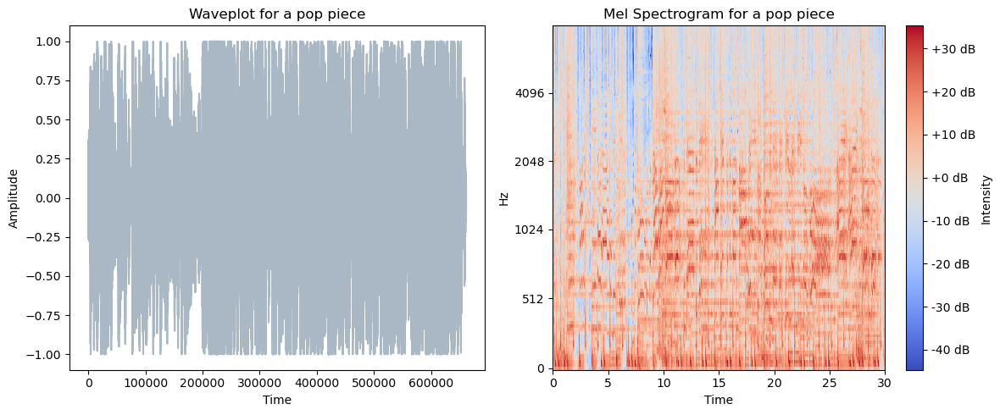


Genre Name: hiphop
there are 100 audio files available for this genre
Sample Audio File: hiphop.00071.wav


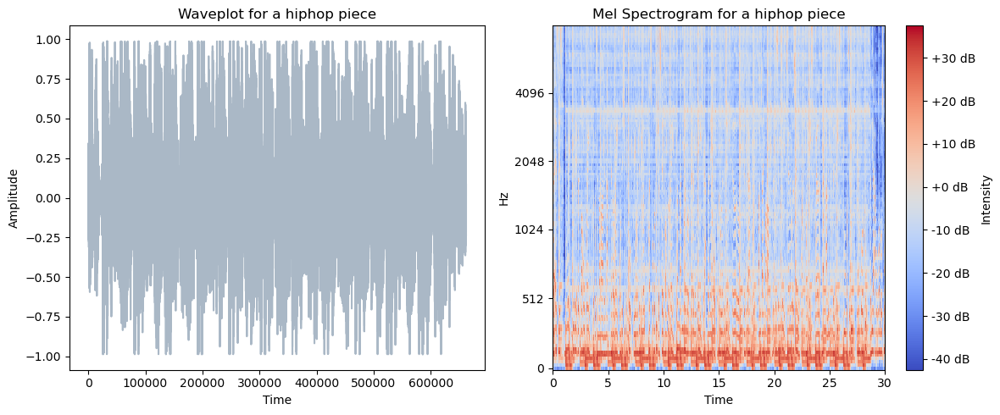

In [6]:
# Get a list of subfolders in the main folder

genres_folder_path = 'Data/genres_original'
genres = []
subfolders = [f.path for f in os.scandir(genres_folder_path) if f.is_dir()]

# Iterate through subfolders
for folder in subfolders:
    genre = os.path.basename(folder)
    genres.append(genre)
    print(f"\nGenre Name: {genre}")
    
    # Get a list of audio files in each subfolder
    audio_files = [f for f in os.listdir(folder) if f.endswith('.wav')]

    # Load and play a sample audio file from each subfolder
    if len(audio_files) > 0:
        print(f'there are {len(audio_files)} audio files available for this genre')
        sample_audio_file = os.path.join(folder, audio_files[0])  # Choose the first audio file
        print(f"Sample Audio File: {audio_files[0]}")

        audio_show(sample_audio_file, genre)
        
    else:
        print("No audio files found in this folder.")


In [4]:
data_folder_path = 'Data/'

dataset = pd.read_csv(data_folder_path + 'features_30_sec.csv')

dataset.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


In [122]:
dataset.columns 

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

In [123]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 1000 non-null   object 
 1   length                   1000 non-null   int64  
 2   chroma_stft_mean         1000 non-null   float64
 3   chroma_stft_var          1000 non-null   float64
 4   rms_mean                 1000 non-null   float64
 5   rms_var                  1000 non-null   float64
 6   spectral_centroid_mean   1000 non-null   float64
 7   spectral_centroid_var    1000 non-null   float64
 8   spectral_bandwidth_mean  1000 non-null   float64
 9   spectral_bandwidth_var   1000 non-null   float64
 10  rolloff_mean             1000 non-null   float64
 11  rolloff_var              1000 non-null   float64
 12  zero_crossing_rate_mean  1000 non-null   float64
 13  zero_crossing_rate_var   1000 non-null   float64
 14  harmony_mean             

==> *all the features numerical, except 'filename' and 'label'*

In [125]:
dataset.describe()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,662030.846000,0.378682,0.086340,0.130930,0.003051,2201.780898,4.696916e+05,2242.541070,137079.155165,4571.549304,...,1.148144,60.730958,-3.966028,62.633624,0.507696,63.712586,-2.328761,66.231930,-1.095348,70.126096
std,1784.073992,0.081705,0.007735,0.065683,0.003634,715.960600,4.008995e+05,526.316473,96455.666326,1574.791602,...,4.578948,33.781951,4.549697,33.479172,3.869105,34.401977,3.755957,37.174631,3.837007,45.228512
min,660000.000000,0.171939,0.044555,0.005276,0.000004,570.040355,7.911251e+03,898.066208,10787.185064,749.140636,...,-15.693844,9.169314,-17.234728,13.931521,-11.963694,15.420555,-18.501955,13.487622,-19.929634,7.956583
25%,661504.000000,0.319562,0.082298,0.086657,0.000942,1627.697311,1.843505e+05,1907.240605,67376.554428,3380.069642,...,-1.863280,40.376442,-7.207225,40.830875,-2.007015,41.884240,-4.662925,41.710184,-3.368996,42.372865
50%,661794.000000,0.383148,0.086615,0.122443,0.001816,2209.263090,3.384862e+05,2221.392843,111977.548036,4658.524473,...,1.212809,52.325077,-4.065605,54.717674,0.669643,54.804890,-2.393862,57.423059,-1.166289,59.186117
75%,661794.000000,0.435942,0.091256,0.175682,0.003577,2691.294667,6.121479e+05,2578.469836,182371.576801,5533.810460,...,4.359662,71.691755,-0.838737,75.040838,3.119212,75.385832,0.150573,78.626444,1.312615,85.375374
max,675808.000000,0.663685,0.108111,0.397973,0.027679,4435.243901,3.036843e+06,3509.646417,694784.811549,8677.672688,...,13.457150,392.932373,11.482946,406.058868,15.388390,332.905426,14.694924,393.161987,15.369627,506.065155


In [7]:
features = [
        'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var'
]

In [127]:
# correlation between one feature and another

corr_matrix = dataset[features].corr()
corr_matrix

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
chroma_stft_mean,1.000000,-0.461729,0.499926,0.261544,0.615728,0.285926,0.517710,0.041088,0.598122,0.117139,...,0.332359,-0.452955,-0.163474,-0.456298,0.269935,-0.478452,-0.089509,-0.501768,0.281965,-0.548577
chroma_stft_var,-0.461729,1.000000,-0.078777,0.290138,-0.246441,0.305819,-0.036896,0.346907,-0.168721,0.383134,...,-0.311178,0.361752,0.205117,0.389468,-0.239597,0.378200,0.184323,0.365291,-0.231715,0.333581
rms_mean,0.499926,-0.078777,1.000000,0.607399,0.510154,0.324077,0.530017,0.099830,0.537902,0.200083,...,0.083936,-0.160347,-0.029562,-0.163490,0.118239,-0.164834,0.031297,-0.207680,0.124413,-0.252434
rms_var,0.261544,0.290138,0.607399,1.000000,0.347831,0.583353,0.402333,0.320793,0.368570,0.417880,...,-0.093893,0.091863,0.168169,0.100234,-0.002585,0.058050,0.186953,0.049879,0.029364,0.012087
spectral_centroid_mean,0.615728,-0.246441,0.510154,0.347831,1.000000,0.520548,0.904435,0.011256,0.979637,0.198031,...,0.153741,-0.180200,0.027473,-0.158666,0.228275,-0.136272,0.027918,-0.146316,0.269601,-0.205531
spectral_centroid_var,0.285926,0.305819,0.324077,0.583353,0.520548,1.000000,0.622834,0.636494,0.545128,0.815550,...,-0.186864,0.072319,0.175573,0.094155,-0.063059,0.059431,0.188945,0.046847,-0.021837,0.008115
spectral_bandwidth_mean,0.517710,-0.036896,0.530017,0.402333,0.904435,0.622834,1.000000,0.220159,0.956189,0.438581,...,0.027206,-0.146152,0.105010,-0.122739,0.114873,-0.102737,0.098217,-0.121584,0.187786,-0.193574
spectral_bandwidth_var,0.041088,0.346907,0.099830,0.320793,0.011256,0.636494,0.220159,1.000000,0.053632,0.884877,...,-0.267098,0.104727,0.128638,0.108537,-0.178183,0.074145,0.124554,0.028696,-0.157001,0.026121
rolloff_mean,0.598122,-0.168721,0.537902,0.368570,0.979637,0.545128,0.956189,0.053632,1.000000,0.261685,...,0.132443,-0.180777,0.039693,-0.157343,0.205222,-0.131517,0.048248,-0.144641,0.256570,-0.215384
rolloff_var,0.117139,0.383134,0.200083,0.417880,0.198031,0.815550,0.438581,0.884877,0.261685,1.000000,...,-0.269606,0.101319,0.126617,0.107129,-0.163651,0.077524,0.131258,0.045181,-0.144971,0.019691


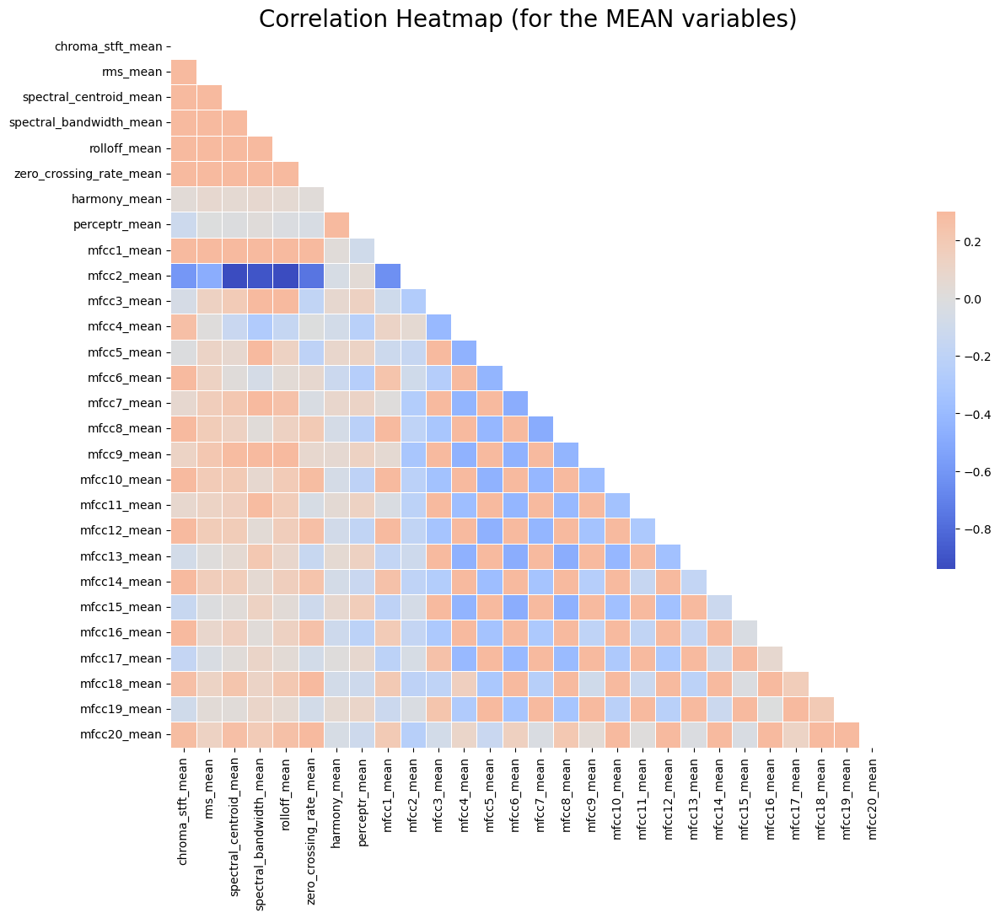

In [129]:
# correlation matrix for the mean features


spike_cols = [feature for feature in features if 'mean' in feature]
corr_matrix = dataset[spike_cols].corr()

mask = np.triu(np.ones_like(corr_matrix, dtype=np.bool_))

f, ax = plt.subplots(figsize=(16, 11))

#cmap = sns.diverging_palette(0, 25, as_cmap=True, s = 90, l = 45, n = 5)
cmap = sns.color_palette("coolwarm", as_cmap=True)


sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap (for the MEAN variables)', fontsize = 20)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10);
plt.savefig("Corr_Heatmap_Mean.png")

==> *it is really lamping that mfcc2_mean is highly correlated to spectral_centroid_mean, spectral_bandwidth_mean, rolloff_mean and zero_crossing_rate_mean*

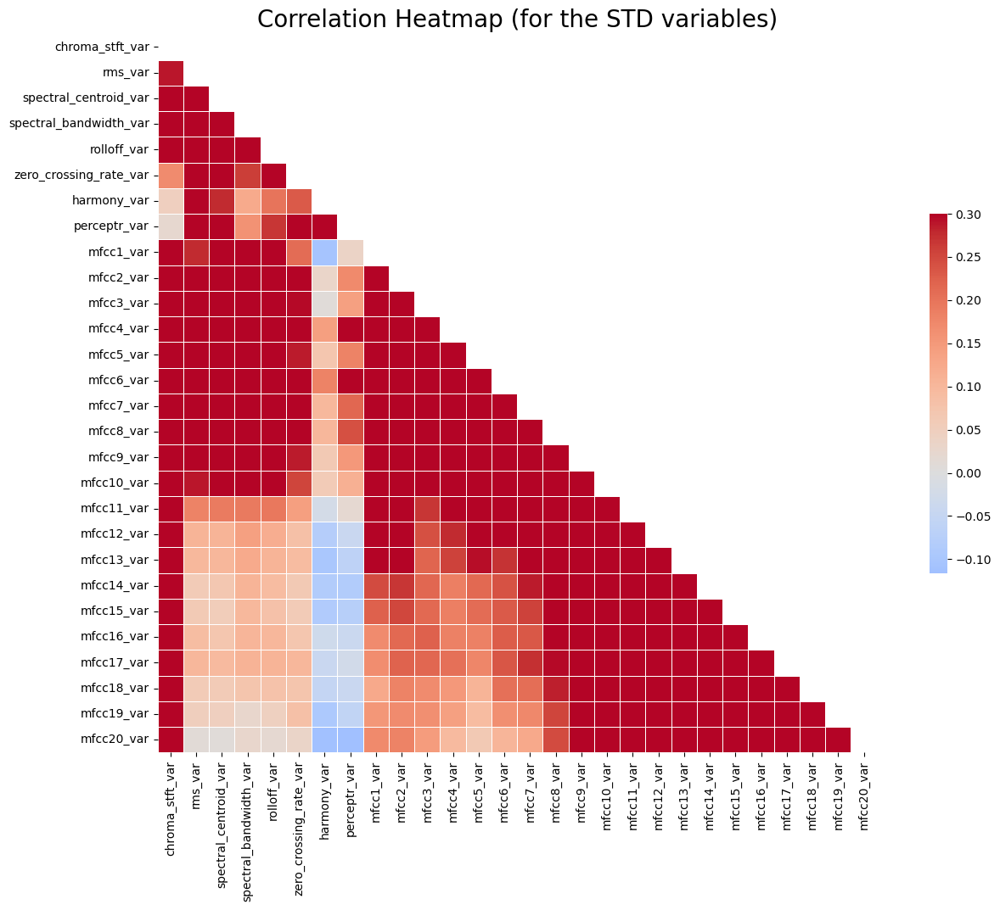

In [130]:
# correlation matrix for the var (standard deviation) features


spike_cols = [feature for feature in features if 'var' in feature]
corr_matrix = dataset[spike_cols].corr()

mask = np.triu(np.ones_like(corr_matrix, dtype=np.bool_))

f, ax = plt.subplots(figsize=(16, 11))

#cmap = sns.diverging_palette(0, 25, as_cmap=True, s = 90, l = 45, n = 5)
cmap = sns.color_palette("coolwarm", as_cmap=True)


sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap (for the STD variables)', fontsize = 20)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10);
plt.savefig("Corr_Heatmap_STD.png")

**Tempo Distribution per Genre:**
        
* *Violin Plot* : It shows the distribution of tempo for each genre, helping understand the central tendency, spread, and multimodal nature of tempo within different genres. It can reveal if certain genres tend to have a wider or narrower range of tempos.
* *Swarm Plot* : This plot will display individual tempo values for each genre. It can help identify outliers or specific trends within genres, showcasing if there's a concentration of tempos within certain genres.

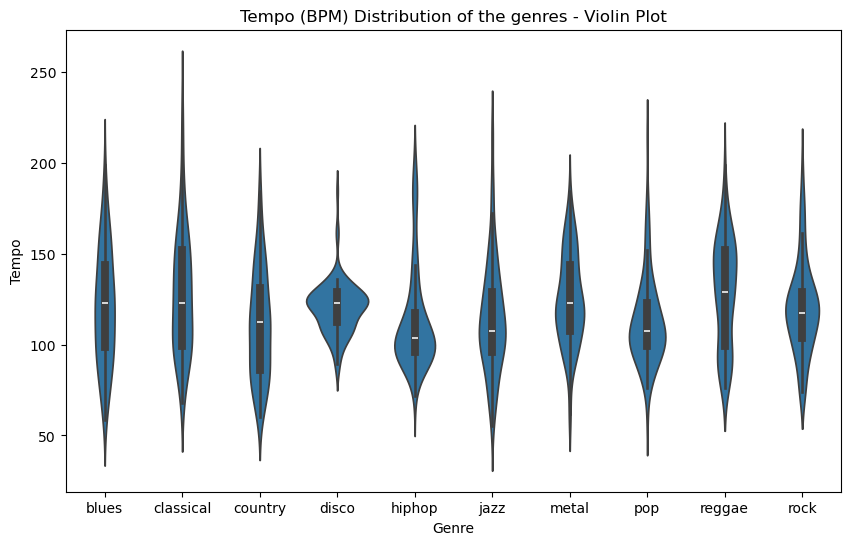

/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/seaborn/categorical.py:3370: UserWarning: 33.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/seaborn/categorical.py:3370: UserWarning: 16.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/seaborn/categorical.py:3370: UserWarning: 7.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/seaborn/categorical.py:3370: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


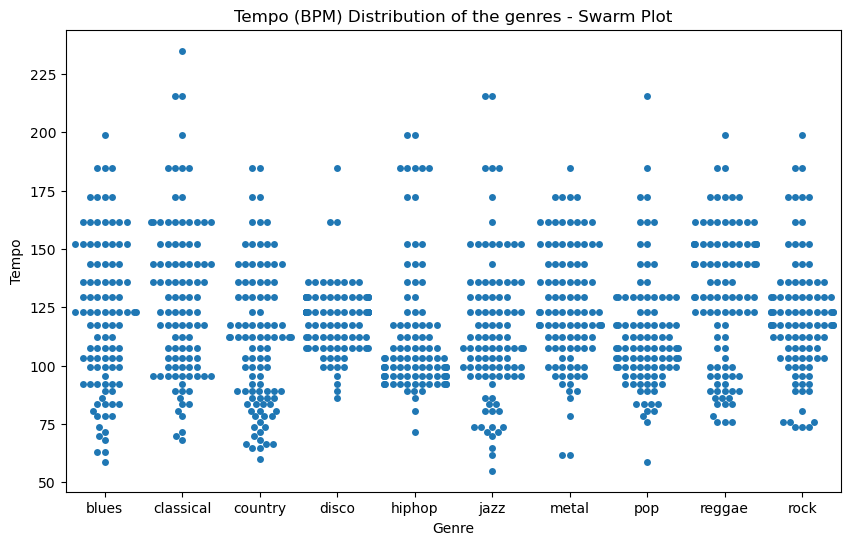

In [131]:
# Violin Plot
plt.figure(figsize=(10, 6))
sns.violinplot(x='label', y='tempo', data=dataset)
plt.title('Tempo (BPM) Distribution of the genres - Violin Plot')
plt.xlabel('Genre')
plt.ylabel('Tempo')
plt.show()

# Swarm Plot
plt.figure(figsize=(10, 6))
sns.swarmplot(x='label', y='tempo', data=dataset)
plt.title('Tempo (BPM) Distribution of the genres - Swarm Plot')
plt.xlabel('Genre')
plt.ylabel('Tempo')
plt.show()

In [132]:
dataset.isnull()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
996,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
997,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
998,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [133]:
dataset.isnull().sum()

filename                   0
length                     0
chroma_stft_mean           0
chroma_stft_var            0
rms_mean                   0
rms_var                    0
spectral_centroid_mean     0
spectral_centroid_var      0
spectral_bandwidth_mean    0
spectral_bandwidth_var     0
rolloff_mean               0
rolloff_var                0
zero_crossing_rate_mean    0
zero_crossing_rate_var     0
harmony_mean               0
harmony_var                0
perceptr_mean              0
perceptr_var               0
tempo                      0
mfcc1_mean                 0
mfcc1_var                  0
mfcc2_mean                 0
mfcc2_var                  0
mfcc3_mean                 0
mfcc3_var                  0
mfcc4_mean                 0
mfcc4_var                  0
mfcc5_mean                 0
mfcc5_var                  0
mfcc6_mean                 0
mfcc6_var                  0
mfcc7_mean                 0
mfcc7_var                  0
mfcc8_mean                 0
mfcc8_var     

==> NO MISSING VALUES!

In [8]:
genres

['classical',
 'rock',
 'metal',
 'country',
 'jazz',
 'blues',
 'reggae',
 'disco',
 'pop',
 'hiphop']

***mapping labels to numerical values***

In [9]:
label_values = {
    'classical': 0, 
    'rock': 1,
    'metal': 2,
    'country': 3, 
    'jazz': 4, 
    'blues': 5, 
    'reggae': 6, 
    'disco': 7, 
    'pop': 8, 
    'hiphop': 9
}

dataset.label = dataset.label.map(label_values)

In [10]:
dataset

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,5
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,5
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,5
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,5
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,rock.00095.wav,661794,0.352063,0.080487,0.079486,0.000345,2008.149458,282174.689224,2106.541053,88609.749506,...,45.050526,-13.289984,41.754955,2.484145,36.778877,-6.713265,54.866825,-1.193787,49.950665,1
996,rock.00096.wav,661794,0.398687,0.075086,0.076458,0.000588,2006.843354,182114.709510,2068.942009,82426.016726,...,33.851742,-10.848309,39.395096,1.881229,32.010040,-7.461491,39.196327,-2.795338,31.773624,1
997,rock.00097.wav,661794,0.432142,0.075268,0.081651,0.000322,2077.526598,231657.968040,1927.293153,74717.124394,...,33.597008,-12.845291,36.367264,3.440978,36.001110,-12.588070,42.502201,-2.106337,29.865515,1
998,rock.00098.wav,661794,0.362485,0.091506,0.083860,0.001211,1398.699344,240318.731073,1818.450280,109090.207161,...,46.324894,-4.416050,43.583942,1.556207,34.331261,-5.041897,47.227180,-3.590644,41.299088,1


In [12]:
dataset.label.value_counts()

label
5    100
0    100
3    100
7    100
9    100
4    100
2    100
8    100
6    100
1    100
Name: count, dtype: int64

***getting rid of the features that are not really useful to the aim the of the project***

In [13]:
dataset.drop(['filename', 'length'], axis=1, inplace=True)

In [14]:
dataset

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,3805.839606,9.015054e+05,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,5
1,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,3550.522098,2.977893e+06,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,5
2,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,3042.260232,7.840345e+05,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,5
3,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,2184.745799,1.493194e+06,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,5
4,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,3579.757627,1.572978e+06,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.352063,0.080487,0.079486,0.000345,2008.149458,282174.689224,2106.541053,88609.749506,4253.557033,1.222421e+06,...,45.050526,-13.289984,41.754955,2.484145,36.778877,-6.713265,54.866825,-1.193787,49.950665,1
996,0.398687,0.075086,0.076458,0.000588,2006.843354,182114.709510,2068.942009,82426.016726,4149.338328,1.046621e+06,...,33.851742,-10.848309,39.395096,1.881229,32.010040,-7.461491,39.196327,-2.795338,31.773624,1
997,0.432142,0.075268,0.081651,0.000322,2077.526598,231657.968040,1927.293153,74717.124394,4031.405321,8.042154e+05,...,33.597008,-12.845291,36.367264,3.440978,36.001110,-12.588070,42.502201,-2.106337,29.865515,1
998,0.362485,0.091506,0.083860,0.001211,1398.699344,240318.731073,1818.450280,109090.207161,3015.631004,1.332712e+06,...,46.324894,-4.416050,43.583942,1.556207,34.331261,-5.041897,47.227180,-3.590644,41.299088,1


**Shuffling and Spliting the dataset**

In [15]:
dataset_shuffle = dataset.sample(frac=1, random_state=42).reset_index(drop=True)

In [16]:
df_full_train, df_test = train_test_split(dataset_shuffle, test_size=0.2, random_state=1)
df_train, df_val = train_test_split(df_full_train, test_size=0.25, random_state=1)

In [17]:
df_full_train = df_full_train.reset_index(drop=True)
df_train = df_train.reset_index(drop=True)
df_val = df_val.reset_index(drop=True)
df_test = df_test.reset_index(drop=True)

In [18]:
y_train = df_train.label.values
y_val = df_val.label.values
y_test = df_test.label.values
y_full_train = df_full_train.label.values

In [19]:
del df_train['label']
del df_val['label']
del df_test['label']

In [20]:
len(df_train), len(df_val), len(df_test), len(df_full_train)

(600, 200, 200, 800)

**Feature Scaling:** 

* ***Objective:*** Scaling aims to normalize the range of features so that they're on a similar scale.
* ***Importance:*** Different features might have different scales and magnitudes, which can affect the performance of some machine learning algorithms (especially those based on distances or gradient descent).

In [147]:
scaler = skp.StandardScaler()

X_train = scaler.fit_transform(df_train)
X_val = scaler.transform(df_val)

**MLP (Feedforward Neural Network)**

***base model:***
building a MLP model with three hidden layers having 512, 256 and 64 neurons, 
respectively, all of them with "ReLU" activation. The output layer, as dealing with a classification problem, has as many outputs as number of classes and "softmax" activation.

In [148]:
model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train.shape[1],)))

# Stacked Dense Layers
model.add(keras.layers.Dense(512, activation="relu")) 
model.add(keras.layers.Dense(256, activation="relu"))
model.add(keras.layers.Dense(64,  activation="relu"))

# Output Layer
model.add(keras.layers.Dense(10, activation="softmax")) # 10 ==> number of classes
model.summary()

Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_155 (Dense)           (None, 512)               29696     
                                                                 
 dense_156 (Dense)           (None, 256)               131328    
                                                                 
 dense_157 (Dense)           (None, 64)                16448     
                                                                 
 dense_158 (Dense)           (None, 10)                650       
                                                                 
Total params: 178122 (695.79 KB)
Trainable params: 178122 (695.79 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# compile model

adamopt = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])


# train model 

history = model.fit(X_train, y_train, validation_data=(X_val, y_val), batch_size=32, epochs=100) #batch_size ==> the number of examples that we use from the training data every time we update the weights in the network

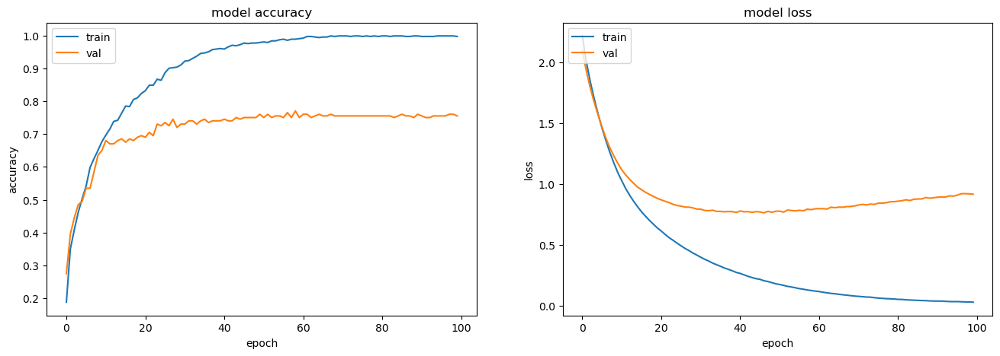

In [150]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

==> it is possible to see that the model overfits

In [151]:
# best validation accuracy
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

Best validation accuracy:  0.7699999809265137


7/7 [==============================] - 0s 1ms/step
              precision    recall  f1-score   support

   classical       0.90      0.95      0.93        20
        rock       0.67      0.63      0.65        19
       metal       0.81      0.89      0.85        19
     country       0.83      0.79      0.81        24
        jazz       0.83      0.62      0.71        16
       blues       0.78      0.78      0.78        18
      reggae       0.58      0.78      0.67        18
       disco       0.67      0.74      0.70        19
         pop       0.78      0.72      0.75        25
      hiphop       0.74      0.64      0.68        22

    accuracy                           0.76       200
   macro avg       0.76      0.75      0.75       200
weighted avg       0.76      0.76      0.75       200



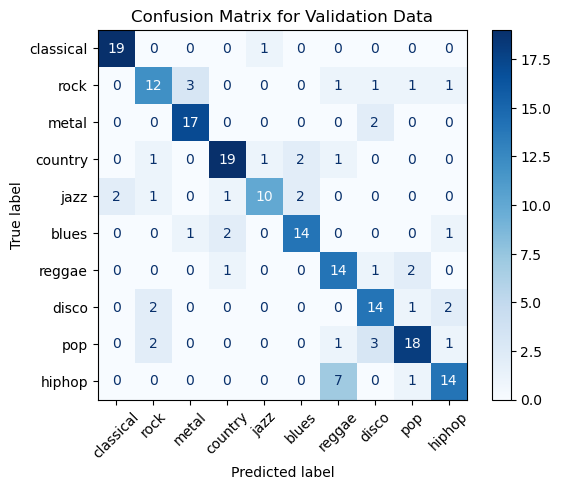

In [152]:
preds = np.argmax(model.predict(X_val), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)

print(classification_report(y_val, preds, target_names = genres))

==> it really does have nice performances but the validation loss does look to be acceptable

***tuning the model :***

    * L2 regularization to the weights of the hidden layers
    * Dropout in between hidden layers

In [153]:
def create_model(regularization_rate=0.001):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train.shape[1],)))
    
    model.add(keras.layers.Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dense(256, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dense(10, activation='softmax'))
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])    
    
    return model

Best validation accuracy for regularization rate=0.001:  0.7649999856948853
7/7 [==============================] - 0s 1ms/step


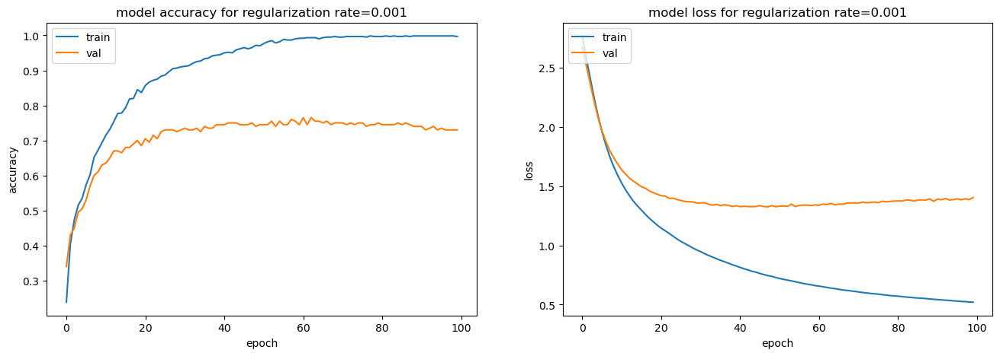

<Figure size 1600x500 with 0 Axes>

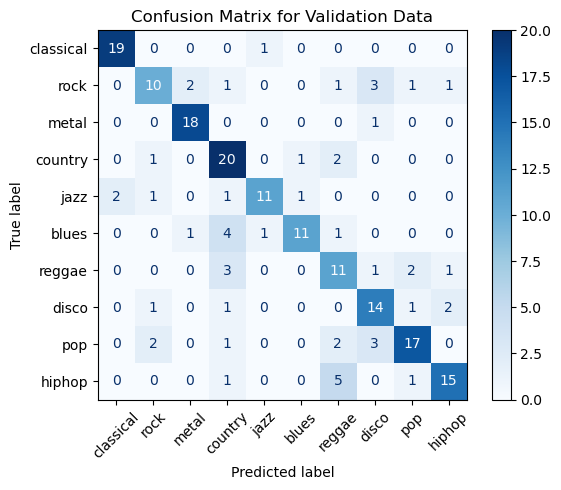

              precision    recall  f1-score   support

   classical       0.90      0.95      0.93        20
        rock       0.67      0.53      0.59        19
       metal       0.86      0.95      0.90        19
     country       0.62      0.83      0.71        24
        jazz       0.85      0.69      0.76        16
       blues       0.85      0.61      0.71        18
      reggae       0.50      0.61      0.55        18
       disco       0.64      0.74      0.68        19
         pop       0.77      0.68      0.72        25
      hiphop       0.79      0.68      0.73        22

    accuracy                           0.73       200
   macro avg       0.74      0.73      0.73       200
weighted avg       0.74      0.73      0.73       200

Best validation accuracy for regularization rate=0.01:  0.7649999856948853
7/7 [==============================] - 0s 858us/step


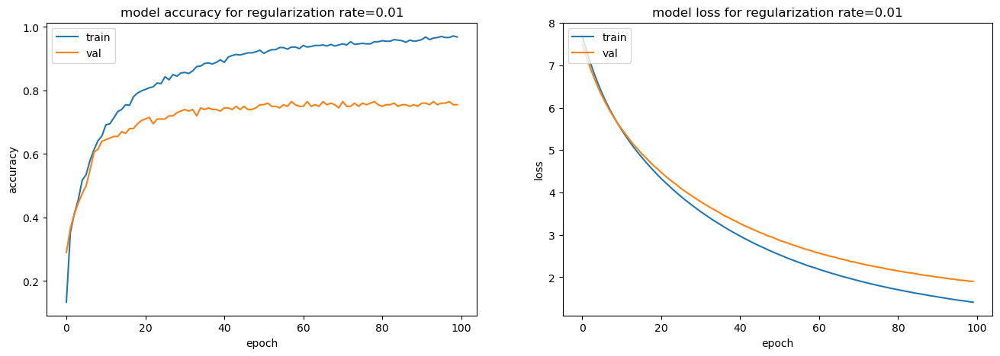

<Figure size 1600x500 with 0 Axes>

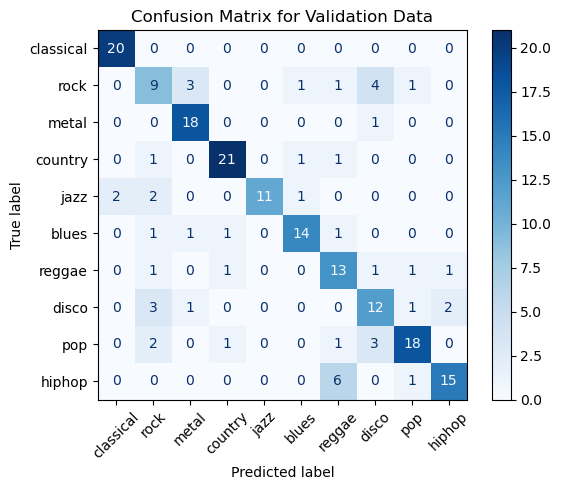

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.47      0.47      0.47        19
       metal       0.78      0.95      0.86        19
     country       0.88      0.88      0.88        24
        jazz       1.00      0.69      0.81        16
       blues       0.82      0.78      0.80        18
      reggae       0.57      0.72      0.63        18
       disco       0.57      0.63      0.60        19
         pop       0.82      0.72      0.77        25
      hiphop       0.83      0.68      0.75        22

    accuracy                           0.76       200
   macro avg       0.77      0.75      0.75       200
weighted avg       0.77      0.76      0.76       200

Best validation accuracy for regularization rate=0.1:  0.4050000011920929
7/7 [==============================] - 0s 1ms/step


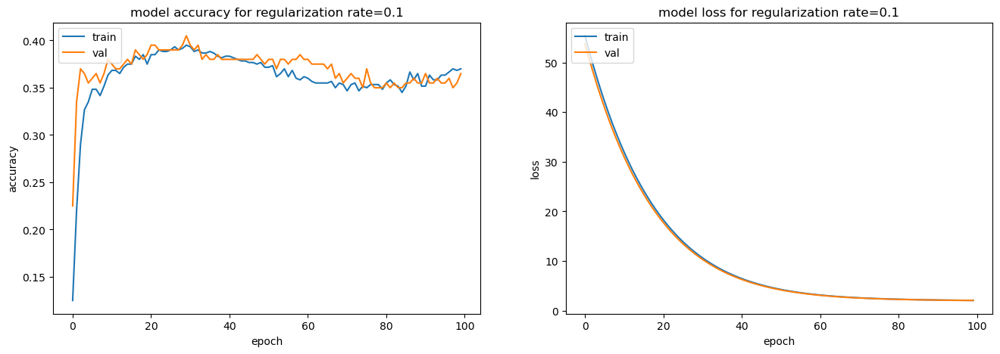

<Figure size 1600x500 with 0 Axes>

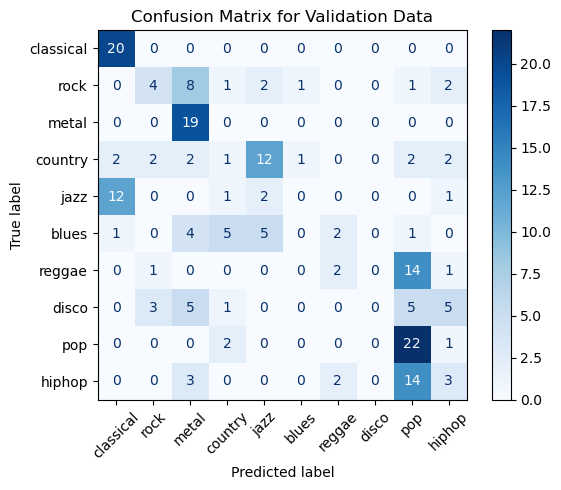

              precision    recall  f1-score   support

   classical       0.57      1.00      0.73        20
        rock       0.40      0.21      0.28        19
       metal       0.46      1.00      0.63        19
     country       0.09      0.04      0.06        24
        jazz       0.10      0.12      0.11        16
       blues       0.00      0.00      0.00        18
      reggae       0.33      0.11      0.17        18
       disco       0.00      0.00      0.00        19
         pop       0.37      0.88      0.52        25
      hiphop       0.20      0.14      0.16        22

    accuracy                           0.36       200
   macro avg       0.25      0.35      0.27       200
weighted avg       0.26      0.36      0.27       200

Regularization Rate: 0.001, Validation Accuracy: 0.7300000190734863
Regularization Rate: 0.01, Validation Accuracy: 0.7549999952316284
Regularization Rate: 0.1, Validation Accuracy: 0.36500000953674316


/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

In [154]:
# Define the list of regularization rates to test
regularization_rates = [0.001, 0.01, 0.1]

# Train models with different regularization rates
results = {}
for rate in regularization_rates:
    model = create_model(regularization_rate=rate)
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for regularization rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for regularization rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for regularization rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    
    preds = np.argmax(model.predict(X_val), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))

# Print results
for rate, result in results.items():
    print(f'Regularization Rate: {rate}, Validation Accuracy: {result[1]}')


==> The best validation accuracy among the tested regularization rates seems to be achieved with a regularization rate of 0.01, reaching an accuracy of approximately 75%. This rate appears to strike a good balance between reducing overfitting and maintaining model performance on unseen data.

In [155]:
def create_model(regularization_rate, dropout_rate=0.01):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train.shape[1],)))
    
    model.add(keras.layers.Dense(512, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.Dense(256, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.Dense(10, activation='softmax'))
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])    
    
    return model

Best validation accuracy for dropout rate=0.1:  0.7599999904632568
7/7 [==============================] - 0s 1ms/step


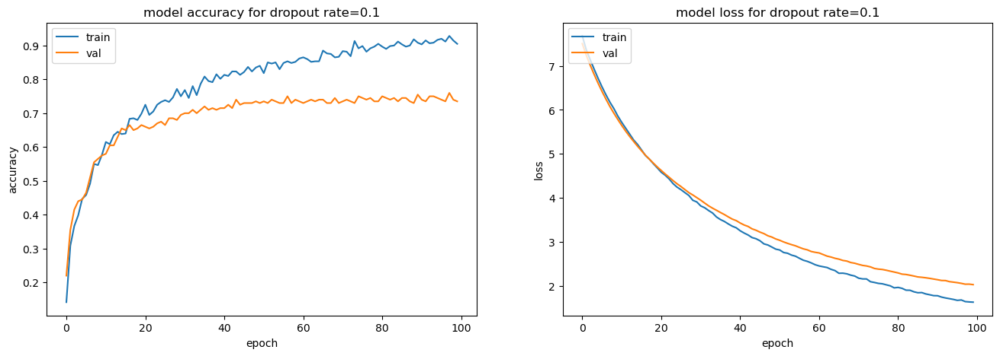

<Figure size 1600x500 with 0 Axes>

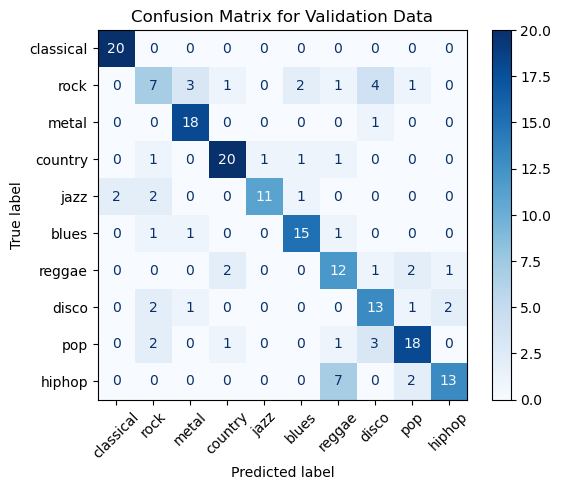

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.47      0.37      0.41        19
       metal       0.78      0.95      0.86        19
     country       0.83      0.83      0.83        24
        jazz       0.92      0.69      0.79        16
       blues       0.79      0.83      0.81        18
      reggae       0.52      0.67      0.59        18
       disco       0.59      0.68      0.63        19
         pop       0.75      0.72      0.73        25
      hiphop       0.81      0.59      0.68        22

    accuracy                           0.73       200
   macro avg       0.74      0.73      0.73       200
weighted avg       0.74      0.73      0.73       200

Best validation accuracy for dropout rate=0.2:  0.75
7/7 [==============================] - 0s 1ms/step


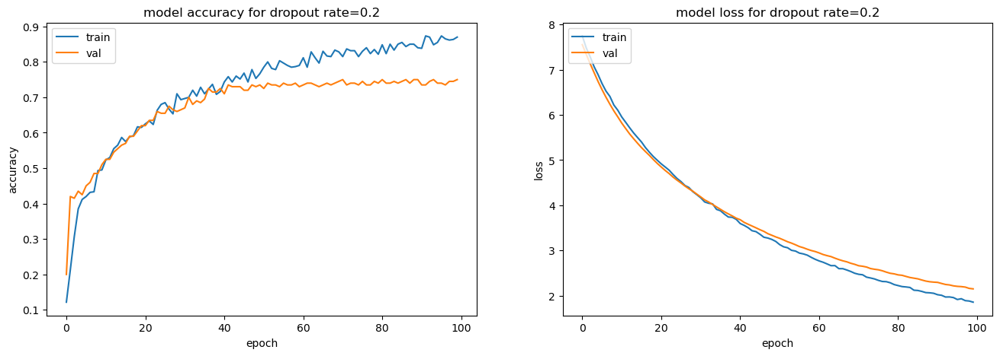

<Figure size 1600x500 with 0 Axes>

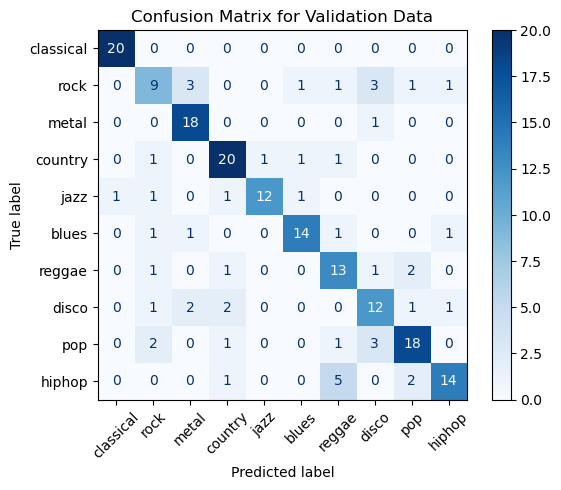

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.56      0.47      0.51        19
       metal       0.75      0.95      0.84        19
     country       0.77      0.83      0.80        24
        jazz       0.92      0.75      0.83        16
       blues       0.82      0.78      0.80        18
      reggae       0.59      0.72      0.65        18
       disco       0.60      0.63      0.62        19
         pop       0.75      0.72      0.73        25
      hiphop       0.82      0.64      0.72        22

    accuracy                           0.75       200
   macro avg       0.75      0.75      0.75       200
weighted avg       0.75      0.75      0.75       200

Best validation accuracy for dropout rate=0.3:  0.7649999856948853
7/7 [==============================] - 0s 1ms/step


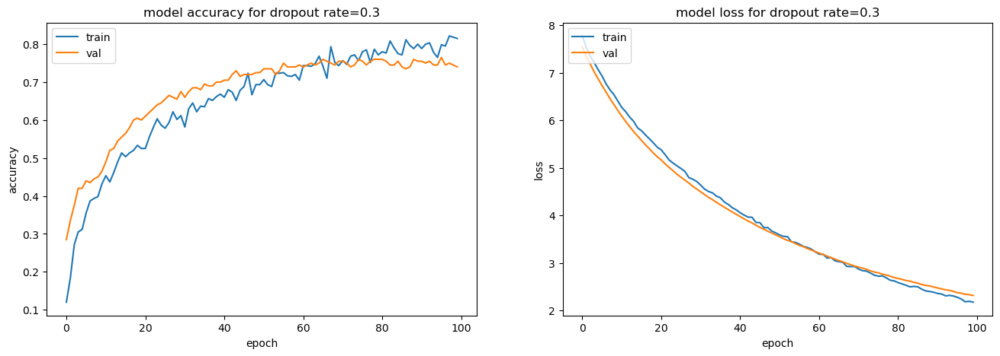

<Figure size 1600x500 with 0 Axes>

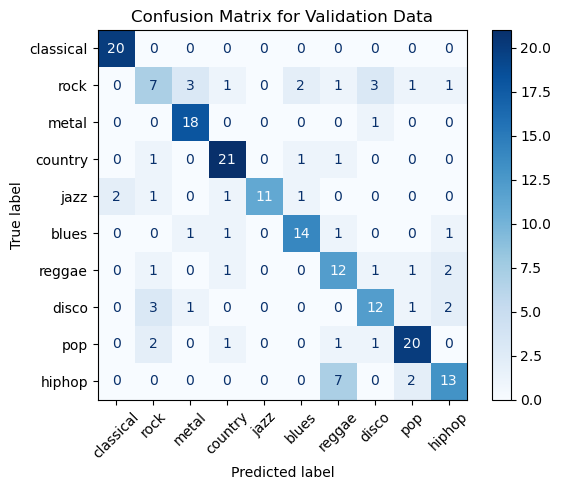

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.47      0.37      0.41        19
       metal       0.78      0.95      0.86        19
     country       0.81      0.88      0.84        24
        jazz       1.00      0.69      0.81        16
       blues       0.78      0.78      0.78        18
      reggae       0.52      0.67      0.59        18
       disco       0.67      0.63      0.65        19
         pop       0.80      0.80      0.80        25
      hiphop       0.68      0.59      0.63        22

    accuracy                           0.74       200
   macro avg       0.74      0.73      0.73       200
weighted avg       0.74      0.74      0.74       200

Best validation accuracy for dropout rate=0.4:  0.7350000143051147
7/7 [==============================] - 0s 1ms/step


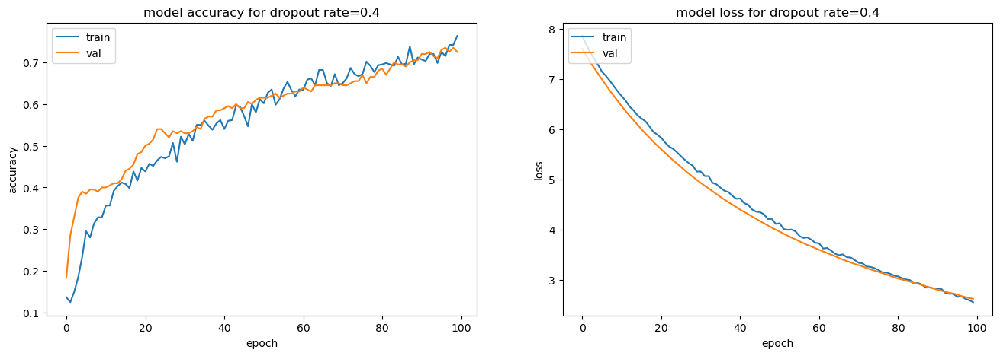

<Figure size 1600x500 with 0 Axes>

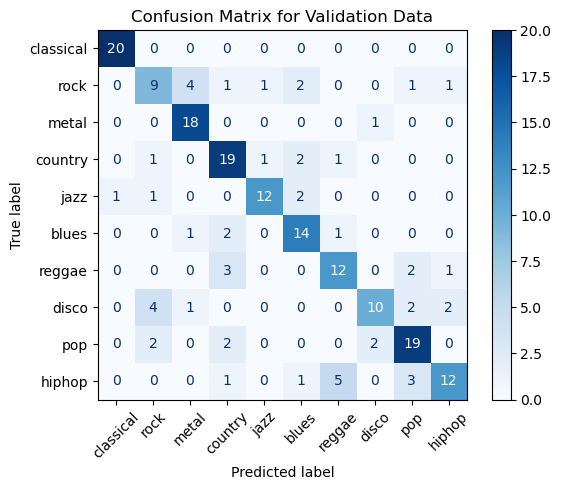

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.53      0.47      0.50        19
       metal       0.75      0.95      0.84        19
     country       0.68      0.79      0.73        24
        jazz       0.86      0.75      0.80        16
       blues       0.67      0.78      0.72        18
      reggae       0.63      0.67      0.65        18
       disco       0.77      0.53      0.62        19
         pop       0.70      0.76      0.73        25
      hiphop       0.75      0.55      0.63        22

    accuracy                           0.73       200
   macro avg       0.73      0.72      0.72       200
weighted avg       0.73      0.72      0.72       200

Best validation accuracy for dropout rate=0.5:  0.6700000166893005
7/7 [==============================] - 0s 1ms/step


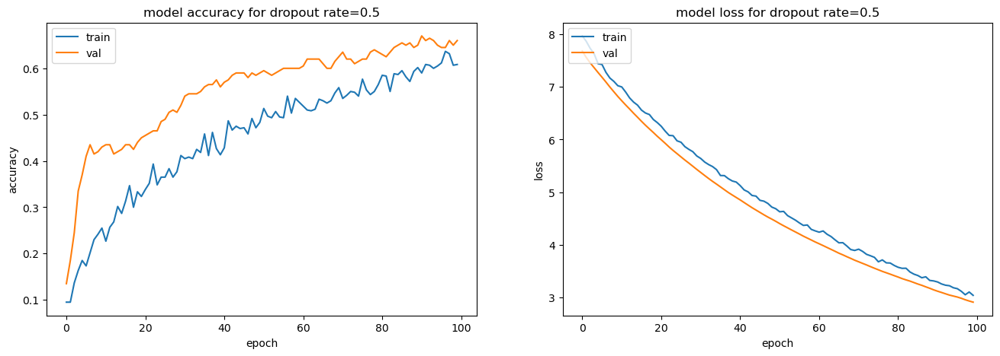

<Figure size 1600x500 with 0 Axes>

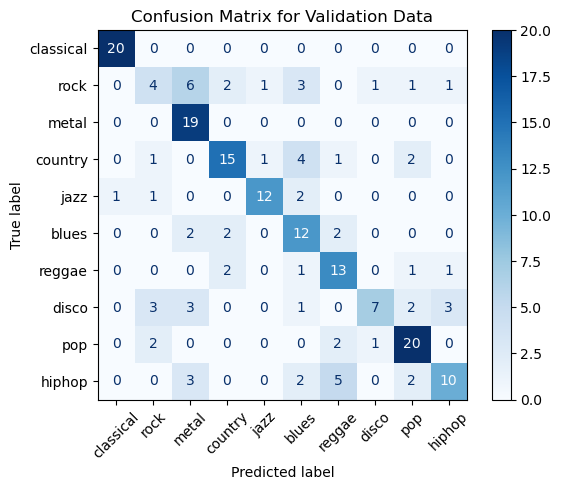

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.36      0.21      0.27        19
       metal       0.58      1.00      0.73        19
     country       0.71      0.62      0.67        24
        jazz       0.86      0.75      0.80        16
       blues       0.48      0.67      0.56        18
      reggae       0.57      0.72      0.63        18
       disco       0.78      0.37      0.50        19
         pop       0.71      0.80      0.75        25
      hiphop       0.67      0.45      0.54        22

    accuracy                           0.66       200
   macro avg       0.67      0.66      0.64       200
weighted avg       0.67      0.66      0.64       200

Best validation accuracy for dropout rate=0.6:  0.5350000262260437
7/7 [==============================] - 0s 1ms/step


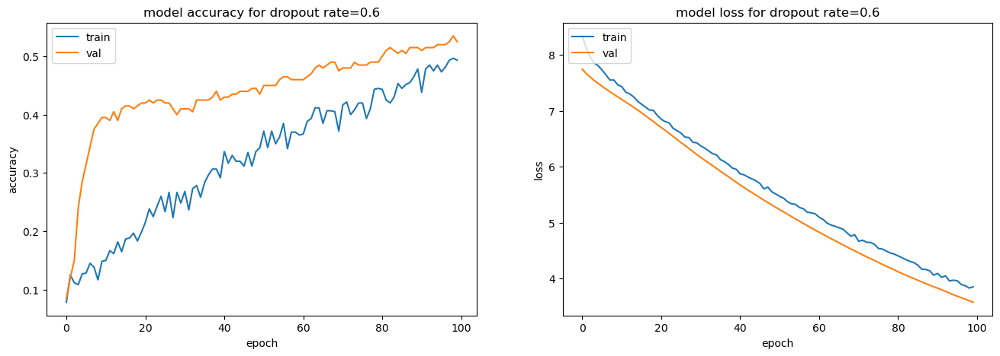

<Figure size 1600x500 with 0 Axes>

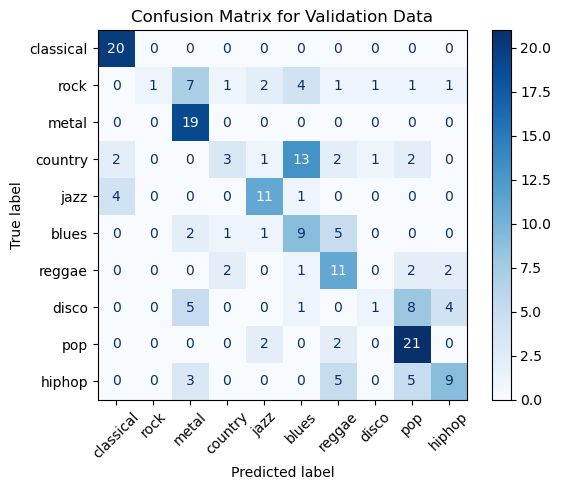

              precision    recall  f1-score   support

   classical       0.77      1.00      0.87        20
        rock       1.00      0.05      0.10        19
       metal       0.53      1.00      0.69        19
     country       0.43      0.12      0.19        24
        jazz       0.65      0.69      0.67        16
       blues       0.31      0.50      0.38        18
      reggae       0.42      0.61      0.50        18
       disco       0.33      0.05      0.09        19
         pop       0.54      0.84      0.66        25
      hiphop       0.56      0.41      0.47        22

    accuracy                           0.53       200
   macro avg       0.55      0.53      0.46       200
weighted avg       0.55      0.53      0.46       200

Dropout Rate: 0.1, Validation Accuracy: 0.7350000143051147
Dropout Rate: 0.2, Validation Accuracy: 0.75
Dropout Rate: 0.3, Validation Accuracy: 0.7400000095367432
Dropout Rate: 0.4, Validation Accuracy: 0.7250000238418579
Dropout Rate: 0.5, 

In [156]:
# best regularization rate
regularization_rate = 0.01

# Define the list of dropout rates to test
dropout_rates =  [0.1, 0.2, 0.3, 0.4, 0.5, 0.6]

# Train models with different regularization rates
results = {}
for rate in dropout_rates:
    model = create_model(regularization_rate, dropout_rate=rate)
    history = model.fit(X_train, y_train, validation_data=(X_val, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')


    preds = np.argmax(model.predict(X_val), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Dropout Rate: {rate}, Validation Accuracy: {result[1]}')


==> The best validation accuracy among the tested dropout rates appears to be achieved with a dropout rate of 0.2, reaching an accuracy of approximately 77.5%.
This dropout rate seems to provide the best balance between reducing overfitting and allowing the model to learn effectively from the training data

***final MLP model***

In [157]:
checkpoint = keras.callbacks.ModelCheckpoint(
    'mlp_model_1_{epoch:02d}_{val_accuracy:.3f}.h5',
    save_best_only=True,
    monitor='val_accuracy',
    mode='max'
)

Best validation accuracy:  0.75
7/7 [==============================] - 0s 1ms/step


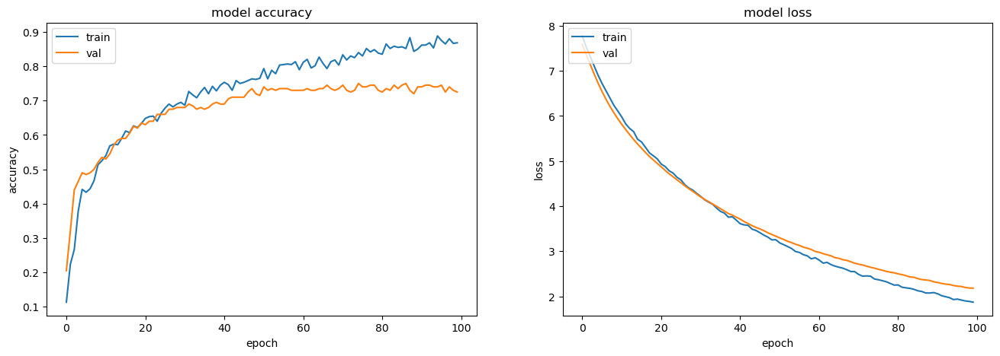

<Figure size 1600x500 with 0 Axes>

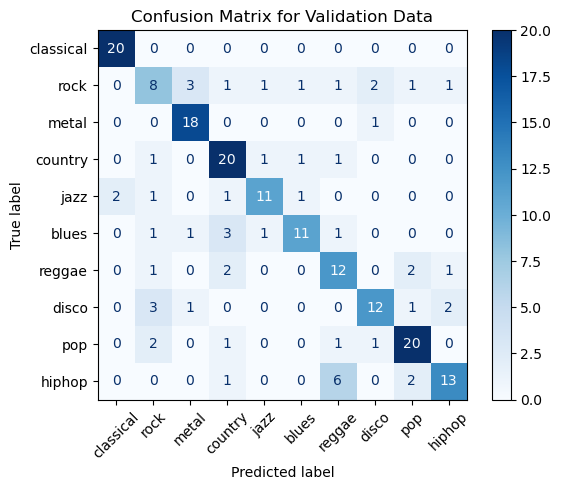

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.47      0.42      0.44        19
       metal       0.78      0.95      0.86        19
     country       0.69      0.83      0.75        24
        jazz       0.79      0.69      0.73        16
       blues       0.79      0.61      0.69        18
      reggae       0.55      0.67      0.60        18
       disco       0.75      0.63      0.69        19
         pop       0.77      0.80      0.78        25
      hiphop       0.76      0.59      0.67        22

    accuracy                           0.73       200
   macro avg       0.73      0.72      0.72       200
weighted avg       0.73      0.72      0.72       200



In [161]:
regularization_rate = 0.01 
dropout_rate = 0.2

model = create_model(regularization_rate=regularization_rate, dropout_rate=dropout_rate)
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), 
                    batch_size=32, epochs=100, callbacks=[checkpoint], verbose=0)

best_acc = np.max(history.history['val_accuracy'])
print(f'Best validation accuracy: ', best_acc)

# Plotting accuracy and loss

plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')


preds = np.argmax(model.predict(X_val), axis=1)


plt.figure(figsize=(16, 5))
cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))

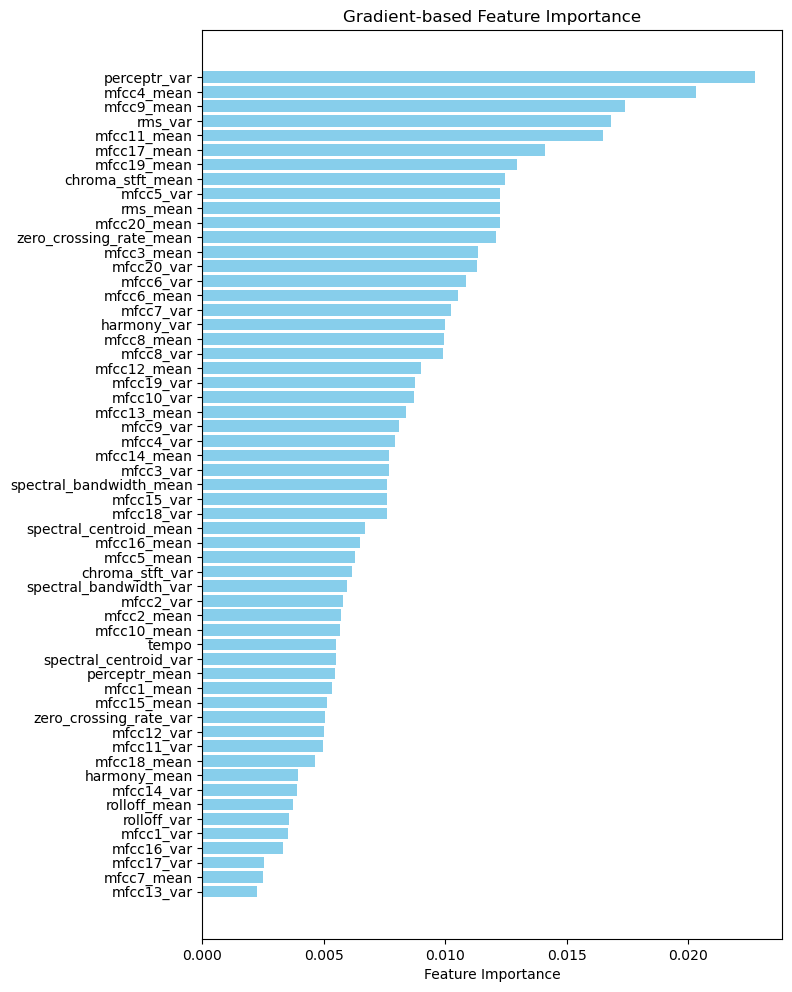

In [162]:
importance = feature_importance_gradient(model, X_val)

importance = importance.flatten()

# Sort the indices by importance
sorted_indices = np.argsort(importance)
sorted_importance = importance[sorted_indices]
sorted_feature_names = [features[i] for i in sorted_indices]

# Plotting the feature importance
plt.figure(figsize=(8, 10)) 
plt.barh(range(len(sorted_importance)), sorted_importance, tick_label=sorted_feature_names, height=0.8, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Gradient-based Feature Importance')

plt.tight_layout(pad=1.0) 

plt.show()

**CNN (Convolutional Neural Network)**

***base model :*** 

* 3 Conv1D layers architecture that can learn hidden features from the already existing features + 3 MaxPooling1D layers
* 1 Dense (hidden) layer
* 1 Dense (output) layer

In [183]:
scaler = skp.MinMaxScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for CNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], X_train_scaled.shape[1], 1)
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], X_val_scaled.shape[1], 1) 

In [ ]:
model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], 1)))

model.add(keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu'))
model.add(keras.layers.MaxPooling1D(pool_size=2))

model.add(keras.layers.Conv1D(filters=128, kernel_size=3, activation='relu'))
model.add(keras.layers.MaxPooling1D(pool_size=2))

model.add(keras.layers.Conv1D(filters=256, kernel_size=3, activation='relu'))
model.add(keras.layers.MaxPooling1D(pool_size=2))

model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

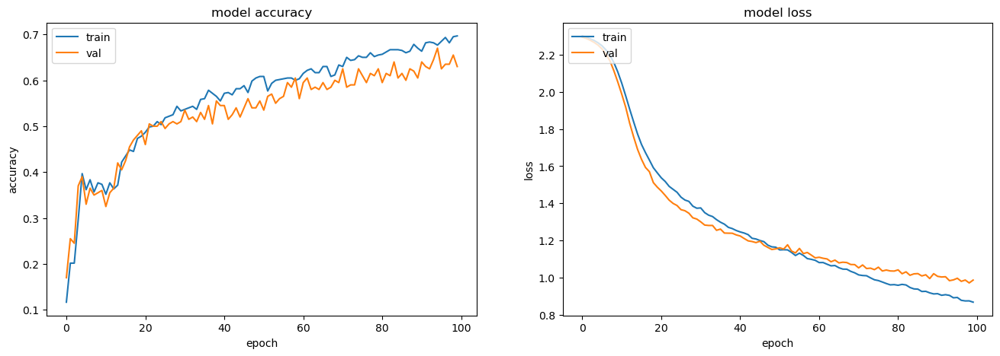

In [186]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [187]:
# best validation accuracy
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

Best validation accuracy:  0.6700000166893005


7/7 [==============================] - 0s 1ms/step


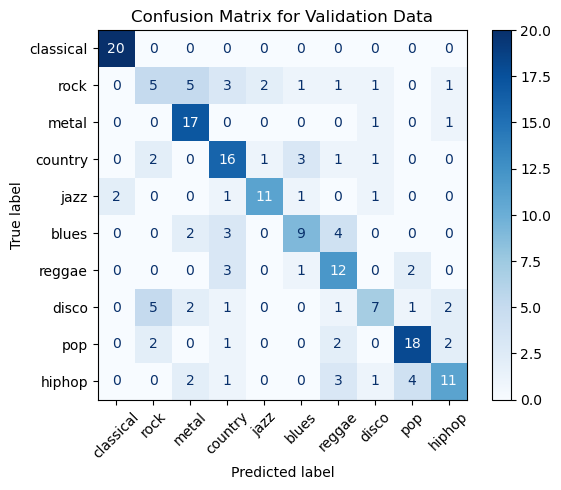

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.36      0.26      0.30        19
       metal       0.61      0.89      0.72        19
     country       0.55      0.67      0.60        24
        jazz       0.79      0.69      0.73        16
       blues       0.60      0.50      0.55        18
      reggae       0.50      0.67      0.57        18
       disco       0.58      0.37      0.45        19
         pop       0.72      0.72      0.72        25
      hiphop       0.65      0.50      0.56        22

    accuracy                           0.63       200
   macro avg       0.63      0.63      0.62       200
weighted avg       0.63      0.63      0.62       200



In [188]:
preds = np.argmax(model.predict(X_val_reshaped), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title(f'Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


==> cnn baseline model has a good performance, but let's try to tune it

***tuning the model:***

* number of filters
* kernel size
* dropout

In [189]:
# Define a function that creates your model
def create_model(filters=(32, 64, 128)):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], 1)))
    
    model.add(keras.layers.Conv1D(filters=filters[0], kernel_size=3, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[1], kernel_size=3, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[2], kernel_size=3, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model


Best validation accuracy for filters=(32, 64, 128):  0.5849999785423279
7/7 [==============================] - 0s 1ms/step


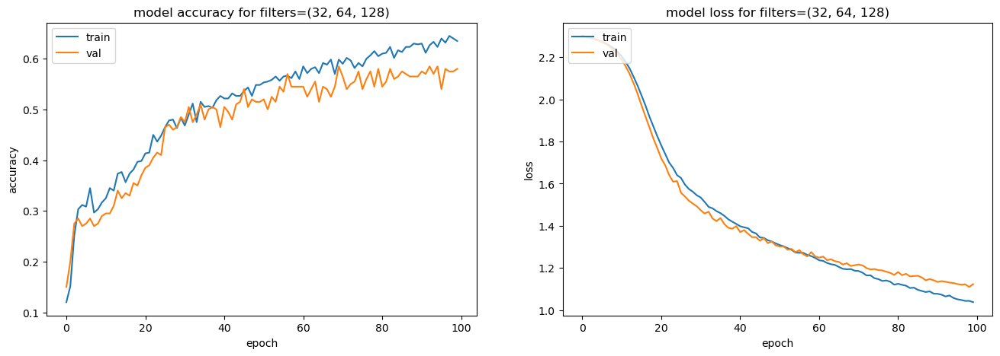

<Figure size 1600x500 with 0 Axes>

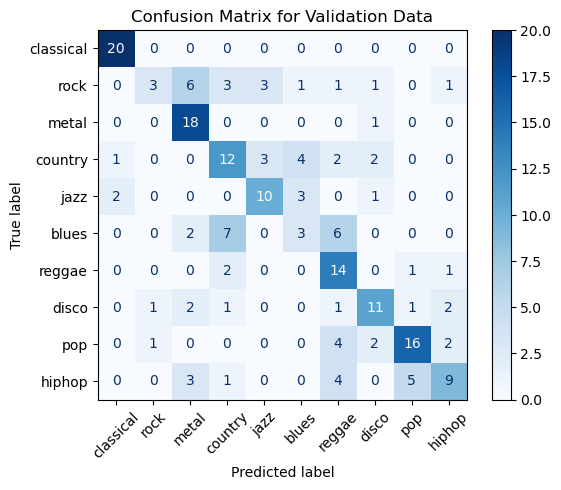

              precision    recall  f1-score   support

   classical       0.87      1.00      0.93        20
        rock       0.60      0.16      0.25        19
       metal       0.58      0.95      0.72        19
     country       0.46      0.50      0.48        24
        jazz       0.62      0.62      0.62        16
       blues       0.27      0.17      0.21        18
      reggae       0.44      0.78      0.56        18
       disco       0.61      0.58      0.59        19
         pop       0.70      0.64      0.67        25
      hiphop       0.60      0.41      0.49        22

    accuracy                           0.58       200
   macro avg       0.58      0.58      0.55       200
weighted avg       0.58      0.58      0.56       200

Best validation accuracy for filters=(64, 128, 256):  0.675000011920929
7/7 [==============================] - 0s 1ms/step


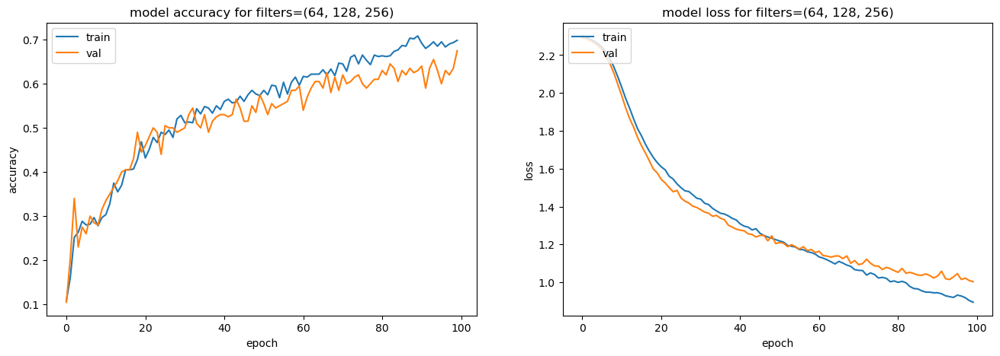

<Figure size 1600x500 with 0 Axes>

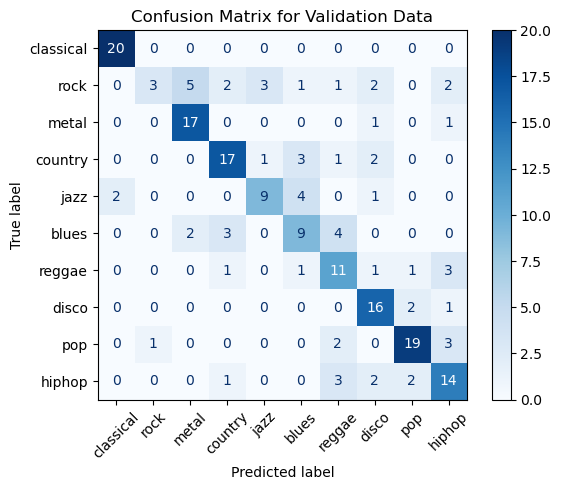

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.75      0.16      0.26        19
       metal       0.71      0.89      0.79        19
     country       0.71      0.71      0.71        24
        jazz       0.69      0.56      0.62        16
       blues       0.50      0.50      0.50        18
      reggae       0.50      0.61      0.55        18
       disco       0.64      0.84      0.73        19
         pop       0.79      0.76      0.78        25
      hiphop       0.58      0.64      0.61        22

    accuracy                           0.68       200
   macro avg       0.68      0.67      0.65       200
weighted avg       0.68      0.68      0.66       200

Filters : (32, 64, 128), Validation Accuracy: 0.5799999833106995
Filters : (64, 128, 256), Validation Accuracy: 0.675000011920929


In [190]:
results = {}

filters = [(32, 64, 128), (64, 128, 256)]

for filter in filters:
    model = create_model(filters=filter)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for filters={filter}: ', best_acc)
    
    results[filter] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for filters={filter}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for filters={filter}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title(f'Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for filter, result in results.items():
    print(f'Filters : {filter}, Validation Accuracy: {result[1]}')


==> better performances with (64, 128, 256)

In [191]:
# Define a function that creates your model
def create_model(filters, kernel_size=3):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], 1)))
    
    model.add(keras.layers.Conv1D(filters=filters[0], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[1], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[2], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

Best validation accuracy for kernel_size=2:  0.6449999809265137
7/7 [==============================] - 0s 1ms/step


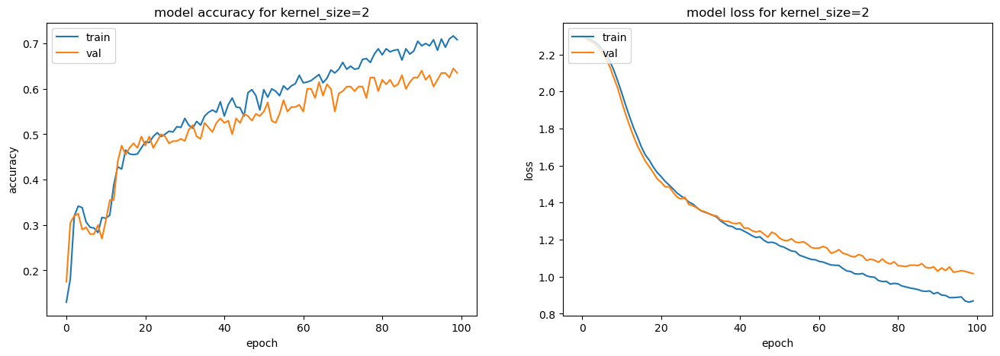

<Figure size 1600x500 with 0 Axes>

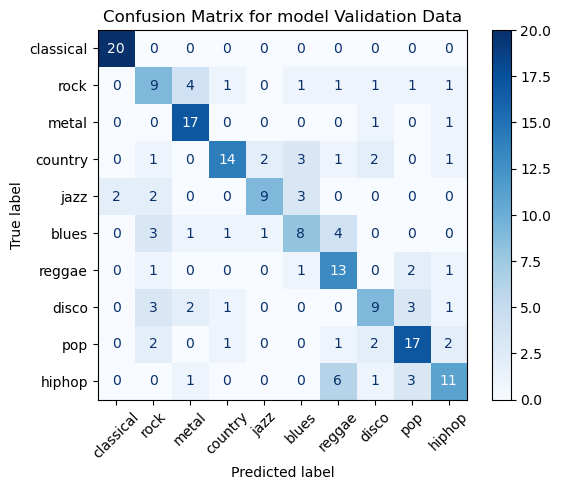

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.43      0.47      0.45        19
       metal       0.68      0.89      0.77        19
     country       0.78      0.58      0.67        24
        jazz       0.75      0.56      0.64        16
       blues       0.50      0.44      0.47        18
      reggae       0.50      0.72      0.59        18
       disco       0.56      0.47      0.51        19
         pop       0.65      0.68      0.67        25
      hiphop       0.61      0.50      0.55        22

    accuracy                           0.64       200
   macro avg       0.64      0.63      0.63       200
weighted avg       0.64      0.64      0.63       200

Best validation accuracy for kernel_size=3:  0.6549999713897705
7/7 [==============================] - 0s 1ms/step


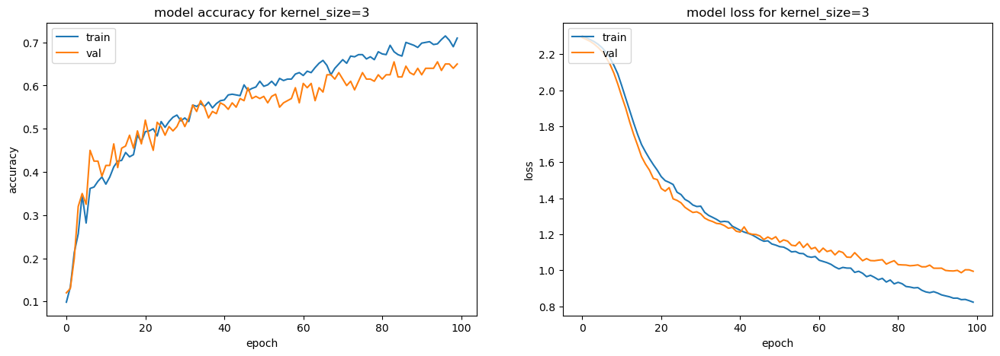

<Figure size 1600x500 with 0 Axes>

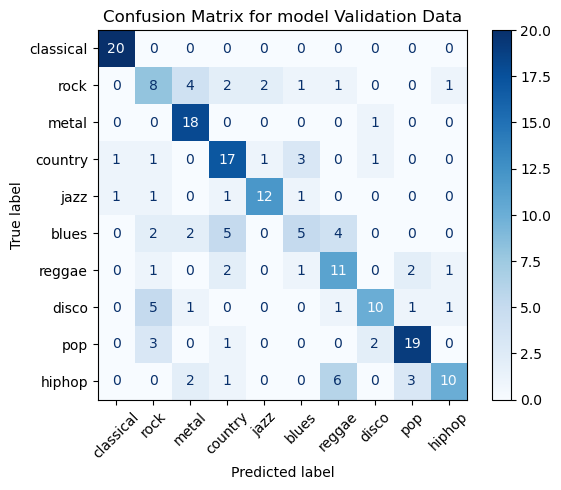

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.38      0.42      0.40        19
       metal       0.67      0.95      0.78        19
     country       0.59      0.71      0.64        24
        jazz       0.80      0.75      0.77        16
       blues       0.45      0.28      0.34        18
      reggae       0.48      0.61      0.54        18
       disco       0.71      0.53      0.61        19
         pop       0.76      0.76      0.76        25
      hiphop       0.77      0.45      0.57        22

    accuracy                           0.65       200
   macro avg       0.65      0.65      0.64       200
weighted avg       0.66      0.65      0.64       200

Best validation accuracy for kernel_size=5:  0.6299999952316284
7/7 [==============================] - 0s 1ms/step


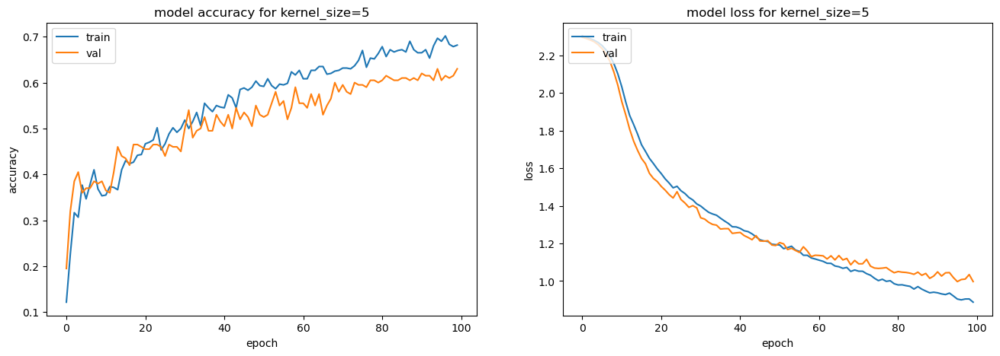

<Figure size 1600x500 with 0 Axes>

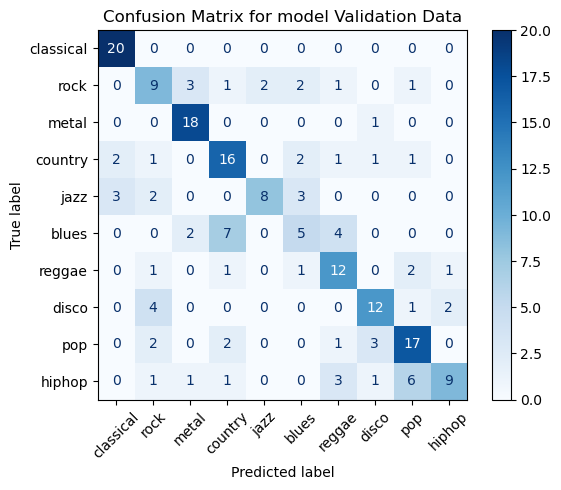

              precision    recall  f1-score   support

   classical       0.80      1.00      0.89        20
        rock       0.45      0.47      0.46        19
       metal       0.75      0.95      0.84        19
     country       0.57      0.67      0.62        24
        jazz       0.80      0.50      0.62        16
       blues       0.38      0.28      0.32        18
      reggae       0.55      0.67      0.60        18
       disco       0.67      0.63      0.65        19
         pop       0.61      0.68      0.64        25
      hiphop       0.75      0.41      0.53        22

    accuracy                           0.63       200
   macro avg       0.63      0.63      0.62       200
weighted avg       0.63      0.63      0.62       200

FKernel size : 2, Validation Accuracy: 0.6349999904632568
FKernel size : 3, Validation Accuracy: 0.6499999761581421
FKernel size : 5, Validation Accuracy: 0.6299999952316284


In [194]:
results = {}

filters = [64, 128, 256]
kernel_sizes = [2, 3, 5]

for kernel_size in kernel_sizes:
    model = create_model(filters=filters, kernel_size=kernel_size)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for kernel_size={kernel_size}: ', best_acc)
    
    results[kernel_size] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for kernel_size={kernel_size}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for kernel_size={kernel_size}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title(f'Confusion Matrix for model Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for kernel_size, result in results.items():
    print(f'FKernel size : {kernel_size}, Validation Accuracy: {result[1]}')

==> kernel_size = 3 is the best solution

In [195]:
# Define a function that creates your model
def create_model(filters, kernel_size, dropout_rate=0.1):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], 1)))
    
    model.add(keras.layers.Conv1D(filters=filters[0], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[1], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[2], kernel_size=kernel_size, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model


Best validation accuracy for dropout_rate=0.1:  0.5899999737739563
7/7 [==============================] - 0s 1ms/step


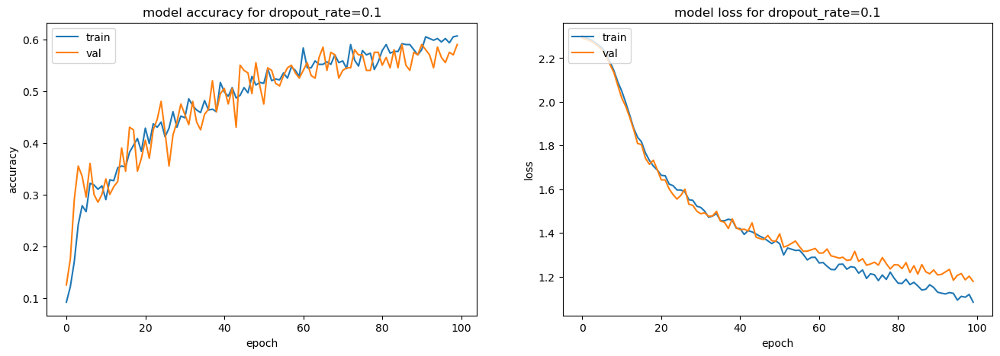

<Figure size 1600x500 with 0 Axes>

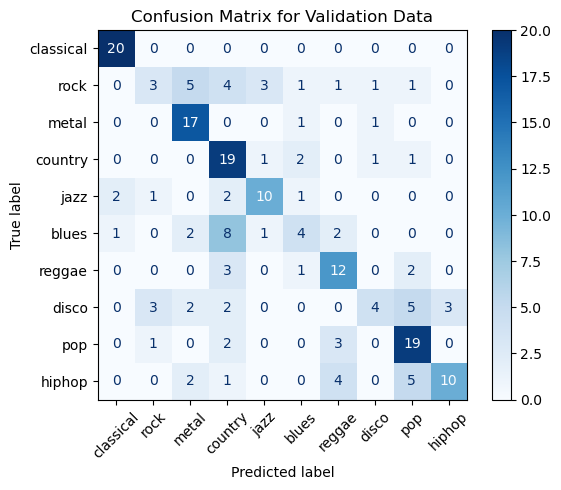

              precision    recall  f1-score   support

   classical       0.87      1.00      0.93        20
        rock       0.38      0.16      0.22        19
       metal       0.61      0.89      0.72        19
     country       0.46      0.79      0.58        24
        jazz       0.67      0.62      0.65        16
       blues       0.40      0.22      0.29        18
      reggae       0.55      0.67      0.60        18
       disco       0.57      0.21      0.31        19
         pop       0.58      0.76      0.66        25
      hiphop       0.77      0.45      0.57        22

    accuracy                           0.59       200
   macro avg       0.58      0.58      0.55       200
weighted avg       0.59      0.59      0.56       200

Best validation accuracy for dropout_rate=0.2:  0.574999988079071
7/7 [==============================] - 0s 1ms/step


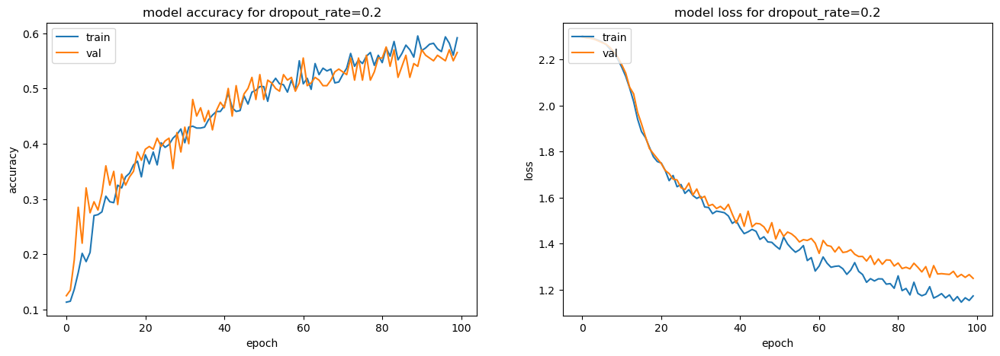

<Figure size 1600x500 with 0 Axes>

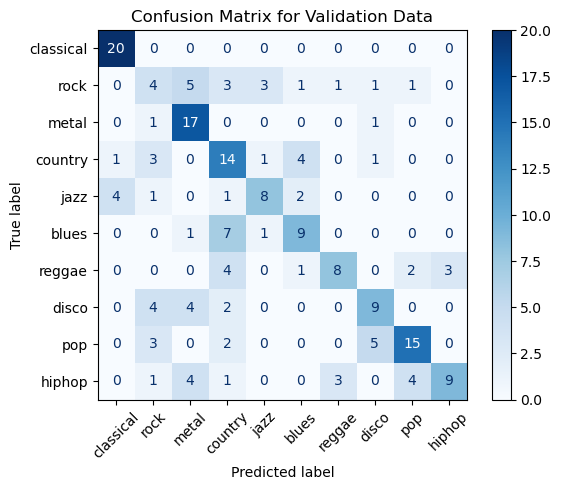

              precision    recall  f1-score   support

   classical       0.80      1.00      0.89        20
        rock       0.24      0.21      0.22        19
       metal       0.55      0.89      0.68        19
     country       0.41      0.58      0.48        24
        jazz       0.62      0.50      0.55        16
       blues       0.53      0.50      0.51        18
      reggae       0.67      0.44      0.53        18
       disco       0.53      0.47      0.50        19
         pop       0.68      0.60      0.64        25
      hiphop       0.75      0.41      0.53        22

    accuracy                           0.56       200
   macro avg       0.58      0.56      0.55       200
weighted avg       0.58      0.56      0.56       200

Best validation accuracy for dropout_rate=0.25:  0.574999988079071
7/7 [==============================] - 0s 1ms/step


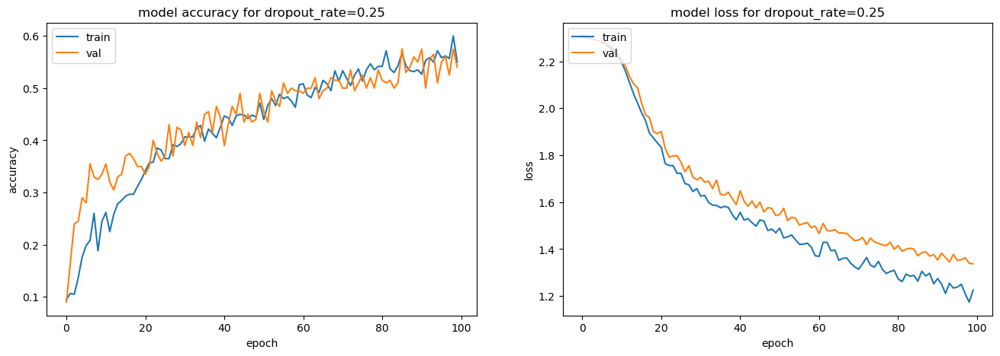

<Figure size 1600x500 with 0 Axes>

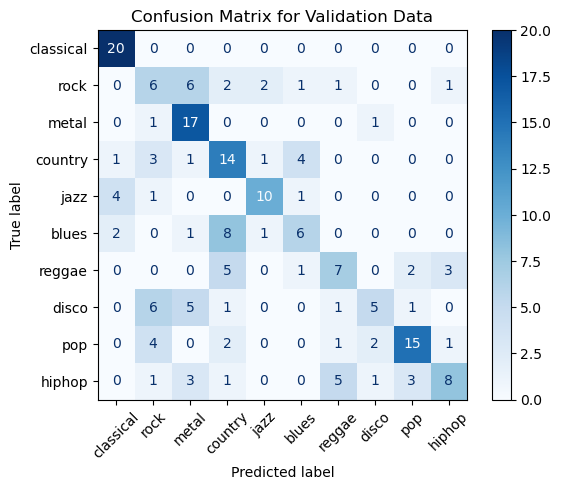

              precision    recall  f1-score   support

   classical       0.74      1.00      0.85        20
        rock       0.27      0.32      0.29        19
       metal       0.52      0.89      0.65        19
     country       0.42      0.58      0.49        24
        jazz       0.71      0.62      0.67        16
       blues       0.46      0.33      0.39        18
      reggae       0.47      0.39      0.42        18
       disco       0.56      0.26      0.36        19
         pop       0.71      0.60      0.65        25
      hiphop       0.62      0.36      0.46        22

    accuracy                           0.54       200
   macro avg       0.55      0.54      0.52       200
weighted avg       0.55      0.54      0.53       200

Best validation accuracy for dropout_rate=0.3:  0.5199999809265137
7/7 [==============================] - 0s 1ms/step


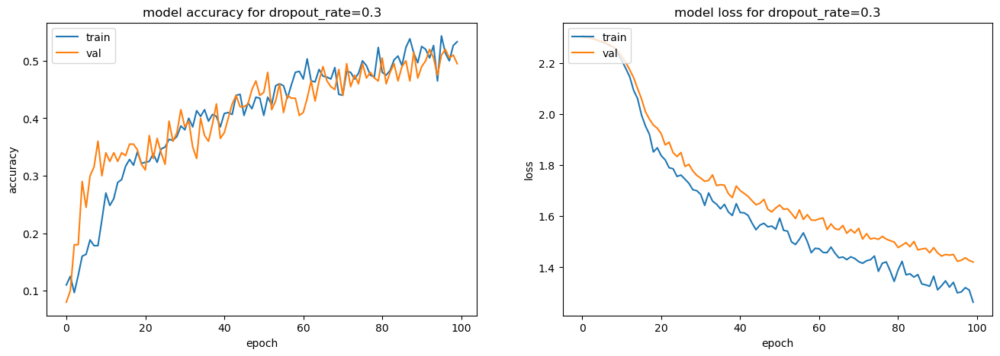

<Figure size 1600x500 with 0 Axes>

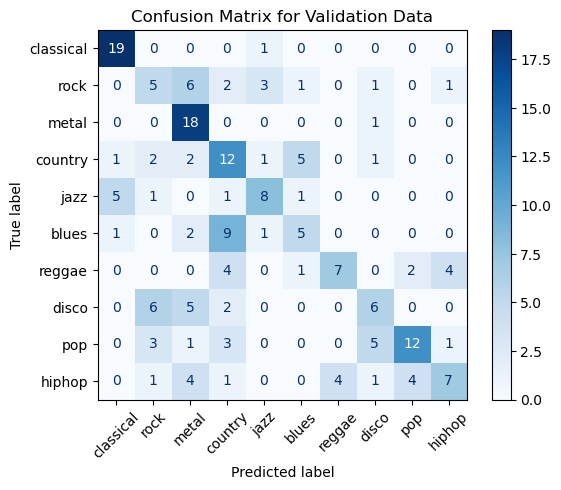

              precision    recall  f1-score   support

   classical       0.73      0.95      0.83        20
        rock       0.28      0.26      0.27        19
       metal       0.47      0.95      0.63        19
     country       0.35      0.50      0.41        24
        jazz       0.57      0.50      0.53        16
       blues       0.38      0.28      0.32        18
      reggae       0.64      0.39      0.48        18
       disco       0.40      0.32      0.35        19
         pop       0.67      0.48      0.56        25
      hiphop       0.54      0.32      0.40        22

    accuracy                           0.49       200
   macro avg       0.50      0.49      0.48       200
weighted avg       0.50      0.49      0.48       200

Best validation accuracy for dropout_rate=0.5:  0.4350000023841858
7/7 [==============================] - 0s 2ms/step


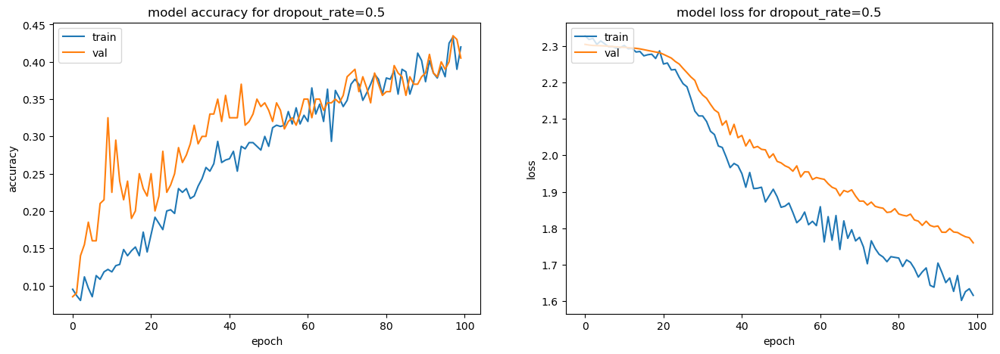

<Figure size 1600x500 with 0 Axes>

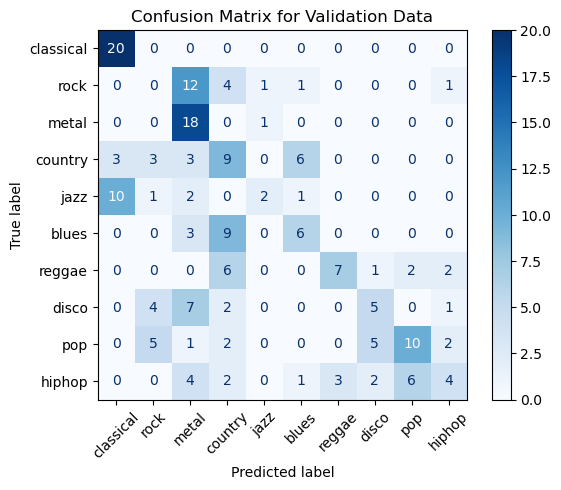

              precision    recall  f1-score   support

   classical       0.61      1.00      0.75        20
        rock       0.00      0.00      0.00        19
       metal       0.36      0.95      0.52        19
     country       0.26      0.38      0.31        24
        jazz       0.50      0.12      0.20        16
       blues       0.40      0.33      0.36        18
      reggae       0.70      0.39      0.50        18
       disco       0.38      0.26      0.31        19
         pop       0.56      0.40      0.47        25
      hiphop       0.40      0.18      0.25        22

    accuracy                           0.41       200
   macro avg       0.42      0.40      0.37       200
weighted avg       0.42      0.41      0.37       200

Dropout rate : 0.1, Validation Accuracy: 0.5899999737739563
Dropout rate : 0.2, Validation Accuracy: 0.5649999976158142
Dropout rate : 0.25, Validation Accuracy: 0.5400000214576721
Dropout rate : 0.3, Validation Accuracy: 0.4950000047683716


In [196]:
results = {}

filters = [64, 128, 256]
kernel_size = 3
dropout_rates = [0.1, 0.2, 0.25, 0.3, 0.5]

for dropout_rate in dropout_rates:
    model = create_model(filters=filters, kernel_size=kernel_size, dropout_rate=dropout_rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout_rate={dropout_rate}: ', best_acc)
    
    results[dropout_rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout_rate={dropout_rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout_rate={dropout_rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title(f'Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for dropout_rate, result in results.items():
    print(f'Dropout rate : {dropout_rate}, Validation Accuracy: {result[1]}')

==> The model does not seem to better perform, let's try to lighten the architecture

In [200]:
# Define a function that creates your model
def create_model(filters, kernel_size, dropout_rate=0.1):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], 1)))
    
    model.add(keras.layers.Conv1D(filters=filters[0], kernel_size=kernel_size, activation='relu'))
    #model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Conv1D(filters=filters[1], kernel_size=kernel_size, activation='relu'))
    #model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    #model.add(keras.layers.Conv1D(filters=filters[2], kernel_size=kernel_size, activation='relu'))
    #model.add(keras.layers.Dropout(dropout_rate))
    #model.add(keras.layers.MaxPooling1D(pool_size=2))
    
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

Best validation accuracy for dropout_rate=0.1:  0.625
7/7 [==============================] - 0s 1ms/step


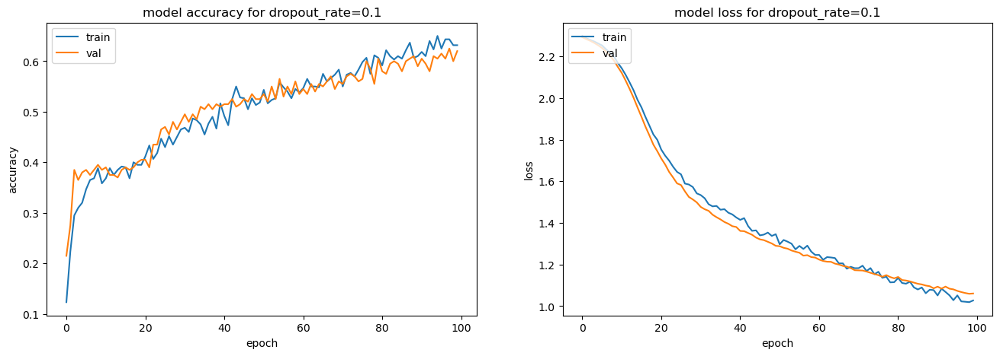

<Figure size 1600x500 with 0 Axes>

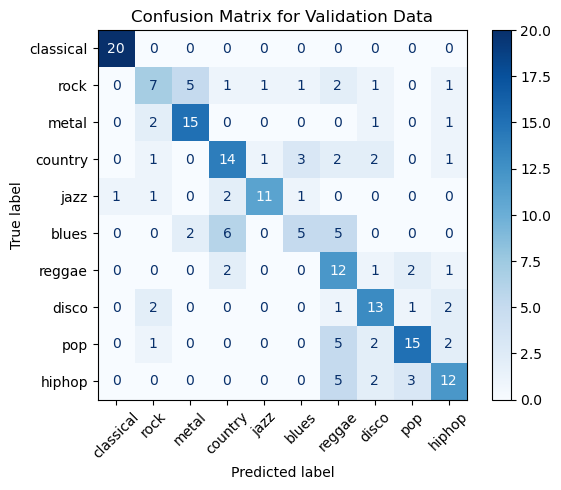

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.50      0.37      0.42        19
       metal       0.68      0.79      0.73        19
     country       0.56      0.58      0.57        24
        jazz       0.85      0.69      0.76        16
       blues       0.50      0.28      0.36        18
      reggae       0.38      0.67      0.48        18
       disco       0.59      0.68      0.63        19
         pop       0.71      0.60      0.65        25
      hiphop       0.60      0.55      0.57        22

    accuracy                           0.62       200
   macro avg       0.63      0.62      0.62       200
weighted avg       0.63      0.62      0.62       200

Best validation accuracy for dropout_rate=0.2:  0.6349999904632568
7/7 [==============================] - 0s 1ms/step


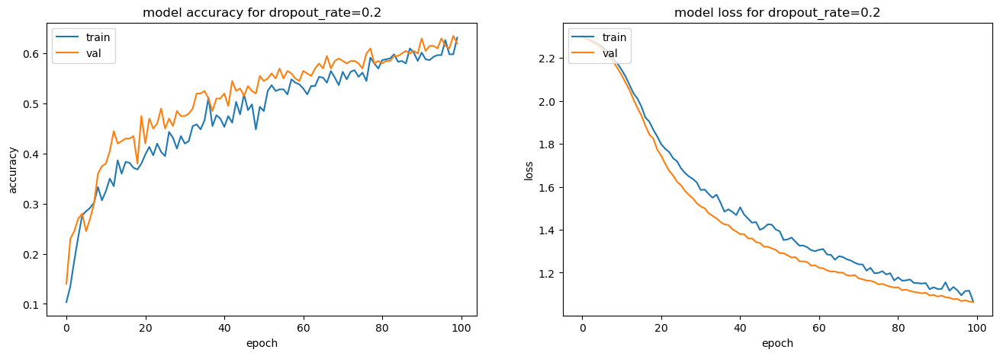

<Figure size 1600x500 with 0 Axes>

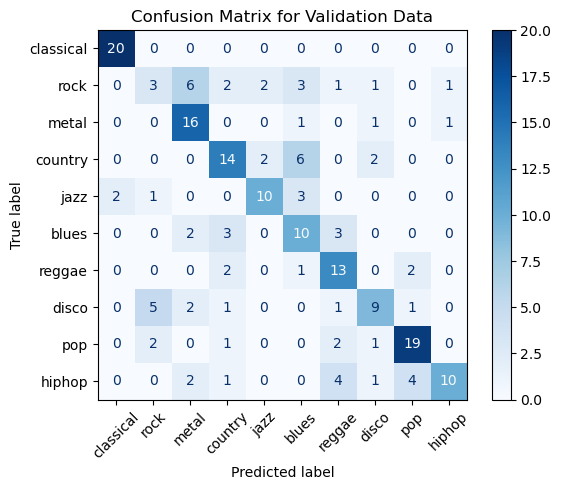

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.27      0.16      0.20        19
       metal       0.57      0.84      0.68        19
     country       0.58      0.58      0.58        24
        jazz       0.71      0.62      0.67        16
       blues       0.42      0.56      0.48        18
      reggae       0.54      0.72      0.62        18
       disco       0.60      0.47      0.53        19
         pop       0.73      0.76      0.75        25
      hiphop       0.83      0.45      0.59        22

    accuracy                           0.62       200
   macro avg       0.62      0.62      0.60       200
weighted avg       0.62      0.62      0.61       200

Best validation accuracy for dropout_rate=0.25:  0.6200000047683716
7/7 [==============================] - 0s 1ms/step


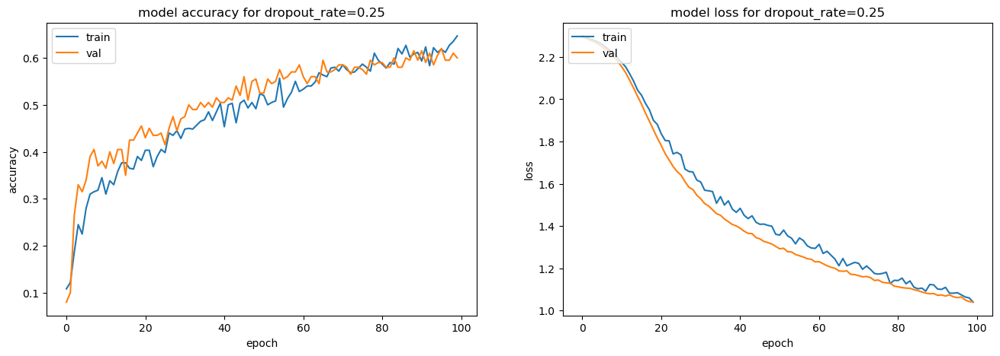

<Figure size 1600x500 with 0 Axes>

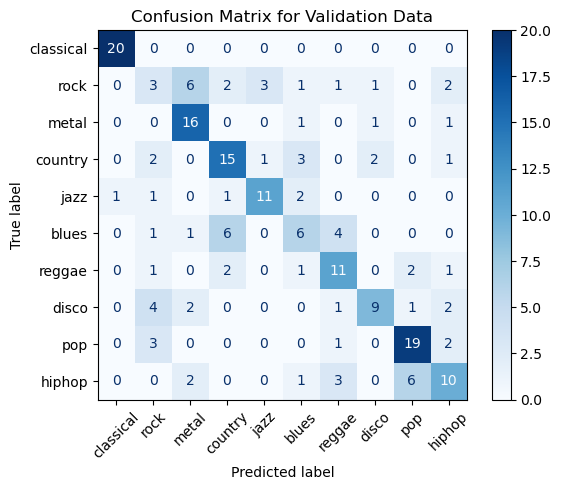

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.20      0.16      0.18        19
       metal       0.59      0.84      0.70        19
     country       0.58      0.62      0.60        24
        jazz       0.73      0.69      0.71        16
       blues       0.40      0.33      0.36        18
      reggae       0.52      0.61      0.56        18
       disco       0.69      0.47      0.56        19
         pop       0.68      0.76      0.72        25
      hiphop       0.53      0.45      0.49        22

    accuracy                           0.60       200
   macro avg       0.59      0.59      0.59       200
weighted avg       0.59      0.60      0.59       200

Best validation accuracy for dropout_rate=0.3:  0.6700000166893005
7/7 [==============================] - 0s 1ms/step


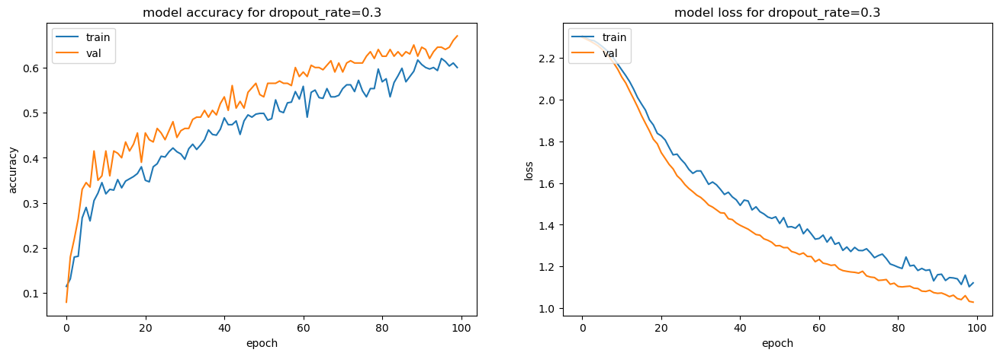

<Figure size 1600x500 with 0 Axes>

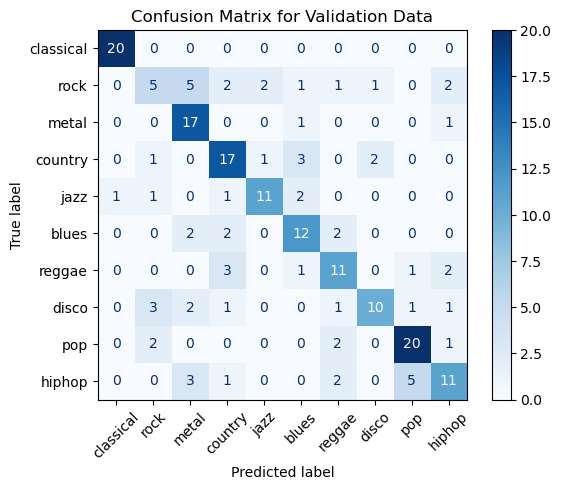

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.42      0.26      0.32        19
       metal       0.59      0.89      0.71        19
     country       0.63      0.71      0.67        24
        jazz       0.79      0.69      0.73        16
       blues       0.60      0.67      0.63        18
      reggae       0.58      0.61      0.59        18
       disco       0.77      0.53      0.62        19
         pop       0.74      0.80      0.77        25
      hiphop       0.61      0.50      0.55        22

    accuracy                           0.67       200
   macro avg       0.67      0.67      0.66       200
weighted avg       0.67      0.67      0.66       200

Best validation accuracy for dropout_rate=0.5:  0.6100000143051147
7/7 [==============================] - 0s 1ms/step


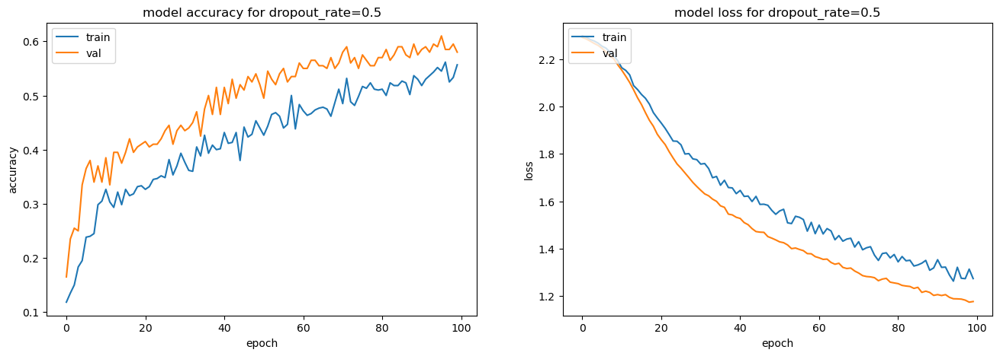

<Figure size 1600x500 with 0 Axes>

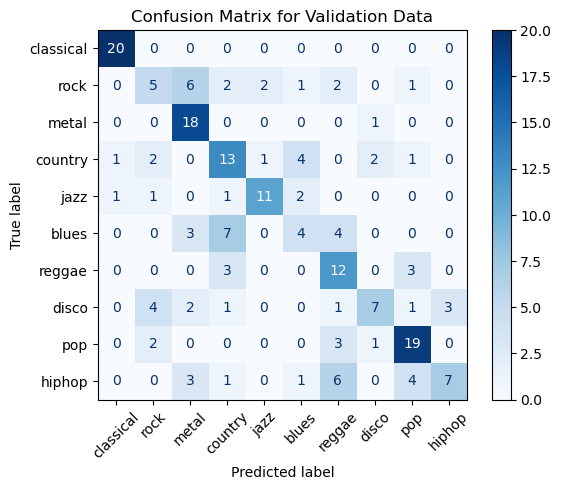

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.36      0.26      0.30        19
       metal       0.56      0.95      0.71        19
     country       0.46      0.54      0.50        24
        jazz       0.79      0.69      0.73        16
       blues       0.33      0.22      0.27        18
      reggae       0.43      0.67      0.52        18
       disco       0.64      0.37      0.47        19
         pop       0.66      0.76      0.70        25
      hiphop       0.70      0.32      0.44        22

    accuracy                           0.58       200
   macro avg       0.58      0.58      0.56       200
weighted avg       0.58      0.58      0.56       200

Dropout rate : 0.1, Validation Accuracy: 0.6200000047683716
Dropout rate : 0.2, Validation Accuracy: 0.6200000047683716
Dropout rate : 0.25, Validation Accuracy: 0.6000000238418579
Dropout rate : 0.3, Validation Accuracy: 0.6700000166893005


In [201]:
results = {}

filters = [64, 128, 256]
kernel_size = 3
dropout_rates = [0.1, 0.2, 0.25, 0.3, 0.5]

for dropout_rate in dropout_rates:
    model = create_model(filters=filters, kernel_size=kernel_size, dropout_rate=dropout_rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout_rate={dropout_rate}: ', best_acc)
    
    results[dropout_rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout_rate={dropout_rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout_rate={dropout_rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title(f'Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for dropout_rate, result in results.items():
    print(f'Dropout rate : {dropout_rate}, Validation Accuracy: {result[1]}')

==> The MLP model is much more performant than the CNN so the last one won't be kept!

**RNN**

***base model 1 :*** 

* LSTM layer
* 2 Dense (hidden) layers
* 1 Dense (output) layer

In [202]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))

model.add(keras.layers.LSTM(64))

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dense(32, activation='relu'))
          
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_55 (LSTM)              (None, 64)                31232     
                                                                 
 dense_333 (Dense)           (None, 64)                4160      
                                                                 
 dense_334 (Dense)           (None, 32)                2080      
                                                                 
 dense_335 (Dense)           (None, 10)                330       
                                                                 
Total params: 37802 (147.66 KB)
Trainable params: 37802 (147.66 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

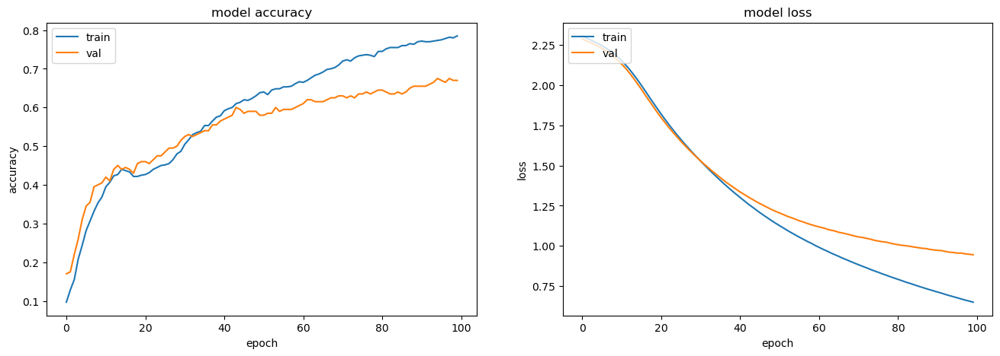

In [204]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [205]:
model_acc = model.evaluate(X_val_reshaped, y_val)
print('Overall model accuracy: ', model_acc[1])
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

7/7 [==============================] - 0s 1ms/step - loss: 0.9452 - accuracy: 0.6700
Overall model accuracy:  0.6700000166893005
Best validation accuracy:  0.675000011920929


7/7 [==============================] - 0s 1ms/step


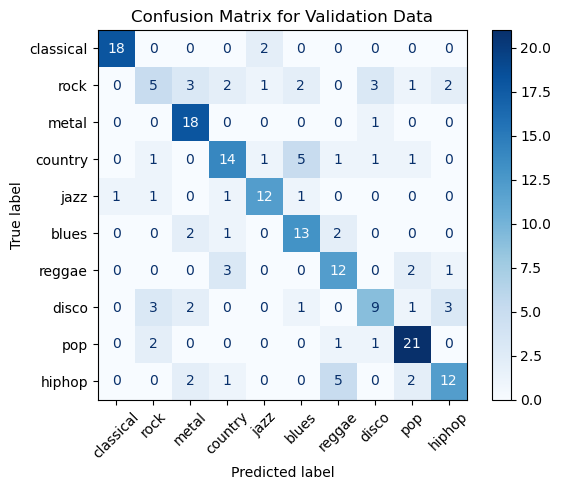

              precision    recall  f1-score   support

   classical       0.95      0.90      0.92        20
        rock       0.42      0.26      0.32        19
       metal       0.67      0.95      0.78        19
     country       0.64      0.58      0.61        24
        jazz       0.75      0.75      0.75        16
       blues       0.59      0.72      0.65        18
      reggae       0.57      0.67      0.62        18
       disco       0.60      0.47      0.53        19
         pop       0.75      0.84      0.79        25
      hiphop       0.67      0.55      0.60        22

    accuracy                           0.67       200
   macro avg       0.66      0.67      0.66       200
weighted avg       0.66      0.67      0.66       200



In [206]:
preds = np.argmax(model.predict(X_val_reshaped), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title(f'Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


***base model 2 :*** 

* Bidirectional LSTM layer
* 2 Dense (hidden) layers
* 1 Dense (output) layer

In [207]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))

forward_layer = keras.layers.LSTM(64)
backward_layer = keras.layers.LSTM(64, go_backwards=True)
model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))


model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dense(32, activation='relu'))
          
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_24 (Bidirect  (None, 128)               62464     
 ional)                                                          
                                                                 
 dense_336 (Dense)           (None, 64)                8256      
                                                                 
 dense_337 (Dense)           (None, 32)                2080      
                                                                 
 dense_338 (Dense)           (None, 10)                330       
                                                                 
Total params: 73130 (285.66 KB)
Trainable params: 73130 (285.66 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

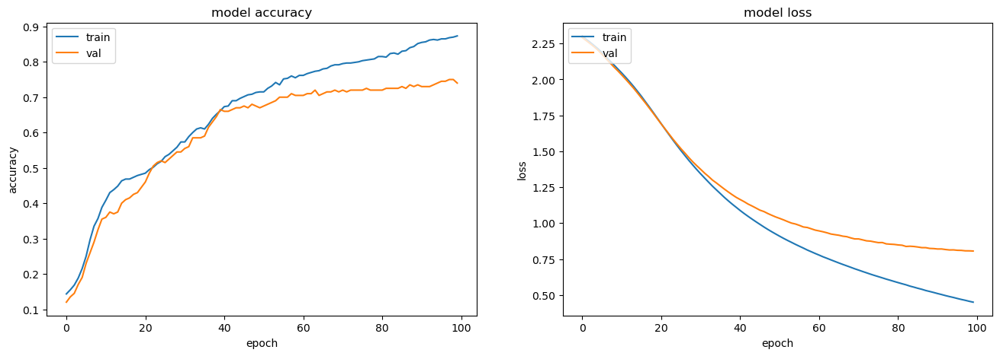

In [209]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [210]:
model_acc = model.evaluate(X_val_reshaped, y_val)
print('Overall model accuracy: ', model_acc[1])
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

7/7 [==============================] - 0s 1ms/step - loss: 0.8061 - accuracy: 0.7400
Overall model accuracy:  0.7400000095367432
Best validation accuracy:  0.75


7/7 [==============================] - 0s 1ms/step


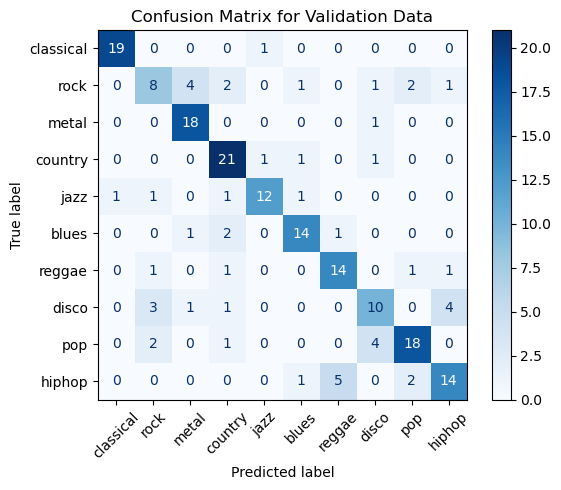

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.53      0.42      0.47        19
       metal       0.75      0.95      0.84        19
     country       0.72      0.88      0.79        24
        jazz       0.86      0.75      0.80        16
       blues       0.78      0.78      0.78        18
      reggae       0.70      0.78      0.74        18
       disco       0.59      0.53      0.56        19
         pop       0.78      0.72      0.75        25
      hiphop       0.70      0.64      0.67        22

    accuracy                           0.74       200
   macro avg       0.74      0.74      0.73       200
weighted avg       0.74      0.74      0.73       200



In [211]:
preds = np.argmax(model.predict(X_val_reshaped), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title(f'Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


***tuning the rnn model 1 :***

* batch normalization layers to stabilize and accelerate the training process
* dropout

In [ ]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))

model.add(keras.layers.LSTM(64))
model.add(keras.layers.BatchNormalization())

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.BatchNormalization())
model.add(keras.layers.Dense(32, activation='relu'))
model.add(keras.layers.BatchNormalization())
          
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

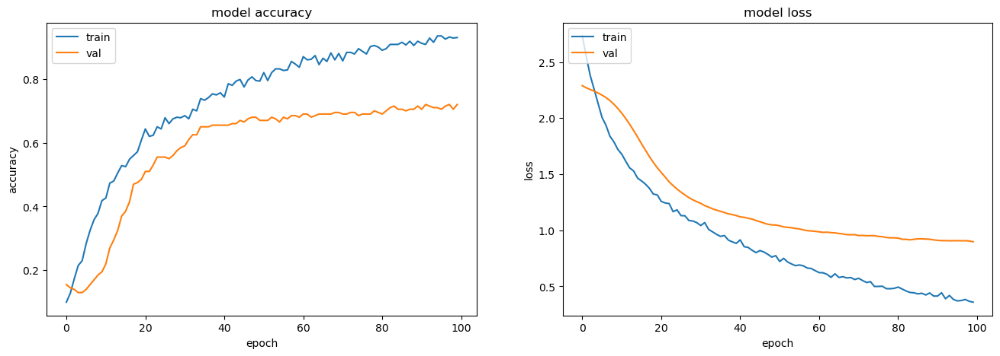

In [214]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [215]:
model_acc = model.evaluate(X_val_reshaped, y_val)
print('Overall model accuracy: ', model_acc[1])
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

7/7 [==============================] - 0s 1ms/step - loss: 0.8981 - accuracy: 0.7200
Overall model accuracy:  0.7200000286102295
Best validation accuracy:  0.7200000286102295


==> the model does seem to improve when adding some layers of BatchNormalization()

In [ ]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))

model.add(keras.layers.LSTM(64))
model.add(keras.layers.BatchNormalization())
model.add(keras.layers.Dropout(0.2))

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.BatchNormalization())
#model.add(keras.layers.Dropout(0.2))
model.add(keras.layers.Dense(32, activation='relu'))
model.add(keras.layers.BatchNormalization())
#model.add(keras.layers.Dropout(0.2))
          
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

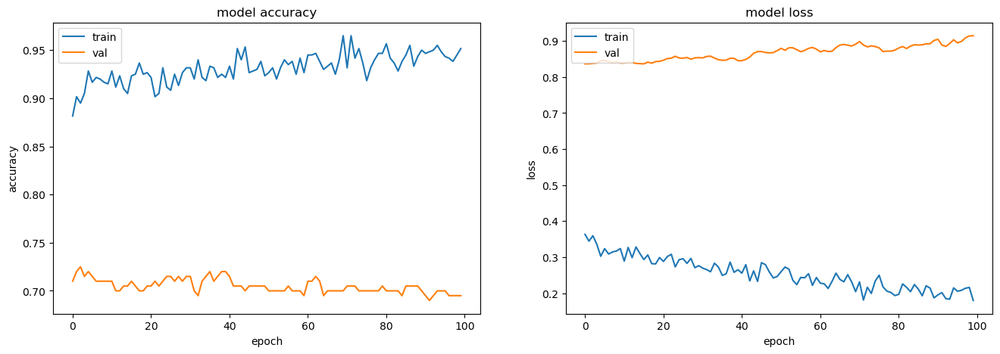

In [250]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [251]:
model_acc = model.evaluate(X_val_reshaped, y_val)
print('Overall model accuracy: ', model_acc[1])
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

7/7 [==============================] - 0s 1ms/step - loss: 0.9146 - accuracy: 0.6950
Overall model accuracy:  0.6949999928474426
Best validation accuracy:  0.7250000238418579


7/7 [==============================] - 0s 1ms/step


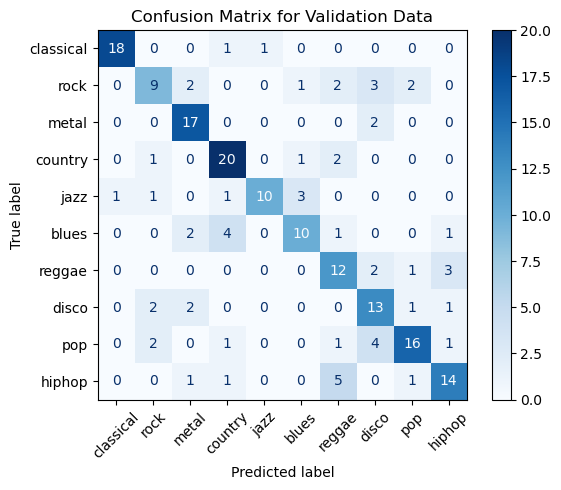

              precision    recall  f1-score   support

   classical       0.95      0.90      0.92        20
        rock       0.60      0.47      0.53        19
       metal       0.71      0.89      0.79        19
     country       0.71      0.83      0.77        24
        jazz       0.91      0.62      0.74        16
       blues       0.67      0.56      0.61        18
      reggae       0.52      0.67      0.59        18
       disco       0.54      0.68      0.60        19
         pop       0.76      0.64      0.70        25
      hiphop       0.70      0.64      0.67        22

    accuracy                           0.69       200
   macro avg       0.71      0.69      0.69       200
weighted avg       0.71      0.69      0.69       200



In [252]:
preds = np.argmax(model.predict(X_val_reshaped), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


==> still the model gets worse, conferming that a simpler model might be better

In [ ]:
# cutting off the batch normalization and leaving the model with the dropout layers


scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

model = keras.models.Sequential()
model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))

model.add(keras.layers.LSTM(64))
model.add(keras.layers.Dropout(0.2))

model.add(keras.layers.Dense(64, activation='relu'))
model.add(keras.layers.Dense(32, activation='relu'))
          
model.add(keras.layers.Dense(10, activation='softmax'))  

adamopt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model.summary()

In [ ]:
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100)

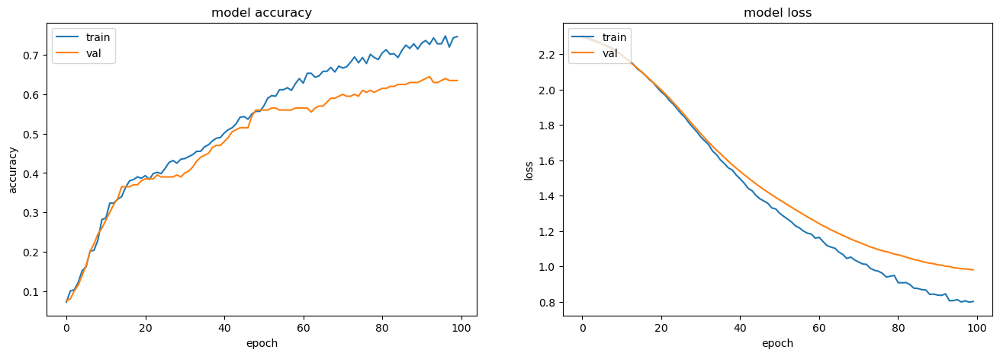

In [255]:
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

In [256]:
model_acc = model.evaluate(X_val_reshaped, y_val)
print('Overall model accuracy: ', model_acc[1])
best_acc = np.max(history.history['val_accuracy'])
print('Best validation accuracy: ', best_acc)

7/7 [==============================] - 0s 1ms/step - loss: 0.9803 - accuracy: 0.6350
Overall model accuracy:  0.6349999904632568
Best validation accuracy:  0.6449999809265137


7/7 [==============================] - 0s 1ms/step


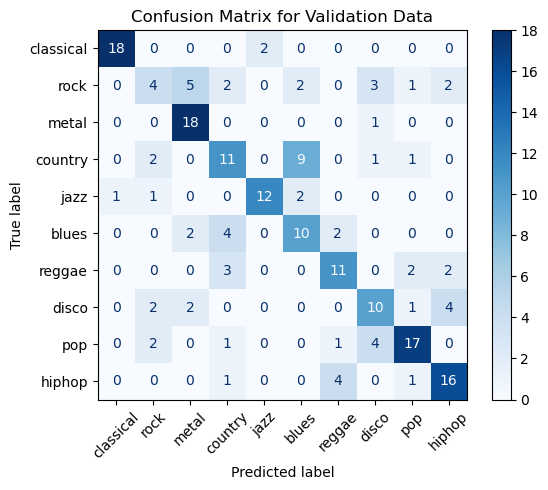

              precision    recall  f1-score   support

   classical       0.95      0.90      0.92        20
        rock       0.36      0.21      0.27        19
       metal       0.67      0.95      0.78        19
     country       0.50      0.46      0.48        24
        jazz       0.86      0.75      0.80        16
       blues       0.43      0.56      0.49        18
      reggae       0.61      0.61      0.61        18
       disco       0.53      0.53      0.53        19
         pop       0.74      0.68      0.71        25
      hiphop       0.67      0.73      0.70        22

    accuracy                           0.64       200
   macro avg       0.63      0.64      0.63       200
weighted avg       0.63      0.64      0.63       200



In [257]:
preds = np.argmax(model.predict(X_val_reshaped), axis=1)

cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


==> trying different values of regularization rate

In [258]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])


In [259]:
def create_model(regularization_rate=0.001):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    model.add(keras.layers.LSTM(64))
    model.add(keras.layers.Dropout(0.2))
    
    model.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

Best validation accuracy for regularization rate=0.001:  0.6549999713897705
7/7 [==============================] - 0s 1ms/step


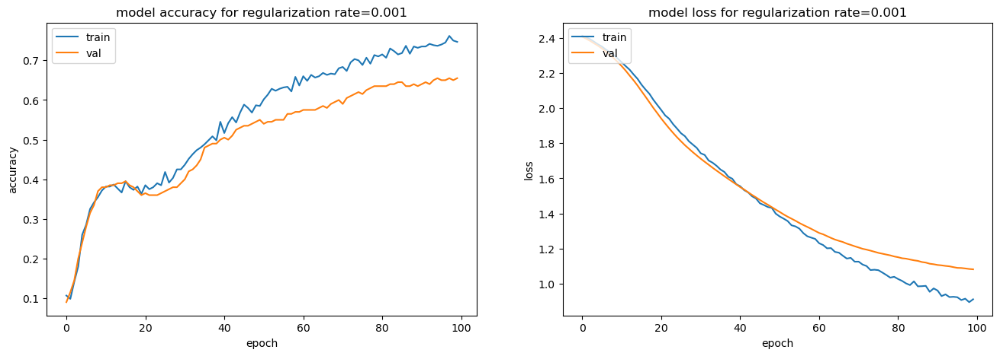

<Figure size 1600x500 with 0 Axes>

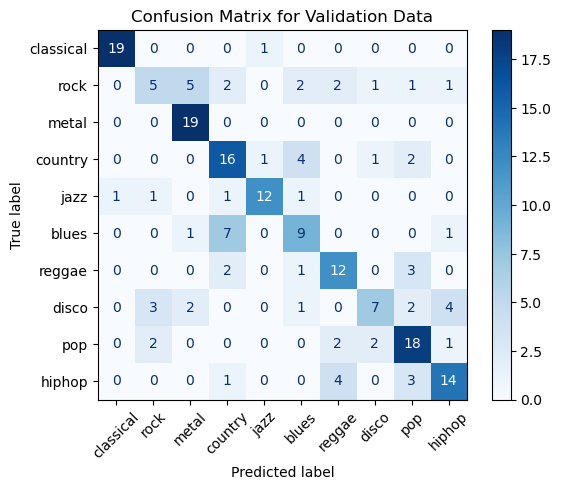

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.45      0.26      0.33        19
       metal       0.70      1.00      0.83        19
     country       0.55      0.67      0.60        24
        jazz       0.86      0.75      0.80        16
       blues       0.50      0.50      0.50        18
      reggae       0.60      0.67      0.63        18
       disco       0.64      0.37      0.47        19
         pop       0.62      0.72      0.67        25
      hiphop       0.67      0.64      0.65        22

    accuracy                           0.66       200
   macro avg       0.65      0.65      0.64       200
weighted avg       0.65      0.66      0.64       200

Best validation accuracy for regularization rate=0.01:  0.6449999809265137
7/7 [==============================] - 0s 1ms/step


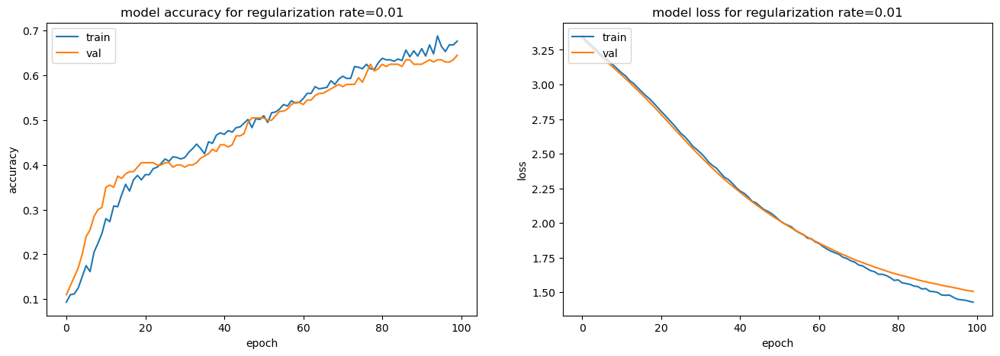

<Figure size 1600x500 with 0 Axes>

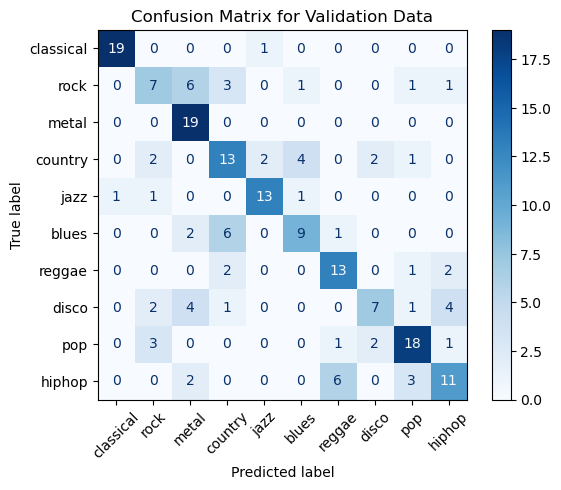

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.47      0.37      0.41        19
       metal       0.58      1.00      0.73        19
     country       0.52      0.54      0.53        24
        jazz       0.81      0.81      0.81        16
       blues       0.60      0.50      0.55        18
      reggae       0.62      0.72      0.67        18
       disco       0.64      0.37      0.47        19
         pop       0.72      0.72      0.72        25
      hiphop       0.58      0.50      0.54        22

    accuracy                           0.65       200
   macro avg       0.65      0.65      0.64       200
weighted avg       0.65      0.65      0.63       200

Best validation accuracy for regularization rate=0.1:  0.39500001072883606
7/7 [==============================] - 0s 1ms/step


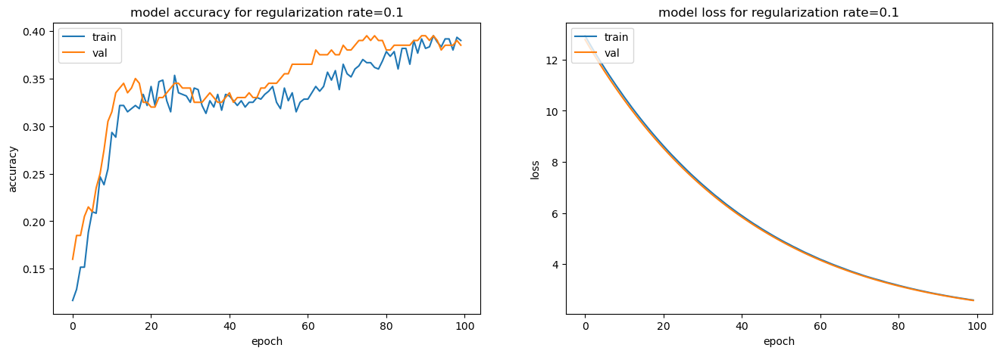

<Figure size 1600x500 with 0 Axes>

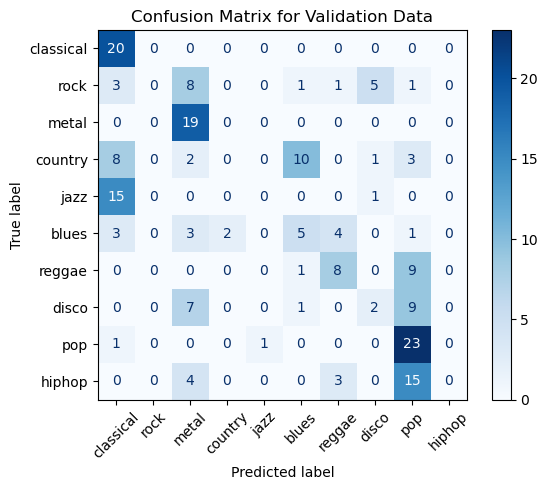

              precision    recall  f1-score   support

   classical       0.40      1.00      0.57        20
        rock       0.00      0.00      0.00        19
       metal       0.44      1.00      0.61        19
     country       0.00      0.00      0.00        24
        jazz       0.00      0.00      0.00        16
       blues       0.28      0.28      0.28        18
      reggae       0.50      0.44      0.47        18
       disco       0.22      0.11      0.14        19
         pop       0.38      0.92      0.53        25
      hiphop       0.00      0.00      0.00        22

    accuracy                           0.38       200
   macro avg       0.22      0.37      0.26       200
weighted avg       0.22      0.39      0.26       200

Regularization Rate: 0.001, Validation Accuracy: 0.6549999713897705
Regularization Rate: 0.01, Validation Accuracy: 0.6449999809265137
Regularization Rate: 0.1, Validation Accuracy: 0.38499999046325684


/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

In [261]:
# Define the list of regularization rates to test
regularization_rates = [0.001, 0.01, 0.1]

# Train models with different regularization rates
results = {}
for rate in regularization_rates:
    model = create_model(regularization_rate=rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for regularization rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for regularization rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for regularization rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Regularization Rate: {rate}, Validation Accuracy: {result[1]}')

***final RNN-1 model***

In [262]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])


In [263]:
def create_model():
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    model.add(keras.layers.LSTM(64))
    model.add(keras.layers.BatchNormalization())
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.Dense(32, activation='relu'))
    model.add(keras.layers.BatchNormalization())
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Best validation accuracy:  0.7300000190734863
7/7 [==============================] - 0s 1ms/step


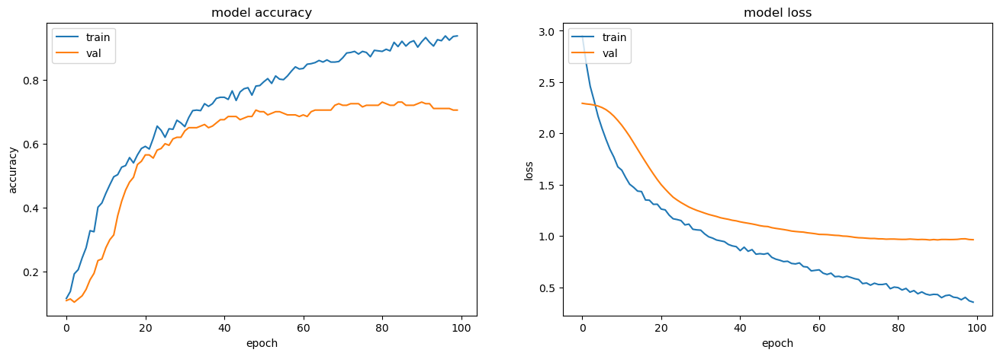

<Figure size 1600x500 with 0 Axes>

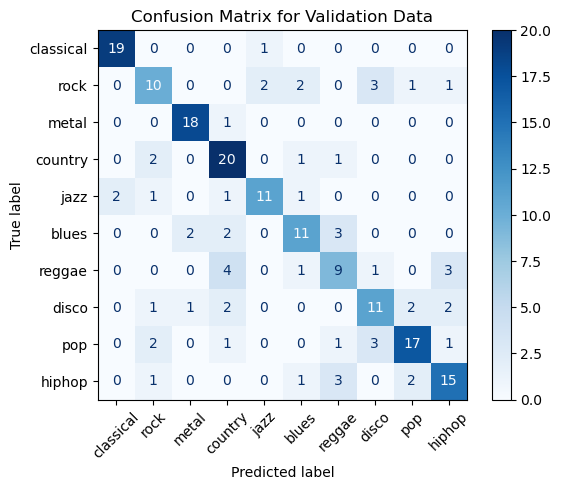

              precision    recall  f1-score   support

   classical       0.90      0.95      0.93        20
        rock       0.59      0.53      0.56        19
       metal       0.86      0.95      0.90        19
     country       0.65      0.83      0.73        24
        jazz       0.79      0.69      0.73        16
       blues       0.65      0.61      0.63        18
      reggae       0.53      0.50      0.51        18
       disco       0.61      0.58      0.59        19
         pop       0.77      0.68      0.72        25
      hiphop       0.68      0.68      0.68        22

    accuracy                           0.70       200
   macro avg       0.70      0.70      0.70       200
weighted avg       0.70      0.70      0.70       200



In [266]:
checkpoint = keras.callbacks.ModelCheckpoint(
    'rnn_model_1_{epoch:02d}_{val_accuracy:.3f}.h5',
    save_best_only=True,
    monitor='val_accuracy',
    mode='max'
)



model = create_model()
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                    batch_size=32, epochs=100, callbacks=[checkpoint], verbose=0)

best_acc = np.max(history.history['val_accuracy'])
print(f'Best validation accuracy: ', best_acc)

# Plotting accuracy and loss

plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')


preds = np.argmax(model.predict(X_val_reshaped), axis=1)


plt.figure(figsize=(16, 5))
cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))



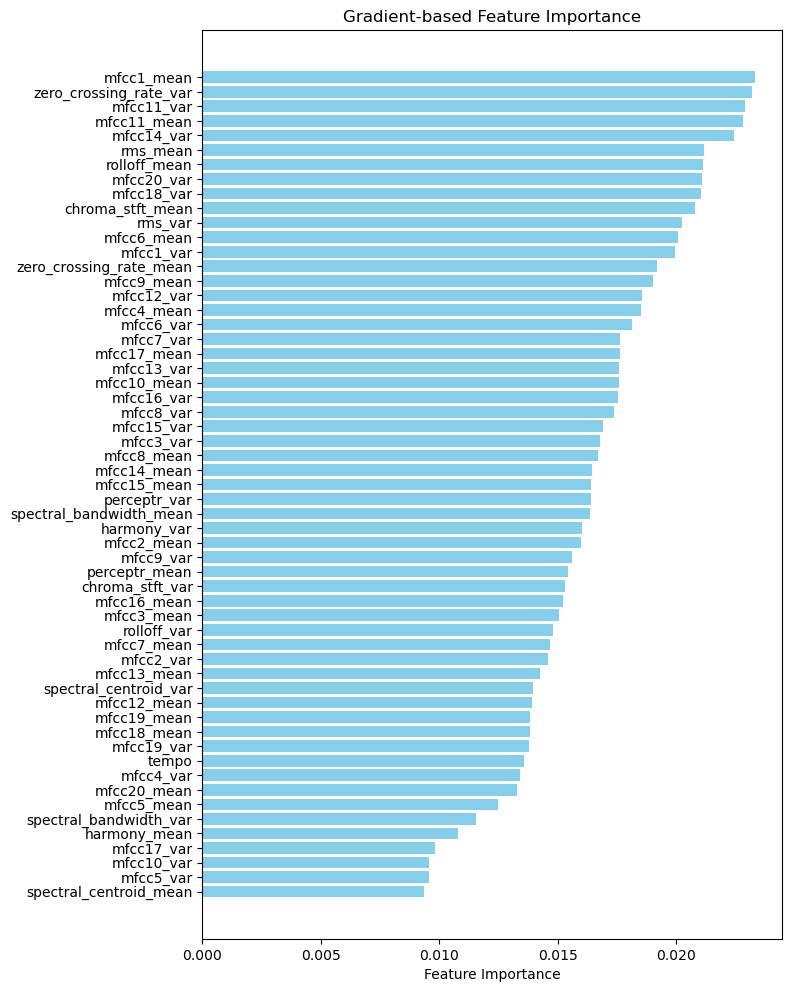

In [267]:
importance = feature_importance_gradient(model, X_val_reshaped)

importance = importance.flatten()

# Sort the indices by importance
sorted_indices = np.argsort(importance)
sorted_importance = importance[sorted_indices]
sorted_feature_names = [features[i] for i in sorted_indices]

# Plotting the feature importance
plt.figure(figsize=(8, 10)) 
plt.barh(range(len(sorted_importance)), sorted_importance, tick_label=sorted_feature_names, height=0.8, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Gradient-based Feature Importance')

plt.tight_layout(pad=1.0) 

plt.show()

***tuning the rnn model 2 :*** 

* L2 regularization
* dropout

*tuning the dropout rate of the LSTM layers*

In [268]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])

In [269]:
def create_model(dropout_rate=0.1):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64, dropout=dropout_rate, recurrent_dropout=dropout_rate)
    backward_layer = keras.layers.LSTM(64, go_backwards=True, dropout=dropout_rate, recurrent_dropout=dropout_rate)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dense(32, activation='relu'))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

Best validation accuracy for dropout rate=0.1:  0.7250000238418579
7/7 [==============================] - 0s 1ms/step


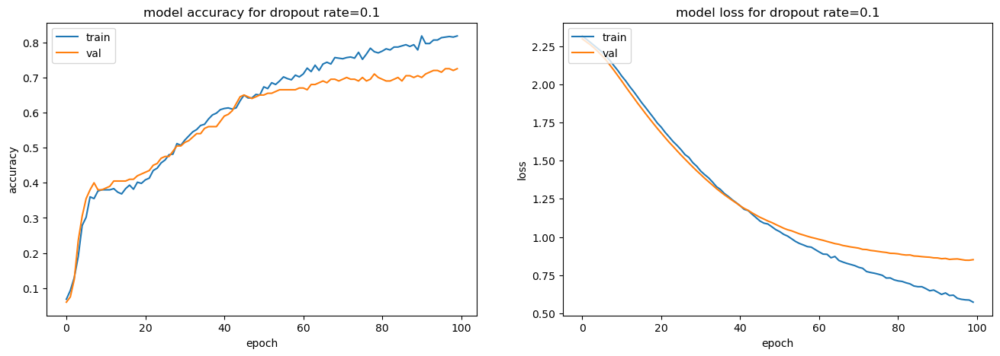

<Figure size 1600x500 with 0 Axes>

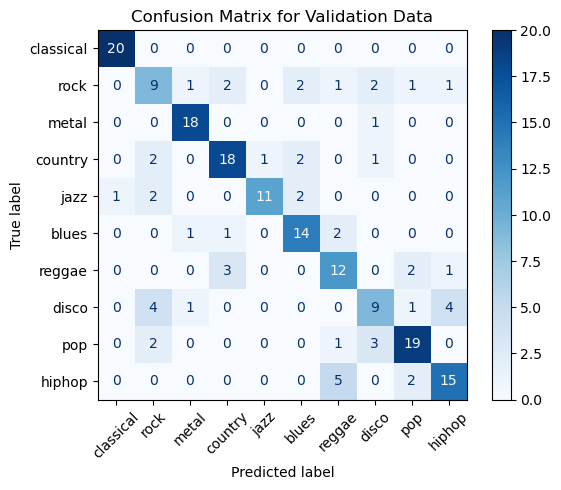

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.47      0.47      0.47        19
       metal       0.86      0.95      0.90        19
     country       0.75      0.75      0.75        24
        jazz       0.92      0.69      0.79        16
       blues       0.70      0.78      0.74        18
      reggae       0.57      0.67      0.62        18
       disco       0.56      0.47      0.51        19
         pop       0.76      0.76      0.76        25
      hiphop       0.71      0.68      0.70        22

    accuracy                           0.73       200
   macro avg       0.73      0.72      0.72       200
weighted avg       0.73      0.72      0.72       200

Best validation accuracy for dropout rate=0.2:  0.7049999833106995
7/7 [==============================] - 0s 1ms/step


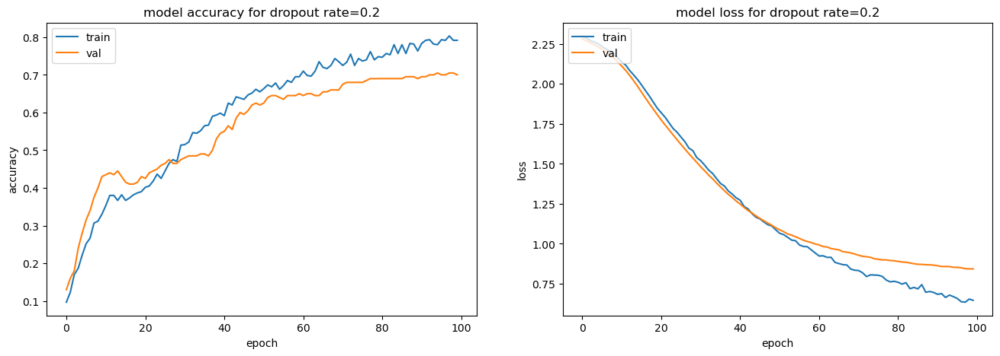

<Figure size 1600x500 with 0 Axes>

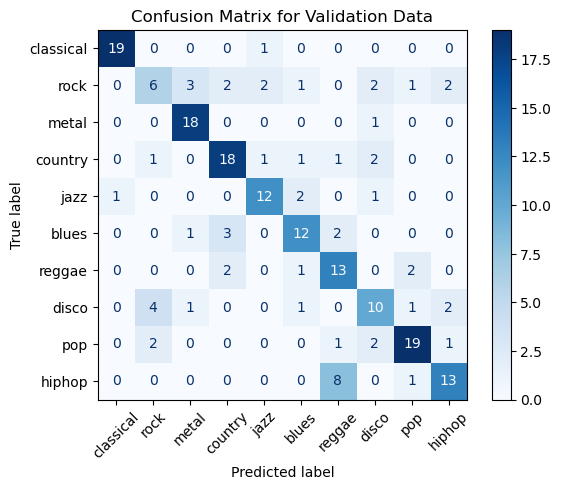

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.46      0.32      0.37        19
       metal       0.78      0.95      0.86        19
     country       0.72      0.75      0.73        24
        jazz       0.75      0.75      0.75        16
       blues       0.67      0.67      0.67        18
      reggae       0.52      0.72      0.60        18
       disco       0.56      0.53      0.54        19
         pop       0.79      0.76      0.78        25
      hiphop       0.72      0.59      0.65        22

    accuracy                           0.70       200
   macro avg       0.69      0.70      0.69       200
weighted avg       0.70      0.70      0.69       200

Best validation accuracy for dropout rate=0.3:  0.6949999928474426
7/7 [==============================] - 0s 1ms/step


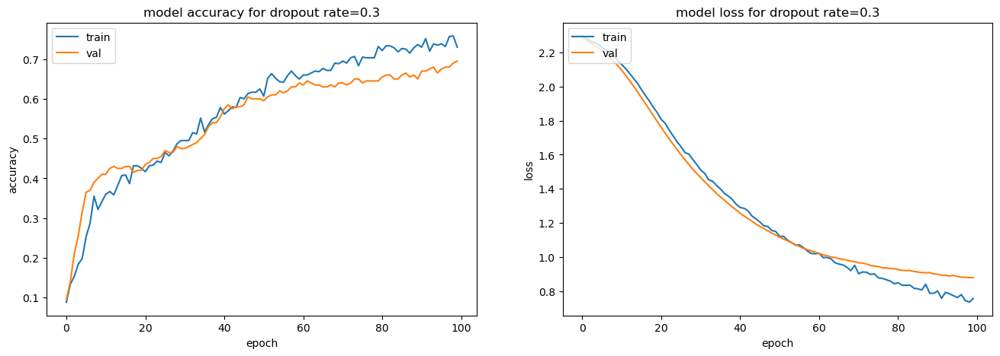

<Figure size 1600x500 with 0 Axes>

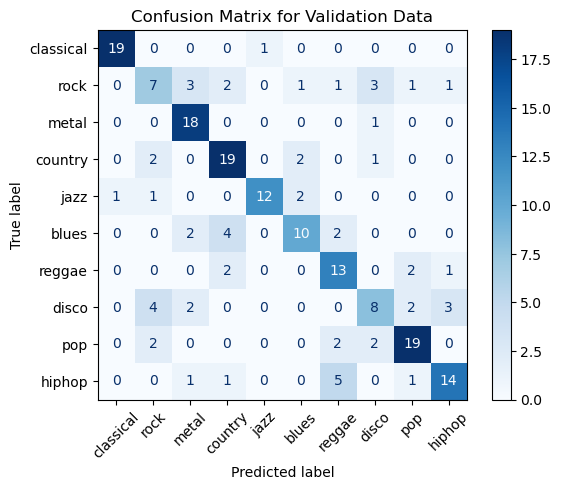

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.44      0.37      0.40        19
       metal       0.69      0.95      0.80        19
     country       0.68      0.79      0.73        24
        jazz       0.92      0.75      0.83        16
       blues       0.67      0.56      0.61        18
      reggae       0.57      0.72      0.63        18
       disco       0.53      0.42      0.47        19
         pop       0.76      0.76      0.76        25
      hiphop       0.74      0.64      0.68        22

    accuracy                           0.69       200
   macro avg       0.69      0.69      0.69       200
weighted avg       0.70      0.69      0.69       200

Best validation accuracy for dropout rate=0.4:  0.6949999928474426
7/7 [==============================] - 0s 1ms/step


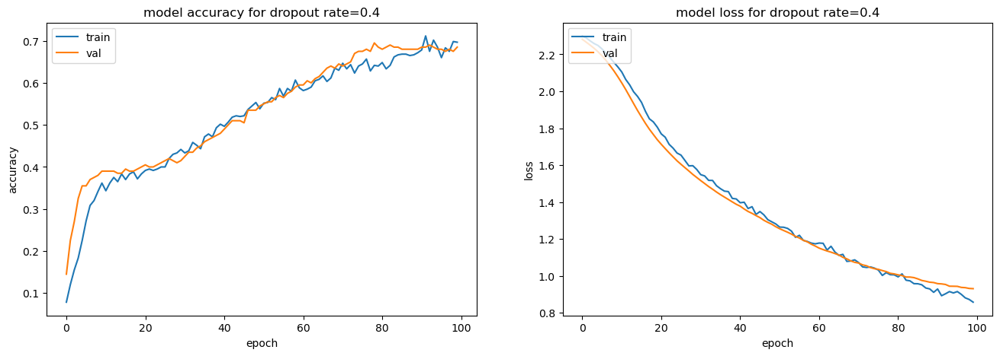

<Figure size 1600x500 with 0 Axes>

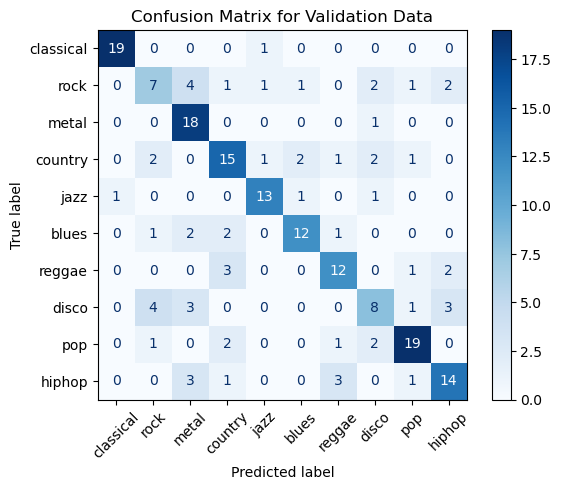

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.47      0.37      0.41        19
       metal       0.60      0.95      0.73        19
     country       0.62      0.62      0.62        24
        jazz       0.81      0.81      0.81        16
       blues       0.75      0.67      0.71        18
      reggae       0.67      0.67      0.67        18
       disco       0.50      0.42      0.46        19
         pop       0.79      0.76      0.78        25
      hiphop       0.67      0.64      0.65        22

    accuracy                           0.69       200
   macro avg       0.68      0.69      0.68       200
weighted avg       0.68      0.69      0.68       200

Best validation accuracy for dropout rate=0.5:  0.6299999952316284
7/7 [==============================] - 0s 1ms/step


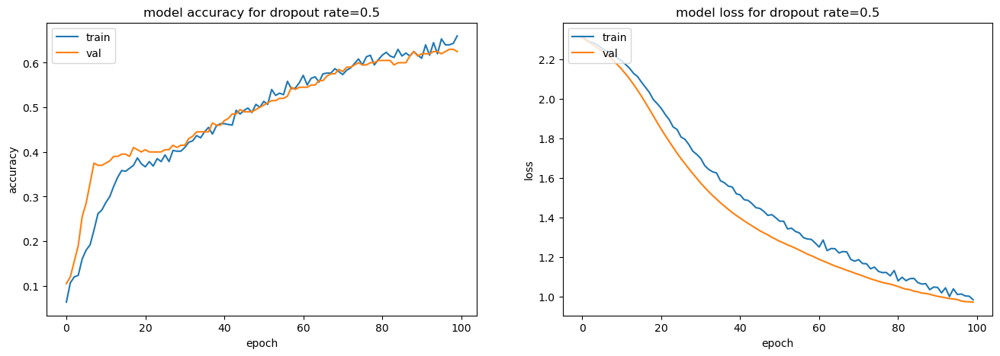

<Figure size 1600x500 with 0 Axes>

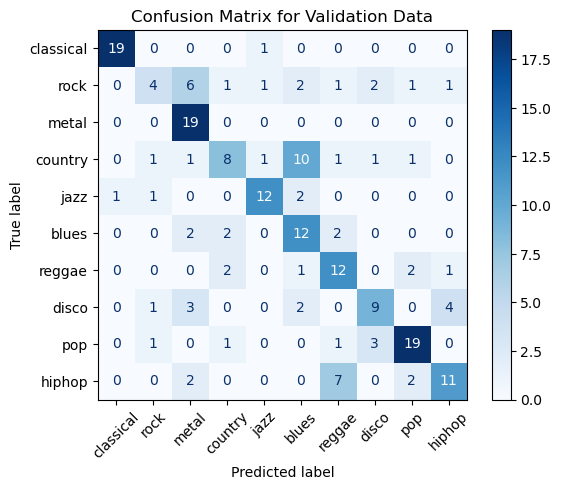

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.50      0.21      0.30        19
       metal       0.58      1.00      0.73        19
     country       0.57      0.33      0.42        24
        jazz       0.80      0.75      0.77        16
       blues       0.41      0.67      0.51        18
      reggae       0.50      0.67      0.57        18
       disco       0.60      0.47      0.53        19
         pop       0.76      0.76      0.76        25
      hiphop       0.65      0.50      0.56        22

    accuracy                           0.62       200
   macro avg       0.63      0.63      0.61       200
weighted avg       0.64      0.62      0.61       200

Best validation accuracy for dropout rate=0.6:  0.6200000047683716
7/7 [==============================] - 0s 1ms/step


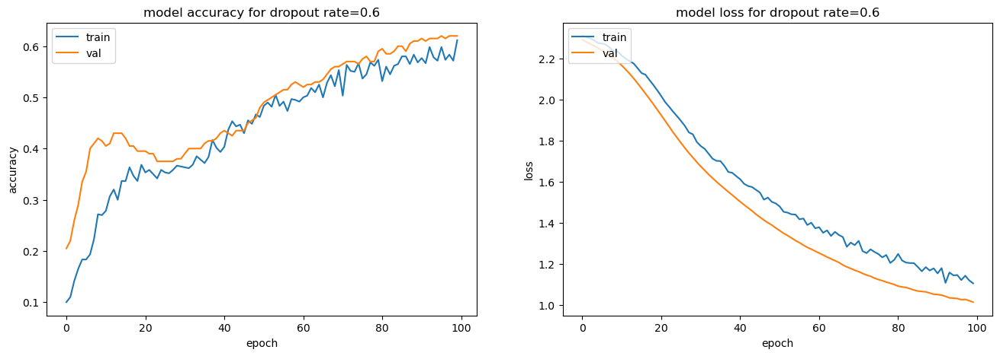

<Figure size 1600x500 with 0 Axes>

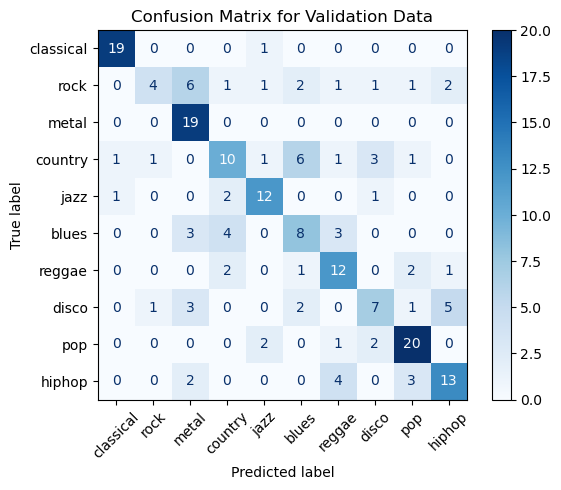

              precision    recall  f1-score   support

   classical       0.90      0.95      0.93        20
        rock       0.67      0.21      0.32        19
       metal       0.58      1.00      0.73        19
     country       0.53      0.42      0.47        24
        jazz       0.71      0.75      0.73        16
       blues       0.42      0.44      0.43        18
      reggae       0.55      0.67      0.60        18
       disco       0.50      0.37      0.42        19
         pop       0.71      0.80      0.75        25
      hiphop       0.62      0.59      0.60        22

    accuracy                           0.62       200
   macro avg       0.62      0.62      0.60       200
weighted avg       0.62      0.62      0.60       200

Dropout Rate: 0.1, Validation Accuracy: 0.7250000238418579
Dropout Rate: 0.2, Validation Accuracy: 0.699999988079071
Dropout Rate: 0.3, Validation Accuracy: 0.6949999928474426
Dropout Rate: 0.4, Validation Accuracy: 0.6850000023841858
Dropou

In [273]:
# Define the list of dropout rates to test
dropout_rates =  [0.1, 0.2, 0.3, 0.4, 0.5, 0.6]

results = {}
for rate in dropout_rates:
    model = create_model(dropout_rate=rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Dropout Rate: {rate}, Validation Accuracy: {result[1]}')


==> dropout rate = 0.1 provides the best results, but it does not improve the accuracy

*tuning the regularization rate : L2 regularizer*

In [274]:
def create_model(lstm_dropout_rate, regularization_rate=0.01):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    backward_layer = keras.layers.LSTM(64, go_backwards=True, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    
    
    model.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
    model.add(keras.layers.Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l2(regularization_rate)))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

Best validation accuracy for regularization rate=1e-05:  0.7200000286102295
7/7 [==============================] - 0s 1ms/step


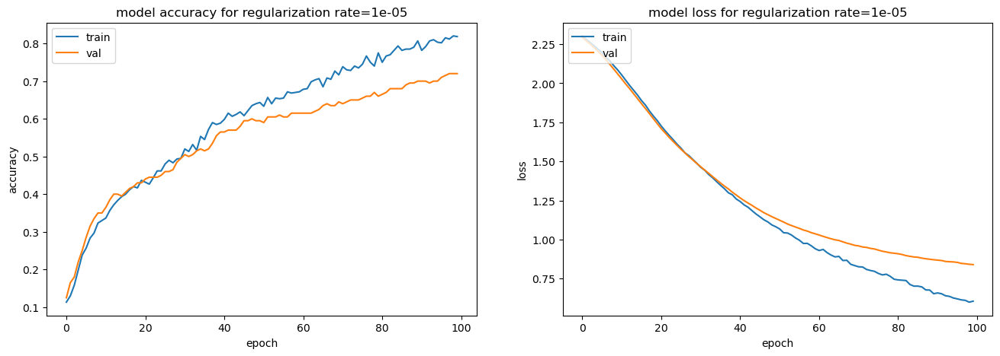

<Figure size 1600x500 with 0 Axes>

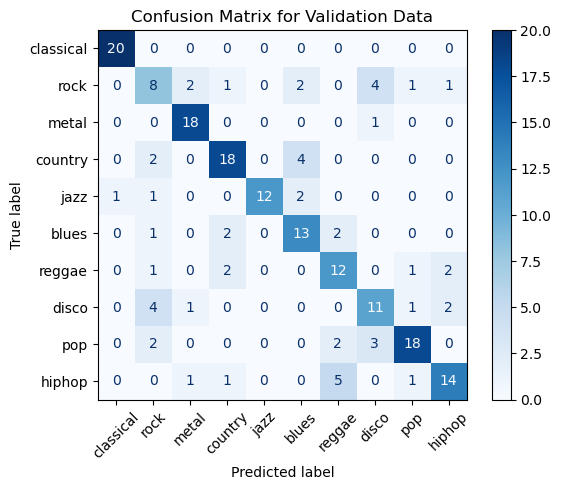

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.42      0.42      0.42        19
       metal       0.82      0.95      0.88        19
     country       0.75      0.75      0.75        24
        jazz       1.00      0.75      0.86        16
       blues       0.62      0.72      0.67        18
      reggae       0.57      0.67      0.62        18
       disco       0.58      0.58      0.58        19
         pop       0.82      0.72      0.77        25
      hiphop       0.74      0.64      0.68        22

    accuracy                           0.72       200
   macro avg       0.73      0.72      0.72       200
weighted avg       0.73      0.72      0.72       200

Best validation accuracy for regularization rate=0.0001:  0.7200000286102295
7/7 [==============================] - 0s 1ms/step


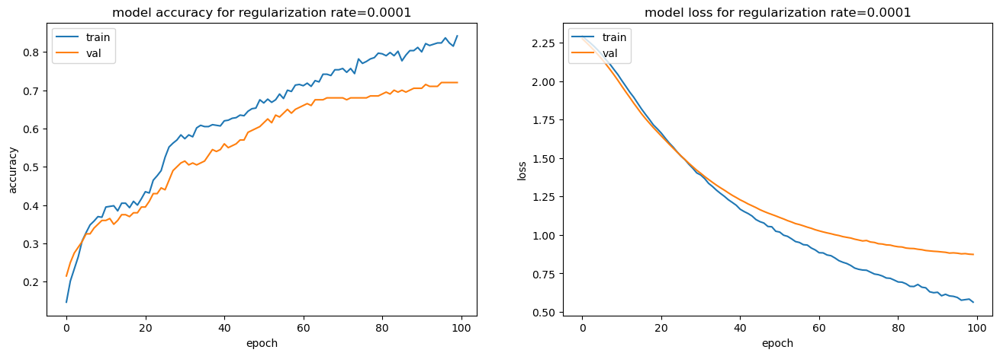

<Figure size 1600x500 with 0 Axes>

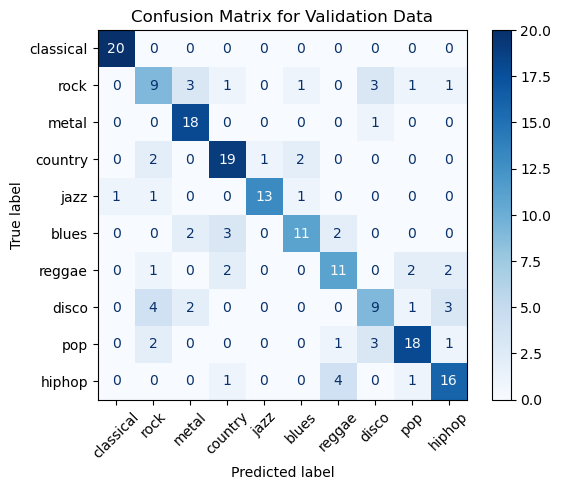

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.47      0.47      0.47        19
       metal       0.72      0.95      0.82        19
     country       0.73      0.79      0.76        24
        jazz       0.93      0.81      0.87        16
       blues       0.73      0.61      0.67        18
      reggae       0.61      0.61      0.61        18
       disco       0.56      0.47      0.51        19
         pop       0.78      0.72      0.75        25
      hiphop       0.70      0.73      0.71        22

    accuracy                           0.72       200
   macro avg       0.72      0.72      0.71       200
weighted avg       0.72      0.72      0.72       200

Best validation accuracy for regularization rate=0.001:  0.699999988079071
7/7 [==============================] - 0s 1ms/step


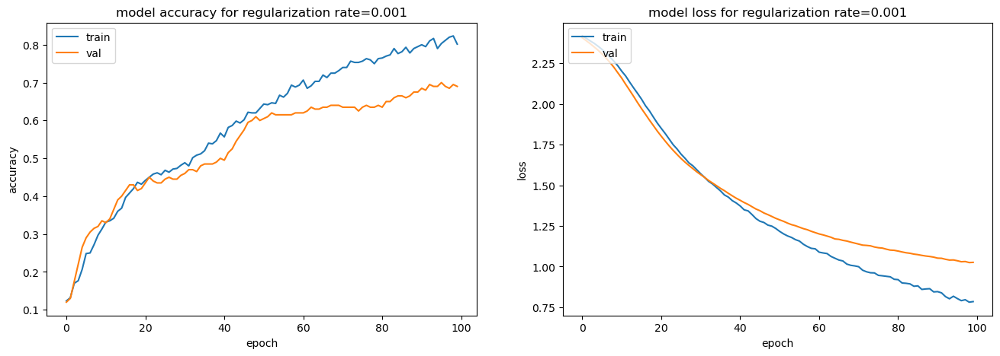

<Figure size 1600x500 with 0 Axes>

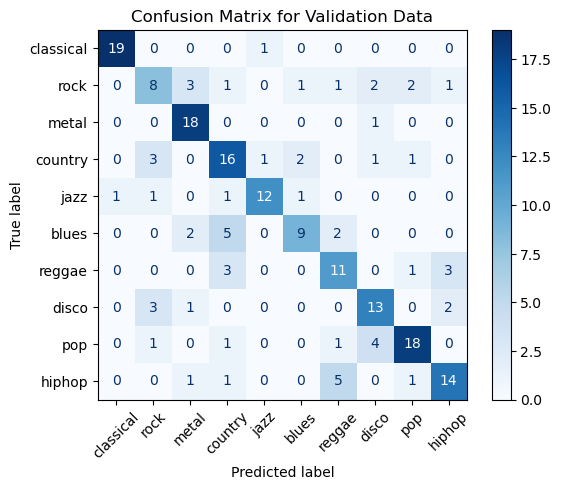

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.50      0.42      0.46        19
       metal       0.72      0.95      0.82        19
     country       0.57      0.67      0.62        24
        jazz       0.86      0.75      0.80        16
       blues       0.69      0.50      0.58        18
      reggae       0.55      0.61      0.58        18
       disco       0.62      0.68      0.65        19
         pop       0.78      0.72      0.75        25
      hiphop       0.70      0.64      0.67        22

    accuracy                           0.69       200
   macro avg       0.69      0.69      0.69       200
weighted avg       0.69      0.69      0.69       200

Best validation accuracy for regularization rate=0.01:  0.6800000071525574
7/7 [==============================] - 0s 1ms/step


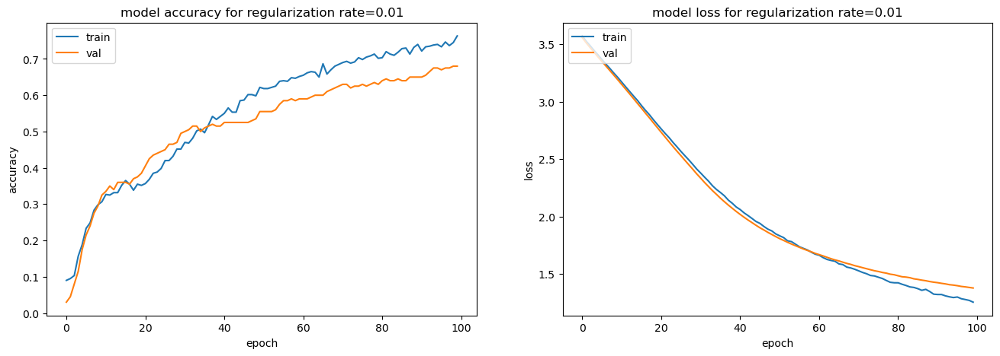

<Figure size 1600x500 with 0 Axes>

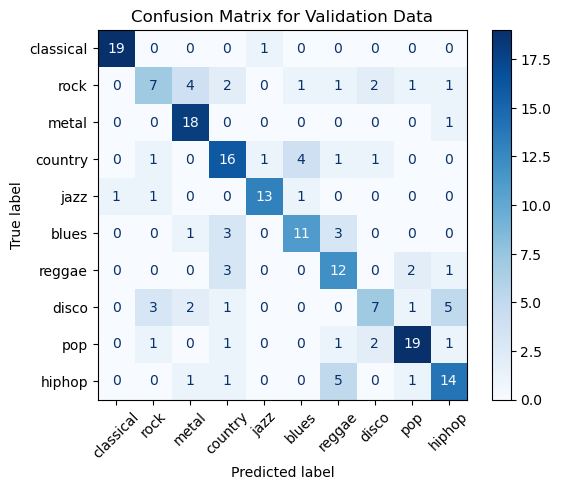

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.54      0.37      0.44        19
       metal       0.69      0.95      0.80        19
     country       0.59      0.67      0.63        24
        jazz       0.87      0.81      0.84        16
       blues       0.65      0.61      0.63        18
      reggae       0.52      0.67      0.59        18
       disco       0.58      0.37      0.45        19
         pop       0.79      0.76      0.78        25
      hiphop       0.61      0.64      0.62        22

    accuracy                           0.68       200
   macro avg       0.68      0.68      0.67       200
weighted avg       0.68      0.68      0.67       200

Best validation accuracy for regularization rate=0.1:  0.4050000011920929
7/7 [==============================] - 0s 1ms/step


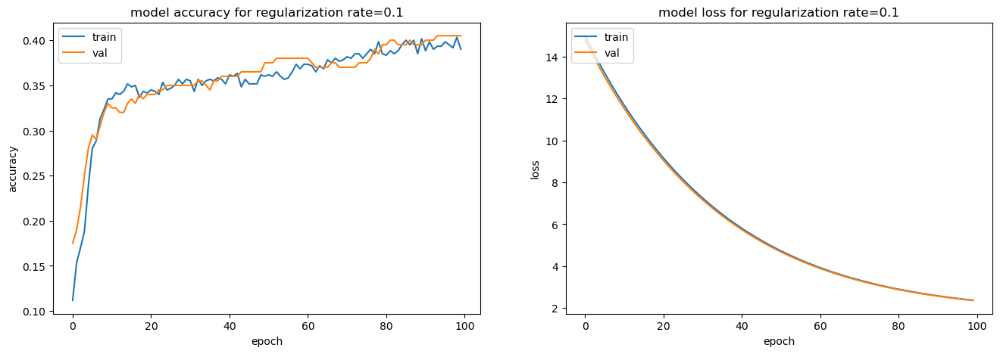

<Figure size 1600x500 with 0 Axes>

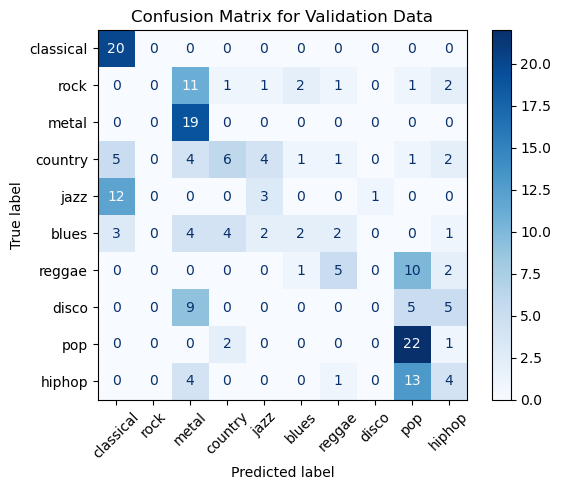

              precision    recall  f1-score   support

   classical       0.50      1.00      0.67        20
        rock       0.00      0.00      0.00        19
       metal       0.37      1.00      0.54        19
     country       0.46      0.25      0.32        24
        jazz       0.30      0.19      0.23        16
       blues       0.33      0.11      0.17        18
      reggae       0.50      0.28      0.36        18
       disco       0.00      0.00      0.00        19
         pop       0.42      0.88      0.57        25
      hiphop       0.24      0.18      0.21        22

    accuracy                           0.41       200
   macro avg       0.31      0.39      0.31       200
weighted avg       0.32      0.41      0.32       200

Regularization Rate: 1e-05, Validation Accuracy: 0.7200000286102295
Regularization Rate: 0.0001, Validation Accuracy: 0.7200000286102295
Regularization Rate: 0.001, Validation Accuracy: 0.6899999976158142
Regularization Rate: 0.01, Validatio

/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

In [276]:
lstm_dropout_rate = 0.1

# Define the list of regularization rates to test
regularization_rates = [0.00001, 0.0001, 0.001, 0.01, 0.1]

# Train models with different regularization rates
results = {}
for rate in regularization_rates:
    model = create_model(lstm_dropout_rate, regularization_rate=rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for regularization rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for regularization rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for regularization rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Regularization Rate: {rate}, Validation Accuracy: {result[1]}')

==> regularization does really contain the overfitting, but it sacrifices accuracy

*tuning by addind dropout layers*

In [277]:
def create_model(lstm_dropout_rate, dropout_rate=0.01):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    backward_layer = keras.layers.LSTM(64, go_backwards=True, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.Dense(32, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

Best validation accuracy for dropout rate=0.1:  0.7200000286102295
7/7 [==============================] - 0s 1ms/step


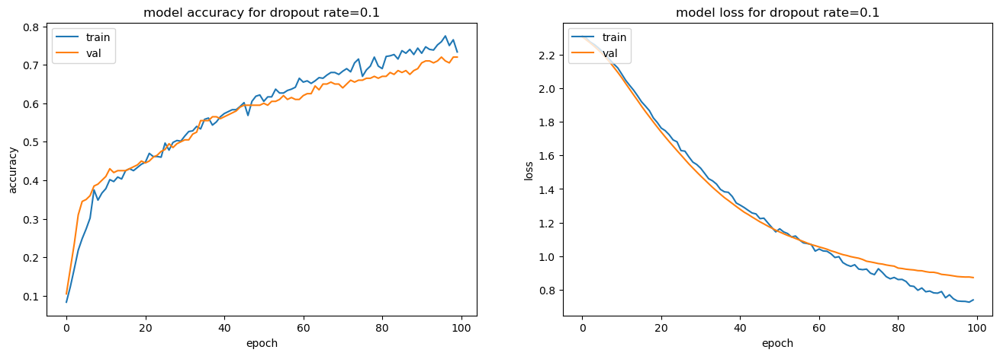

<Figure size 1600x500 with 0 Axes>

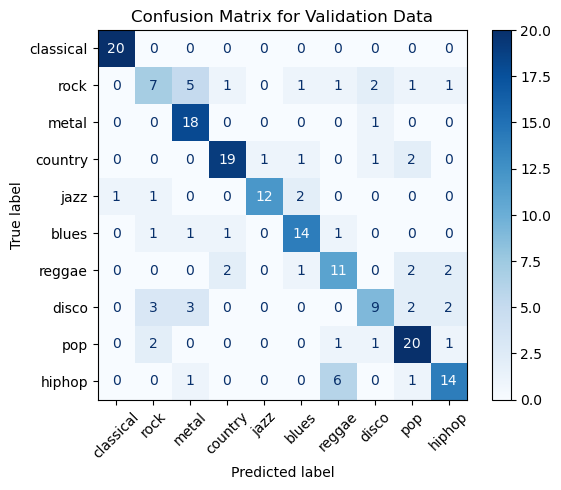

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.50      0.37      0.42        19
       metal       0.64      0.95      0.77        19
     country       0.83      0.79      0.81        24
        jazz       0.92      0.75      0.83        16
       blues       0.74      0.78      0.76        18
      reggae       0.55      0.61      0.58        18
       disco       0.64      0.47      0.55        19
         pop       0.71      0.80      0.75        25
      hiphop       0.70      0.64      0.67        22

    accuracy                           0.72       200
   macro avg       0.72      0.72      0.71       200
weighted avg       0.72      0.72      0.71       200

Best validation accuracy for dropout rate=0.2:  0.7300000190734863
7/7 [==============================] - 0s 1ms/step


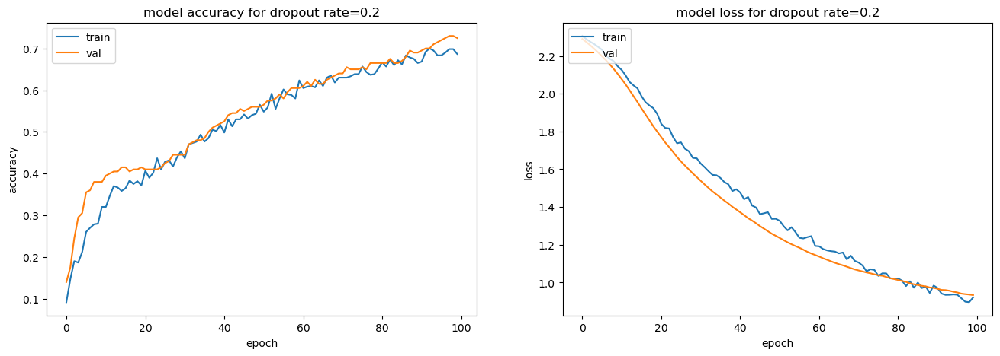

<Figure size 1600x500 with 0 Axes>

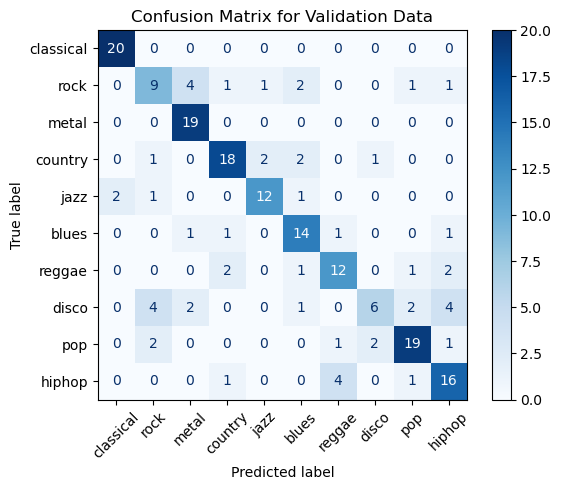

              precision    recall  f1-score   support

   classical       0.91      1.00      0.95        20
        rock       0.53      0.47      0.50        19
       metal       0.73      1.00      0.84        19
     country       0.78      0.75      0.77        24
        jazz       0.80      0.75      0.77        16
       blues       0.67      0.78      0.72        18
      reggae       0.67      0.67      0.67        18
       disco       0.67      0.32      0.43        19
         pop       0.79      0.76      0.78        25
      hiphop       0.64      0.73      0.68        22

    accuracy                           0.73       200
   macro avg       0.72      0.72      0.71       200
weighted avg       0.72      0.72      0.71       200

Best validation accuracy for dropout rate=0.3:  0.6399999856948853
7/7 [==============================] - 0s 1ms/step


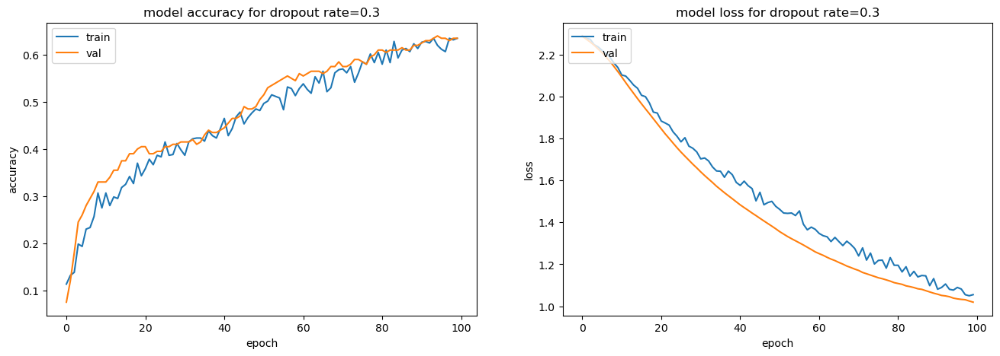

<Figure size 1600x500 with 0 Axes>

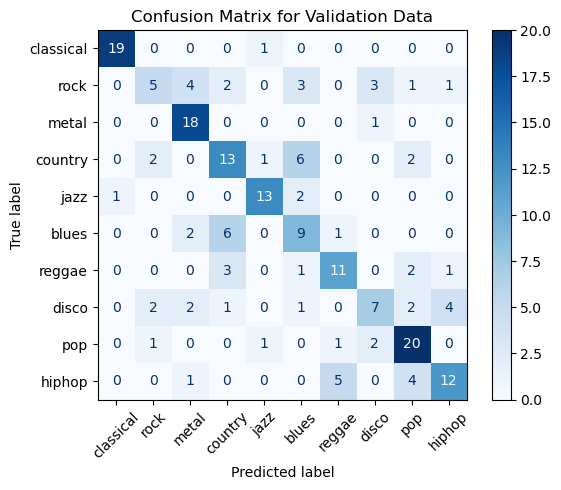

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.50      0.26      0.34        19
       metal       0.67      0.95      0.78        19
     country       0.52      0.54      0.53        24
        jazz       0.81      0.81      0.81        16
       blues       0.41      0.50      0.45        18
      reggae       0.61      0.61      0.61        18
       disco       0.54      0.37      0.44        19
         pop       0.65      0.80      0.71        25
      hiphop       0.67      0.55      0.60        22

    accuracy                           0.64       200
   macro avg       0.63      0.63      0.62       200
weighted avg       0.63      0.64      0.62       200

Best validation accuracy for dropout rate=0.4:  0.625
7/7 [==============================] - 0s 1ms/step


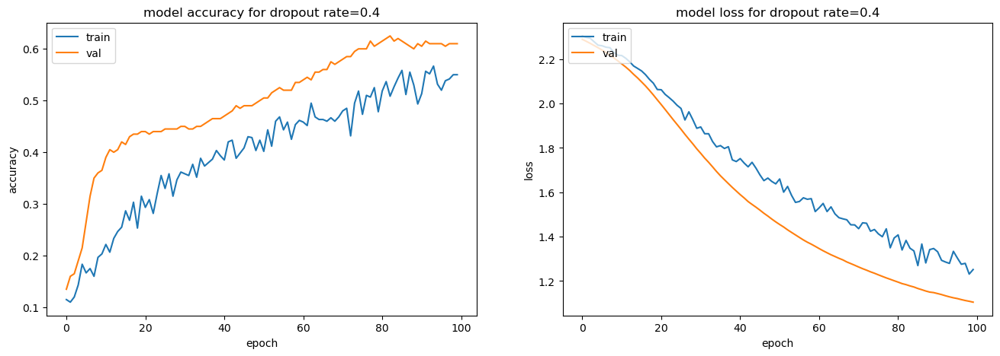

<Figure size 1600x500 with 0 Axes>

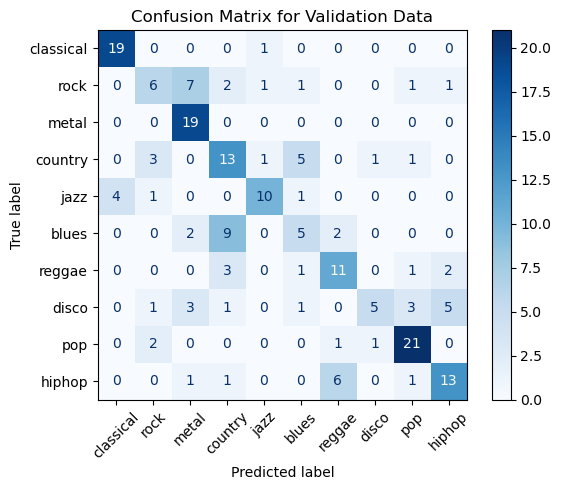

              precision    recall  f1-score   support

   classical       0.83      0.95      0.88        20
        rock       0.46      0.32      0.37        19
       metal       0.59      1.00      0.75        19
     country       0.45      0.54      0.49        24
        jazz       0.77      0.62      0.69        16
       blues       0.36      0.28      0.31        18
      reggae       0.55      0.61      0.58        18
       disco       0.71      0.26      0.38        19
         pop       0.75      0.84      0.79        25
      hiphop       0.62      0.59      0.60        22

    accuracy                           0.61       200
   macro avg       0.61      0.60      0.59       200
weighted avg       0.61      0.61      0.59       200

Best validation accuracy for dropout rate=0.5:  0.5350000262260437
7/7 [==============================] - 0s 1ms/step


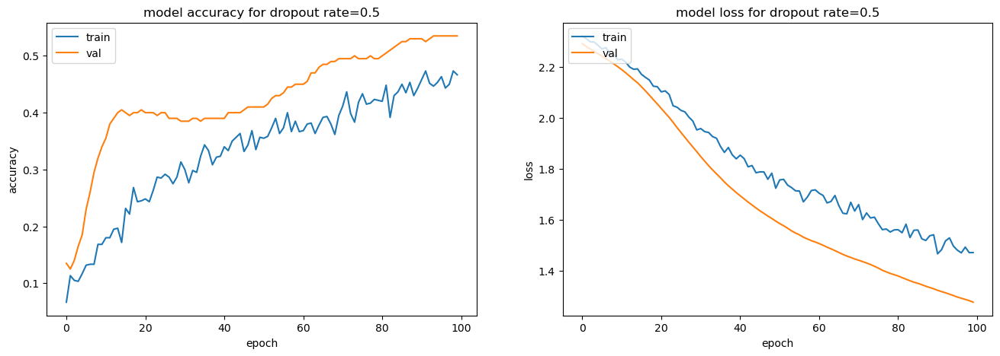

<Figure size 1600x500 with 0 Axes>

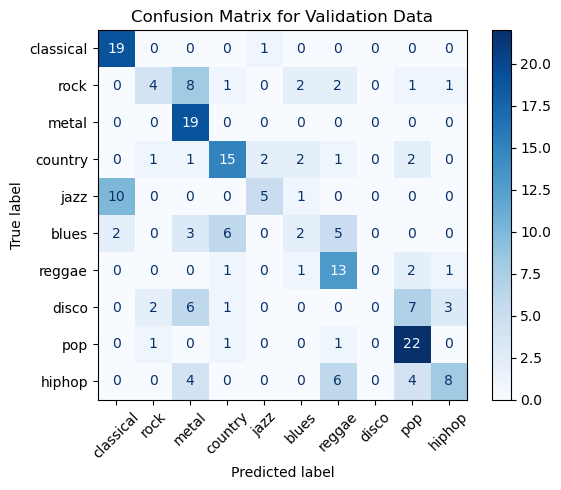

/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(r

              precision    recall  f1-score   support

   classical       0.61      0.95      0.75        20
        rock       0.50      0.21      0.30        19
       metal       0.46      1.00      0.63        19
     country       0.60      0.62      0.61        24
        jazz       0.62      0.31      0.42        16
       blues       0.25      0.11      0.15        18
      reggae       0.46      0.72      0.57        18
       disco       0.00      0.00      0.00        19
         pop       0.58      0.88      0.70        25
      hiphop       0.62      0.36      0.46        22

    accuracy                           0.54       200
   macro avg       0.47      0.52      0.46       200
weighted avg       0.48      0.54      0.47       200

Best validation accuracy for dropout rate=0.6:  0.5450000166893005
7/7 [==============================] - 0s 1ms/step


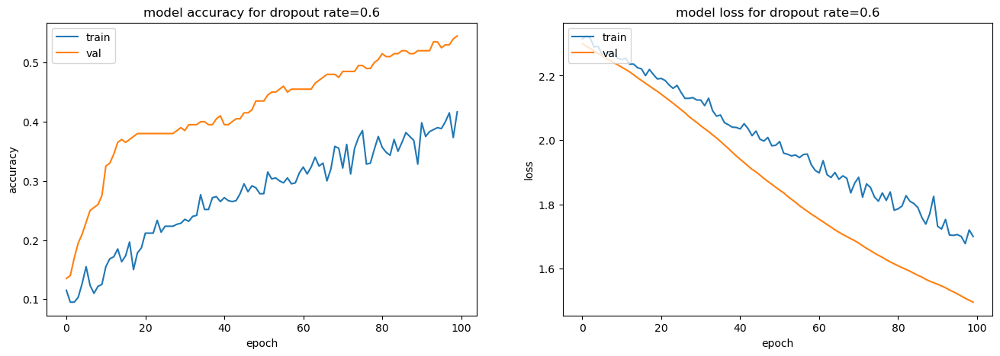

<Figure size 1600x500 with 0 Axes>

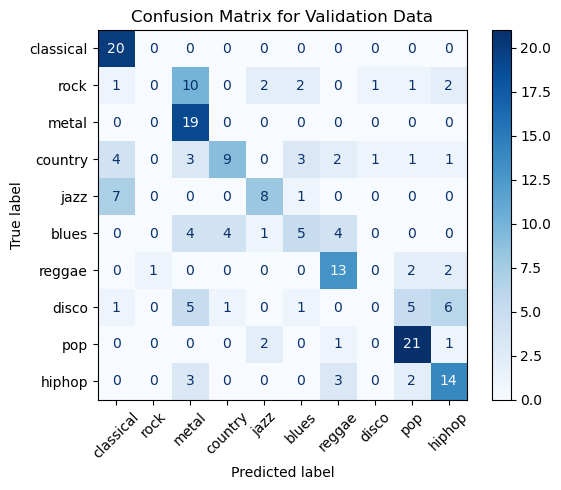

              precision    recall  f1-score   support

   classical       0.61      1.00      0.75        20
        rock       0.00      0.00      0.00        19
       metal       0.43      1.00      0.60        19
     country       0.64      0.38      0.47        24
        jazz       0.62      0.50      0.55        16
       blues       0.42      0.28      0.33        18
      reggae       0.57      0.72      0.63        18
       disco       0.00      0.00      0.00        19
         pop       0.66      0.84      0.74        25
      hiphop       0.54      0.64      0.58        22

    accuracy                           0.55       200
   macro avg       0.45      0.54      0.47       200
weighted avg       0.46      0.55      0.48       200

Dropout Rate: 0.1, Validation Accuracy: 0.7200000286102295
Dropout Rate: 0.2, Validation Accuracy: 0.7250000238418579
Dropout Rate: 0.3, Validation Accuracy: 0.6349999904632568
Dropout Rate: 0.4, Validation Accuracy: 0.6100000143051147
Dropo

In [281]:
lstm_dropout_rate = 0.1

# Define the list of dropout rates to test
dropout_rates =  [0.1, 0.2, 0.3, 0.4, 0.5, 0.6]

results = {}
for rate in dropout_rates:
    model = create_model(lstm_dropout_rate, dropout_rate=rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Dropout Rate: {rate}, Validation Accuracy: {result[1]}')


==> it is really hard to achieve a better performance with this model
; let's try to lighten it

In [282]:
def create_model(lstm_dropout_rate, dropout_rate=0.01):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    backward_layer = keras.layers.LSTM(64, go_backwards=True, dropout=lstm_dropout_rate, recurrent_dropout=lstm_dropout_rate)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dropout(dropout_rate))
    model.add(keras.layers.Dense(32, activation='relu'))
    #model.add(keras.layers.Dropout(dropout_rate))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

Best validation accuracy for dropout rate=0.1:  0.7300000190734863
7/7 [==============================] - 0s 1ms/step


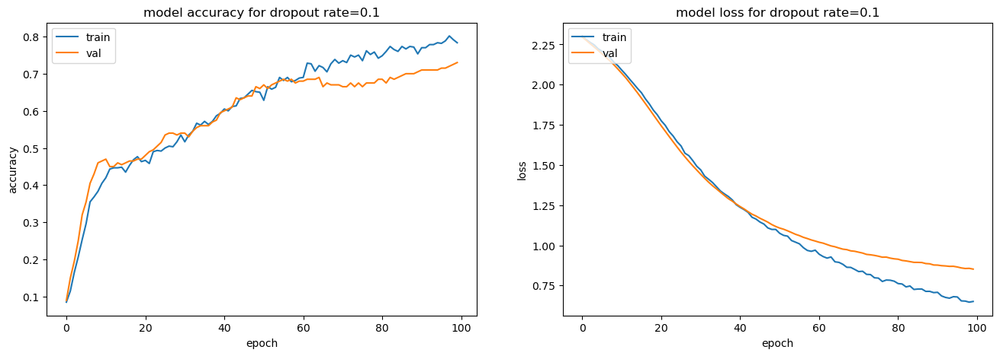

<Figure size 1600x500 with 0 Axes>

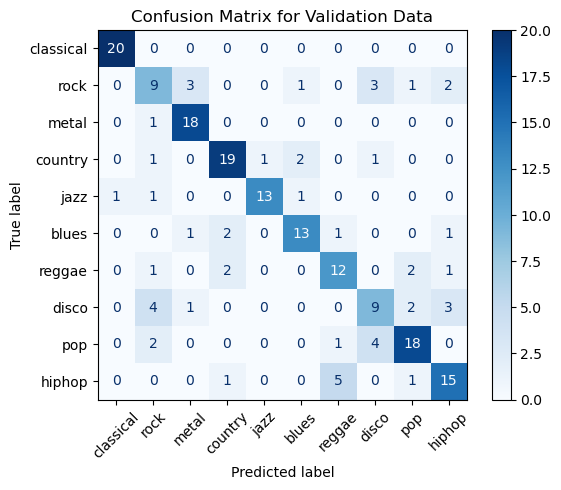

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.47      0.47      0.47        19
       metal       0.78      0.95      0.86        19
     country       0.79      0.79      0.79        24
        jazz       0.93      0.81      0.87        16
       blues       0.76      0.72      0.74        18
      reggae       0.63      0.67      0.65        18
       disco       0.53      0.47      0.50        19
         pop       0.75      0.72      0.73        25
      hiphop       0.68      0.68      0.68        22

    accuracy                           0.73       200
   macro avg       0.73      0.73      0.73       200
weighted avg       0.73      0.73      0.73       200

Best validation accuracy for dropout rate=0.2:  0.6899999976158142
7/7 [==============================] - 0s 1ms/step


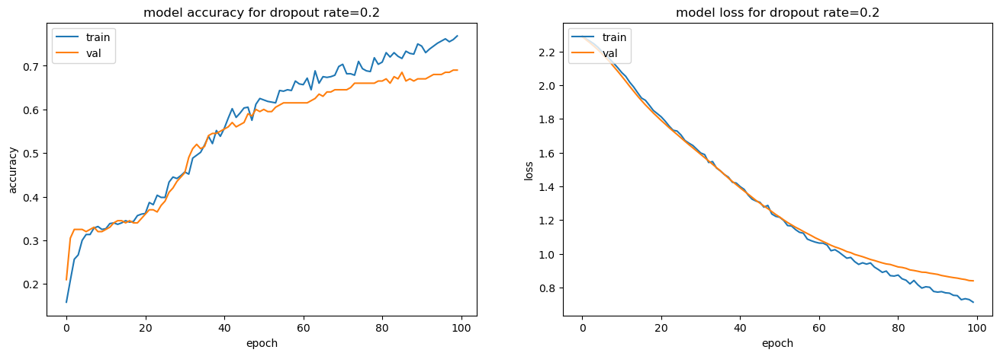

<Figure size 1600x500 with 0 Axes>

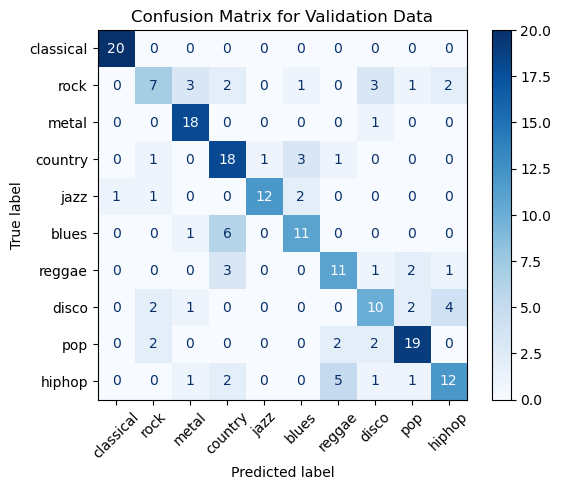

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.54      0.37      0.44        19
       metal       0.75      0.95      0.84        19
     country       0.58      0.75      0.65        24
        jazz       0.92      0.75      0.83        16
       blues       0.65      0.61      0.63        18
      reggae       0.58      0.61      0.59        18
       disco       0.56      0.53      0.54        19
         pop       0.76      0.76      0.76        25
      hiphop       0.63      0.55      0.59        22

    accuracy                           0.69       200
   macro avg       0.69      0.69      0.68       200
weighted avg       0.69      0.69      0.68       200

Best validation accuracy for dropout rate=0.3:  0.6800000071525574
7/7 [==============================] - 0s 1ms/step


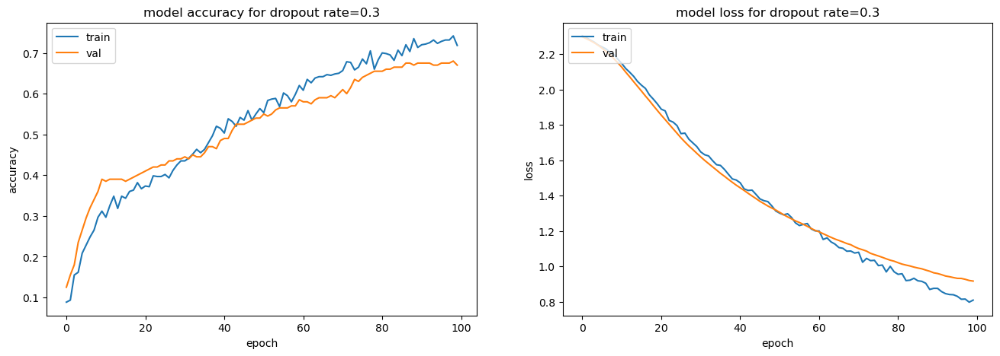

<Figure size 1600x500 with 0 Axes>

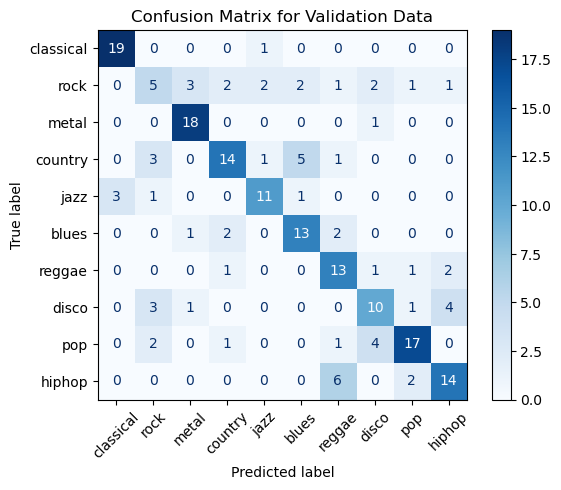

              precision    recall  f1-score   support

   classical       0.86      0.95      0.90        20
        rock       0.36      0.26      0.30        19
       metal       0.78      0.95      0.86        19
     country       0.70      0.58      0.64        24
        jazz       0.73      0.69      0.71        16
       blues       0.62      0.72      0.67        18
      reggae       0.54      0.72      0.62        18
       disco       0.56      0.53      0.54        19
         pop       0.77      0.68      0.72        25
      hiphop       0.67      0.64      0.65        22

    accuracy                           0.67       200
   macro avg       0.66      0.67      0.66       200
weighted avg       0.66      0.67      0.66       200

Best validation accuracy for dropout rate=0.4:  0.675000011920929
7/7 [==============================] - 0s 1ms/step


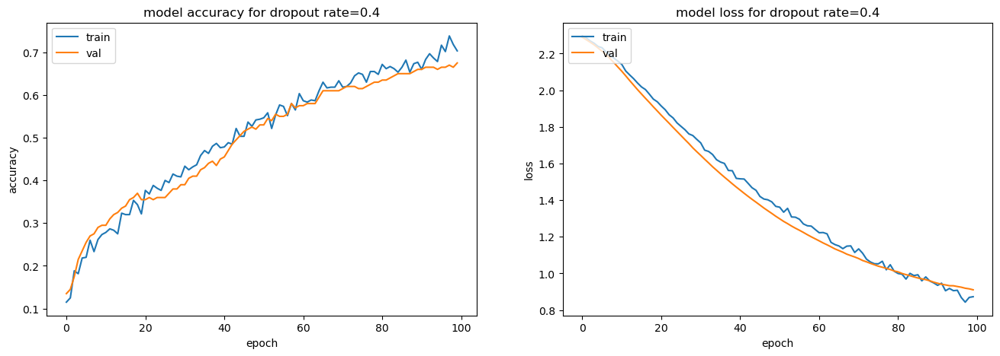

<Figure size 1600x500 with 0 Axes>

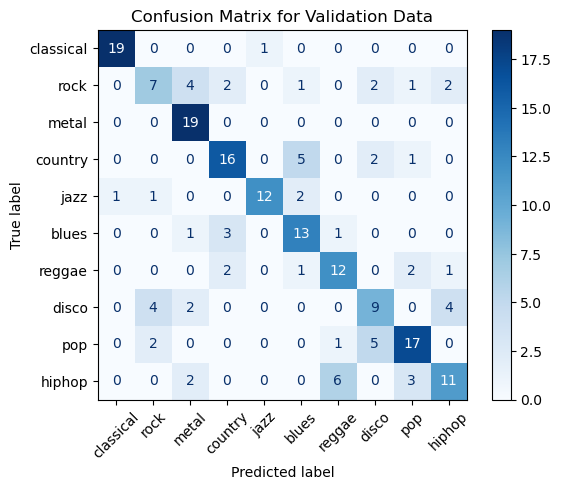

              precision    recall  f1-score   support

   classical       0.95      0.95      0.95        20
        rock       0.50      0.37      0.42        19
       metal       0.68      1.00      0.81        19
     country       0.70      0.67      0.68        24
        jazz       0.92      0.75      0.83        16
       blues       0.59      0.72      0.65        18
      reggae       0.60      0.67      0.63        18
       disco       0.50      0.47      0.49        19
         pop       0.71      0.68      0.69        25
      hiphop       0.61      0.50      0.55        22

    accuracy                           0.68       200
   macro avg       0.68      0.68      0.67       200
weighted avg       0.67      0.68      0.67       200

Best validation accuracy for dropout rate=0.5:  0.6650000214576721
7/7 [==============================] - 0s 1ms/step


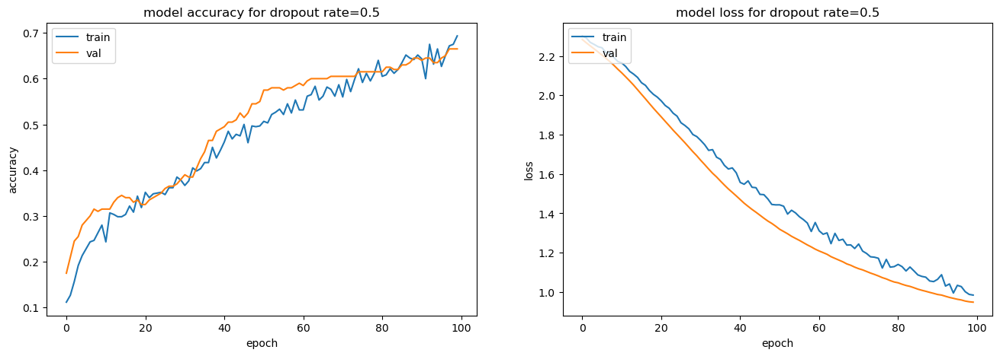

<Figure size 1600x500 with 0 Axes>

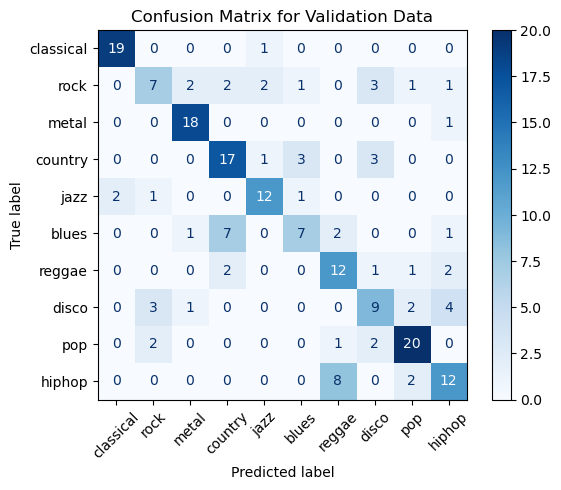

              precision    recall  f1-score   support

   classical       0.90      0.95      0.93        20
        rock       0.54      0.37      0.44        19
       metal       0.82      0.95      0.88        19
     country       0.61      0.71      0.65        24
        jazz       0.75      0.75      0.75        16
       blues       0.58      0.39      0.47        18
      reggae       0.52      0.67      0.59        18
       disco       0.50      0.47      0.49        19
         pop       0.77      0.80      0.78        25
      hiphop       0.57      0.55      0.56        22

    accuracy                           0.67       200
   macro avg       0.66      0.66      0.65       200
weighted avg       0.66      0.67      0.66       200

Best validation accuracy for dropout rate=0.6:  0.6299999952316284
7/7 [==============================] - 0s 1ms/step


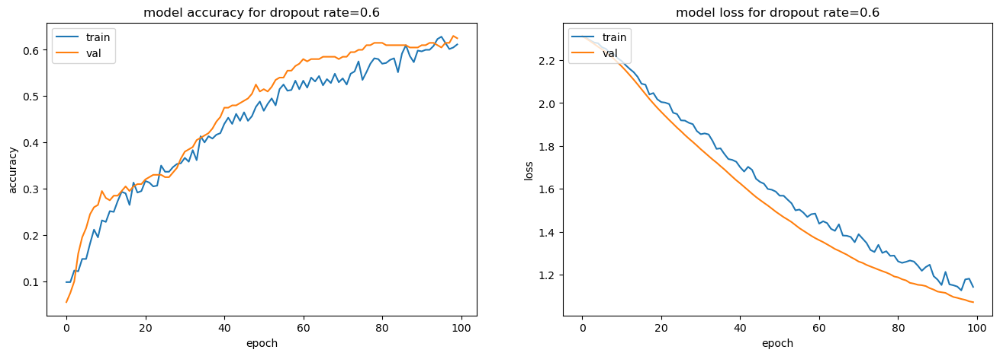

<Figure size 1600x500 with 0 Axes>

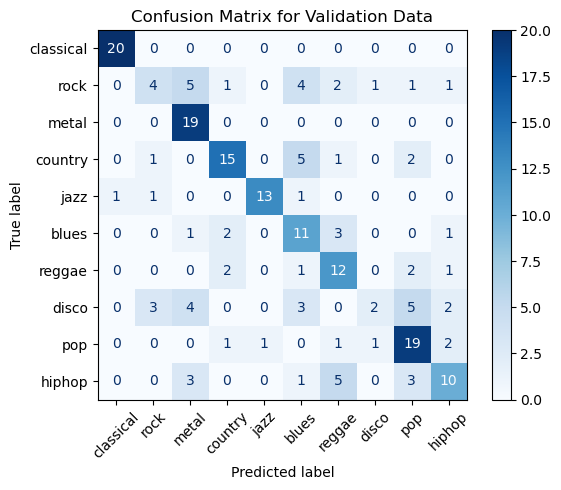

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.44      0.21      0.29        19
       metal       0.59      1.00      0.75        19
     country       0.71      0.62      0.67        24
        jazz       0.93      0.81      0.87        16
       blues       0.42      0.61      0.50        18
      reggae       0.50      0.67      0.57        18
       disco       0.50      0.11      0.17        19
         pop       0.59      0.76      0.67        25
      hiphop       0.59      0.45      0.51        22

    accuracy                           0.62       200
   macro avg       0.62      0.62      0.60       200
weighted avg       0.62      0.62      0.60       200

Dropout Rate: 0.1, Validation Accuracy: 0.7300000190734863
Dropout Rate: 0.2, Validation Accuracy: 0.6899999976158142
Dropout Rate: 0.3, Validation Accuracy: 0.6700000166893005
Dropout Rate: 0.4, Validation Accuracy: 0.675000011920929
Dropou

In [284]:
lstm_dropout_rate = 0.1

# Define the list of dropout rates to test
dropout_rates =  [0.1, 0.2, 0.3, 0.4, 0.5, 0.6]

results = {}
for rate in dropout_rates:
    model = create_model(lstm_dropout_rate, dropout_rate=rate)
    history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                        batch_size=32, epochs=100, verbose=0)

    best_acc = np.max(history.history['val_accuracy'])
    print(f'Best validation accuracy for dropout rate={rate}: ', best_acc)
    
    results[rate] = model.evaluate(X_val_reshaped, y_val)

    # Plotting accuracy and loss

    plt.figure(figsize=(16,5))
    plt.subplot(1,2,1)
    # summarize history for accuracy
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'model accuracy for dropout rate={rate}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1,2,2)
    # summarize history for loss
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'model loss for dropout rate={rate}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')

    preds = np.argmax(model.predict(X_val_reshaped), axis=1)
    
    
    plt.figure(figsize=(16, 5))
    cm = confusion_matrix(y_val, preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
    disp.plot(cmap='Blues');
    plt.title('Confusion Matrix for Validation Data')
    plt.xticks(rotation=45)
    plt.show()
    
    print(classification_report(y_val, preds, target_names = genres))


# Print results
for rate, result in results.items():
    print(f'Dropout Rate: {rate}, Validation Accuracy: {result[1]}')


==> it is possible to observe that with this model it possible to have higher performances, however,  compared to its baseline version, it seems to be slightly outperformed!

***final RNN-2 model***

In [290]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_train)
X_val_scaled = scaler.transform(df_val)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_val_reshaped = X_val_scaled.reshape(X_val_scaled.shape[0], 1, X_val_scaled.shape[1])


In [291]:
def create_model():
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64)
    backward_layer = keras.layers.LSTM(64, go_backwards=True)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dense(32, activation='relu'))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model 

/home/zaib/anaconda3/envs/capstone/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Best validation accuracy:  0.7149999737739563
7/7 [==============================] - 0s 1ms/step


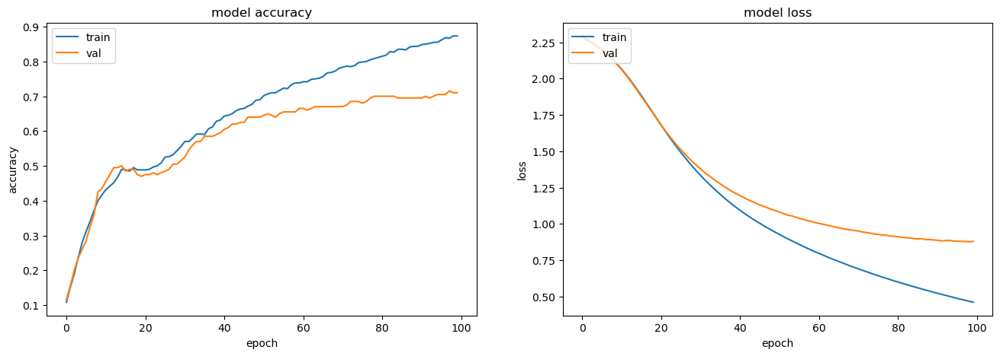

<Figure size 1600x500 with 0 Axes>

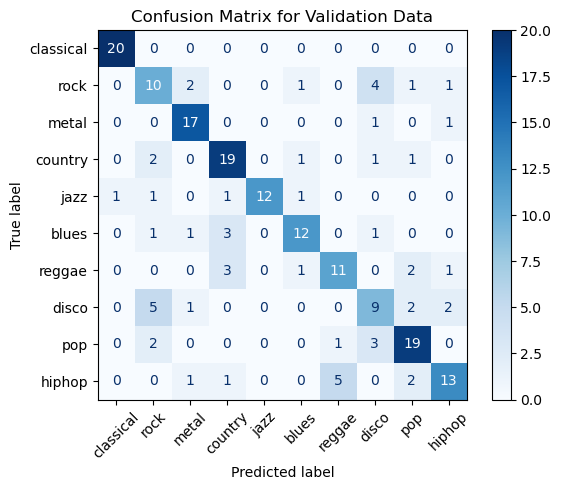

              precision    recall  f1-score   support

   classical       0.95      1.00      0.98        20
        rock       0.48      0.53      0.50        19
       metal       0.77      0.89      0.83        19
     country       0.70      0.79      0.75        24
        jazz       1.00      0.75      0.86        16
       blues       0.75      0.67      0.71        18
      reggae       0.65      0.61      0.63        18
       disco       0.47      0.47      0.47        19
         pop       0.70      0.76      0.73        25
      hiphop       0.72      0.59      0.65        22

    accuracy                           0.71       200
   macro avg       0.72      0.71      0.71       200
weighted avg       0.72      0.71      0.71       200



In [296]:
checkpoint = keras.callbacks.ModelCheckpoint(
    'rnn_model_2_{epoch:02d}_{val_accuracy:.3f}.h5',
    save_best_only=True,
    monitor='val_accuracy',
    mode='max'
)



model = create_model()
history = model.fit(X_train_reshaped, y_train, validation_data=(X_val_reshaped, y_val), 
                    batch_size=32, epochs=100, callbacks=[checkpoint], verbose=0)

best_acc = np.max(history.history['val_accuracy'])
print(f'Best validation accuracy: ', best_acc)

# Plotting accuracy and loss

plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')


preds = np.argmax(model.predict(X_val_reshaped), axis=1)


plt.figure(figsize=(16, 5))
cm = confusion_matrix(y_val, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_val, preds, target_names = genres))


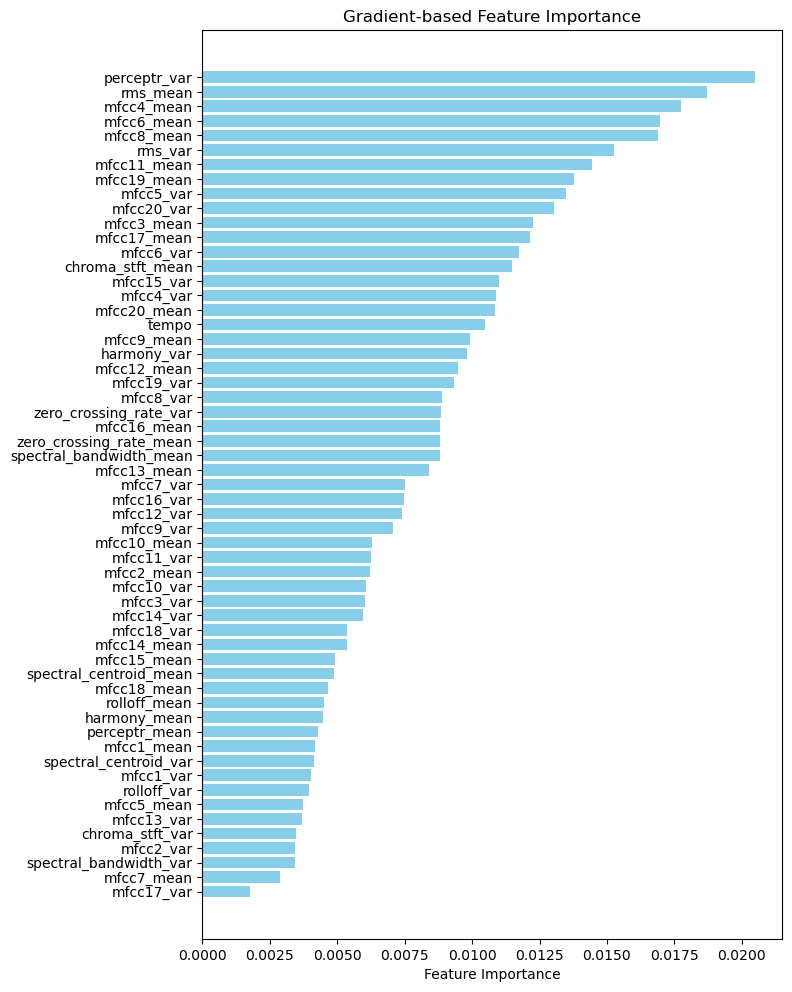

In [297]:
importance = feature_importance_gradient(model, X_val_reshaped)

importance = importance.flatten()

# Sort the indices by importance
sorted_indices = np.argsort(importance)
sorted_importance = importance[sorted_indices]
sorted_feature_names = [features[i] for i in sorted_indices]

# Plotting the feature importance
plt.figure(figsize=(8, 10)) 
plt.barh(range(len(sorted_importance)), sorted_importance, tick_label=sorted_feature_names, height=0.8, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Gradient-based Feature Importance')

plt.tight_layout(pad=1.0) 

plt.show()

**Conclusion :** *Comparing the performance of the models, the MLP (Multi-Layer Perceptron) and RNN 2 have similar accuracies of 73%. RNN 1 lags slightly behind with an accuracy of 70%. However, considering precision, recall, and F1-scores, RNN 2 appears slightly better than MLP in terms of the overall performance. Therefore, RNN 2 is the better choice as the best-performing model overall between these options.*

**FINAL TRAINING**

In [21]:
del df_full_train['label']

In [22]:
scaler = skp.StandardScaler()
X_train_scaled = scaler.fit_transform(df_full_train)
X_test_scaled = scaler.transform(df_test)

# Reshape the data for RNN input 
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_test_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])


*...saving the scaler*

In [24]:
dump(scaler, 'scaler.joblib')

['scaler.joblib']

In [322]:
def create_model(dropout_rate=0.1):
    
    model = keras.models.Sequential()
    model.add(keras.Input(shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
    
    forward_layer = keras.layers.LSTM(64, dropout=dropout_rate, recurrent_dropout=dropout_rate)
    backward_layer = keras.layers.LSTM(64, go_backwards=True, dropout=dropout_rate, recurrent_dropout=dropout_rate)
    model.add(keras.layers.Bidirectional(forward_layer, backward_layer=backward_layer))
    model.add(keras.layers.Dropout(0.3))
    
    
    model.add(keras.layers.Dense(64, activation='relu'))
    model.add(keras.layers.Dense(32, activation='relu'))
              
    model.add(keras.layers.Dense(10, activation='softmax'))  
    
    adamopt = keras.optimizers.Adam(learning_rate=0.0001)
    model.compile(optimizer=adamopt, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

In [ ]:
checkpoint = keras.callbacks.ModelCheckpoint(
    'mugen_model_v1_{epoch:02d}_{val_accuracy:.3f}.h5',
    save_best_only=True,
    monitor='val_accuracy',
    mode='max'
)


dropout_rate=0.1


model = create_model(dropout_rate=dropout_rate)
history = model.fit(X_train_reshaped, y_full_train, validation_data=(X_test_reshaped, y_test), 
                    batch_size=32, epochs=250, callbacks=[checkpoint])

model_acc = model.evaluate(X_test_reshaped, y_test)
print('Overall model accuracy: ', model_acc[1])

best_acc = np.max(history.history['val_accuracy'])
print(f'Best validation accuracy: ', best_acc)

# Plotting accuracy and loss

plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')

plt.subplot(1,2,2)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')


preds = np.argmax(model.predict(X_test_reshaped), axis=1)


plt.figure(figsize=(16, 5))
cm = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=genres);
disp.plot(cmap='Blues');
plt.title('Confusion Matrix for Validation Data')
plt.xticks(rotation=45)
plt.show()

print(classification_report(y_test, preds, target_names = genres))


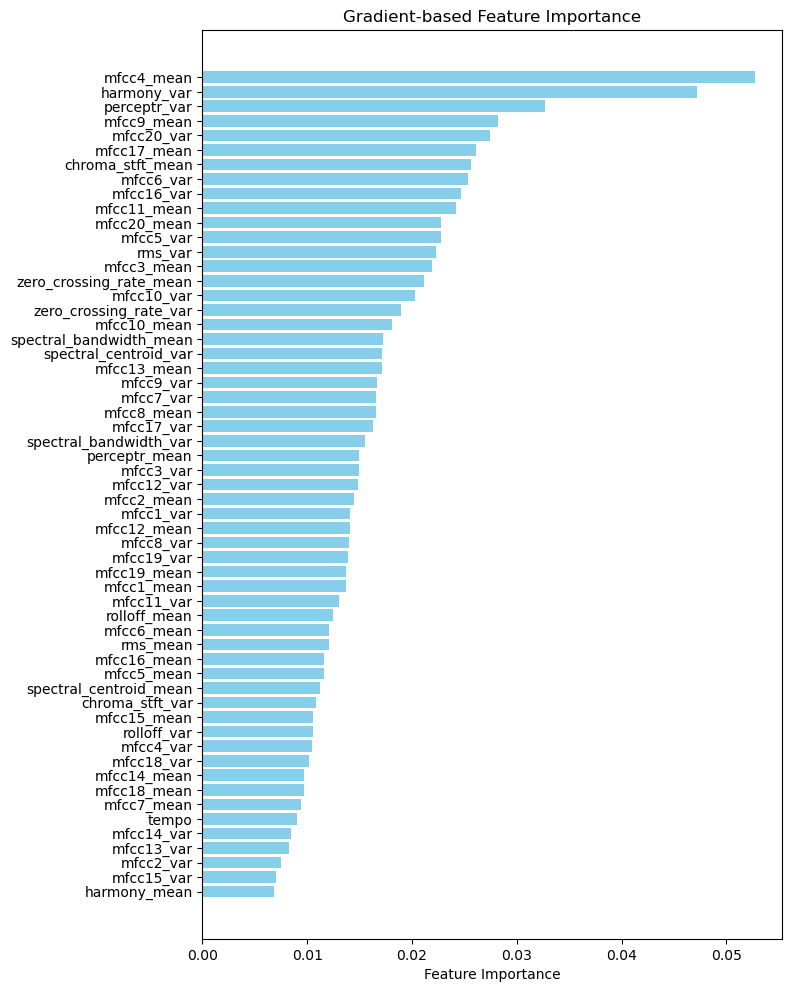

In [324]:
importance = feature_importance_gradient(model, X_test_reshaped)

importance = importance.flatten()

# Sort the indices by importance
sorted_indices = np.argsort(importance)
sorted_importance = importance[sorted_indices]
sorted_feature_names = [features[i] for i in sorted_indices]

# Plotting the feature importance
plt.figure(figsize=(8, 10)) 
plt.barh(range(len(sorted_importance)), sorted_importance, tick_label=sorted_feature_names, height=0.8, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Gradient-based Feature Importance')

plt.tight_layout(pad=1.0) 

plt.show()

==> **NB :** ***The final model was tuned again in such a way to ensure a decreasing validation loss***